# EJERCICIO MÓDULO 3:

Uso de Pandas y Seaborn + algún gráfico de Plotly.

Dataset: diamonds.

IMPORTANTE: cargar el dataset desde CSV desde la carpeta Data porque tendrá nulos introducidos manualmente.

* PARTE 1: 25 % carga y limpieza
    * Carga con Pandas: pd.read_csv

    * Limpieza de valores error: 
        * hay columnas que tienen un valor '?', por tanto se deben reemplazar por un valor nan.

    * Cambio de tipo de dato: .astype() a numéricos y textos, por ejemplo a categorical y carat a float32 o float16

    * Limpieza de nulos (limpiar valores NaN):
        * Nulos en columnas continuas: mediana, media
        * Nulos en columnas categóricas: moda, un valor fijo

    * Encoding: texto a numérico
        * Uso de la función get_dummies() para encoding one_hot
        * Uso de map para encoding ordinal para la columna cut como una nueva columna cut_int: 1, 2, 3, 4

* PARTE 2: 25 % transformaciones:
    * Crear una columna price_iva a partir de la columna price que muestre el precio + IVA (21%). 
        * Ejemplo df['price'] * 1.21 

    * Crear una columna price_discount usando apply a partir de la columna price(con lambda o def):
        * price < 1000 and cut == 'Ideal' entonces 10 % descuento
        * 1000 <= price <= 5000 and cut == 'Premium' entonces 15 % descuento
        * si no entra en las condiciones sin descuento, devolver el precio original

    * Crear una nueva columna volumen combinando: x * y * z

    * Ordenar por dos columnas con sort_values():
        * tipo de corte (cut) y precio (price)

    * Agrupaciones con groupby y visualizarla
        * Agrupar por las 3 que hay de tipo categórico calculando la media, max, min por ejemplo de alguna de las numéricas: price, carat, depth

* PARTE 3: 20 % distribuciones: 

* Outliers: Visualización Q1 y Q3 y calcular límites tukey y filtrar. Sobre la columna precio.

* asimetría, curtosis y transformar datos con logaritmo o raíz cuadrada, aplicar sobre precio, visualizar el histograma y/o boxplot por tipo de corte. Opcional ajustar la escala.

* Discretizar la columna precio por barato, medio, caro usando la función pd.cut


* PARTE 4: 30 % visualizaciones:

* Seaborn EDAS:
    * univariantes:
        * histogramas y curvas de densidad
        * boxplot
        * countplot
    * bivariantes y multivariantes
        * scatterplot con hue, con size, con style
        * Calcular correlación con Pandas y mostrarla con seaborn
        * Hacer la correlación en un gráfico de barras para la columna 'price'
        * Crear una pivot table usando como index y columns algunas variables categóricas y como values usar el price y visualizarla con heatmap de seaborn
    * Combinarlas con:
        * hue, style, size, row, col usando un relplot
        * filtro


# EJERCICIO MÓDULO 3:

Uso de Pandas y Seaborn + algún gráfico de Plotly.

Dataset: diamonds.

IMPORTANTE: cargar el dataset desde CSV desde la carpeta Data porque tendrá nulos introducidos manualmente.

# Columnas Numéricas del Dataset: 
    *Entendimiento de negocio

## **carat:
Representa el peso del diamante en quilates.
Unidades: Quilates (1 quilate = 0.2 gramos).
Impacto: El peso tiene un impacto significativo en el precio del diamante. Diamantes más grandes (mayor quilate) son más valiosos, pero el precio no crece linealmente.

Pasar de quilates a gramos: 1 quilate = 0.2 gramos

## **depth:
Descripción: Proporción de profundidad del diamante.
Se calcula como:
depth = (z / (x + y)/2) × 100     

Es un porcentaje que describe cuán profundo es el diamante en relación con su ancho promedio.

## **table: TO DO
Representa el ancho de la parte superior del diamante (la "tabla") como porcentaje del ancho promedio del diamante. Unidades: Porcentaje.
Impacto: Una tabla ideal se encuentra entre 53%-57% para maximizar la reflexión de la luz.



## **price:
Precio del diamante en dólares estadounidenses (USD). Impacto: Determinado por una combinación de peso (carat), calidad del corte (cut), color y claridad (clarity).
TO DO combinar estos 3 parámetros y ver como cambia el precio

## **x, y, z:
Dimensiones físicas del diamante en milímetros:
x: Longitud.
y: Ancho.
z: Profundidad.

# Columnas Categóricas
## cut:
La calidad del corte del diamante:
Categorías:
-Fair (Pobre),
-Good (Bueno),
-Very Good (Muy Bueno),
-Premium (Premium),
-Ideal (Ideal).

Impacto: La calidad del corte determina lo bien que el diamante refleja la luz. Ideal es el mejor corte, maximizando el brillo, mientras que Fair refleja menos luz.

## color:
El color del diamante, clasificado desde D (mejor, incoloro) hasta J (peor, amarillo tenue).
Categorías:
D (Mejor, incoloro),
E, F, G, H, I, J (Peor, más amarillo tenue).
Impacto: Los diamantes más incoloros (D-F) son más valiosos. Los colores más bajos (H-J) tienen tonos amarillentos. TO DO VERLOS EN FIGURAS


## clarity:
La claridad del diamante, con valores que describen la cantidad de inclusiones o defectos:
Desde IF (Internamente impecable) hasta I3 (Inclusions 3).
Categorías:
IF (Internamente Impecable),
VVS1, VVS2 (Muy, muy pequeñas inclusiones),
VS1, VS2 (Muy pequeñas inclusiones),
SI1, SI2 (Pequeñas inclusiones),
I1 (Inclusions visibles).
Impacto: La claridad mide las imperfecciones internas y externas. Los grados más altos (IF) son más valiosos.


## Precio por Quilate:

Puedes calcular el precio por quilate como:
python
Copiar código
df['price_per_carat'] = df['price'] / df['carat']

## Profundidad Ideal:
La profundidad ideal para un diamante ronda el 60%-62%.


# Relaciones Clave
## Relación entre Peso y Precio:

El precio aumenta exponencialmente con el peso (carat), especialmente para pesos superiores a 1 quilate. TO DO comprobarlo

## Influencia del Corte, Color y Claridad:

Un corte de alta calidad puede aumentar significativamente el brillo, lo que lo hace más atractivo incluso con colores más bajos (H, I).
Un diamante con buen color (D-F) y claridad (IF, VVS) tiene mayor valor.

## Dimensiones (x, y, z) y Proporciones:

Las proporciones ideales de un diamante maximizan su apariencia visual y reflejan más luz.

# Análisis Clave que se Puede Realizar
## Distribución de Precios:

Identificar los rangos más comunes de precios y analizar los factores que los afectan.

## Comparar Claridad y Color:

¿Cómo se distribuyen los precios para diferentes combinaciones de claridad y color?

## Volumen del Diamante:

Crear una nueva columna para el volumen (x * y * z) y analizar su relación con el precio. TO DO

## Correlaciones:

Calcular las correlaciones entre variables numéricas, como carat, price, y depth. TO DO comprobar que se ha hecho

## Análisis de Valores Atípicos:

Identificar diamantes cuyo precio o dimensiones se desvían significativamente. TO DO dar la fila completa de estos diamantes

# PARTE 1: 
25 % carga y limpieza

    * Entendimiento de los datos ( numpy, pandas, matplotlib, seaborn, plotly)

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
# todos los necesarios para el ejercicio mientras usemos np y sns
import matplotlib.pyplot as plt
from scipy import stats
import pickle as pkl

## 1.1. Carga con Pandas: pd.read_csv
    * Recopilar datasets



In [2]:
df = pd.read_csv('../Data/diamonds.csv')

    * Entender las columnas


In [3]:
print("Primeras 10 filas del dataset:")
df.head(10)

Primeras 10 filas del dataset:


,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.2,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75
5,0.24,Very Good,J,VVS2,62.8,57.0,336,3.94,3.96,2.48
6,0.24,Very Good,I,VVS1,62.3,57.0,336,3.95,3.98,2.47
7,0.26,Very Good,H,SI1,61.9,55.0,337,4.07,4.11,2.53
8,0.22,Fair,E,VS2,65.1,61.0,337,3.87,3.78,2.49
9,0.23,Very Good,H,VS1,59.4,61.0,338,4,4.05,2.39


In [4]:
print("Información inicial del dataset:")
df.info()

Información inicial del dataset:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53940 entries, 0 to 53939
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   carat    53939 non-null  float64
 1   cut      53937 non-null  object 
 2   color    53938 non-null  object 
 3   clarity  53938 non-null  object 
 4   depth    53940 non-null  float64
 5   table    53938 non-null  float64
 6   price    53938 non-null  object 
 7   x        53938 non-null  object 
 8   y        53939 non-null  float64
 9   z        53939 non-null  float64
dtypes: float64(5), object(5)
memory usage: 4.1+ MB


In [5]:
df.describe()

,carat,depth,table,y,z
count,53939.000000,53940.000000,53938.000000,53939.000000,53939.000000
mean,0.797946,61.749405,57.457145,5.734479,3.538722
std,0.474013,1.432621,2.234521,1.142092,0.705700
min,0.200000,43.000000,43.000000,0.000000,0.000000
25%,0.400000,61.000000,56.000000,4.720000,2.910000
50%,0.700000,61.800000,57.000000,5.710000,3.530000
75%,1.040000,62.500000,59.000000,6.540000,4.040000
max,5.010000,79.000000,95.000000,58.900000,31.800000


In [6]:
df.shape # 53940 filas y 10 columnas


(53940, 10)

In [7]:
df.keys() # obtenemos los nombres de las columnas

Index(['carat', 'cut', 'color', 'clarity', 'depth', 'table', 'price', 'x', 'y',
       'z'],
      dtype='object')

In [8]:
df.empty # nos dice si el dataframe está vacío

False

In [9]:
df.query # nos permite hacer consultas al dataframe

<bound method DataFrame.query of        carat        cut color clarity  depth  table price     x     y     z
0       0.23      Ideal     E     SI2   61.5   55.0   326  3.95  3.98  2.43
1       0.21    Premium     E     SI1   59.8   61.0   326  3.89  3.84  2.31
2       0.23       Good     E     VS1   56.9   65.0   327  4.05  4.07  2.31
3       0.29    Premium     I     VS2   62.4   58.0   334   4.2  4.23  2.63
4       0.31       Good     J     SI2   63.3   58.0   335  4.34  4.35  2.75
...      ...        ...   ...     ...    ...    ...   ...   ...   ...   ...
53935   0.72      Ideal     D     SI1   60.8   57.0  2757  5.75  5.76  3.50
53936   0.72       Good     D     SI1   63.1   55.0  2757  5.69  5.75  3.61
53937   0.70  Very Good     D     SI1   62.8   60.0  2757  5.66  5.68  3.56
53938   0.86    Premium     H     SI2   61.0   58.0  2757  6.15  6.12  3.74
53939   0.75      Ideal     D     SI2   62.2   55.0  2757  5.83  5.87  3.64

[53940 rows x 10 columns]>

In [10]:
df.values # nos devuelve los valores del dataframe en forma de array de filas

array([[0.23, 'Ideal', 'E', ..., '3.95', 3.98, 2.43],
       [0.21, 'Premium', 'E', ..., '3.89', 3.84, 2.31],
       [0.23, 'Good', 'E', ..., '4.05', 4.07, 2.31],
       ...,
       [0.7, 'Very Good', 'D', ..., '5.66', 5.68, 3.56],
       [0.86, 'Premium', 'H', ..., '6.15', 6.12, 3.74],
       [0.75, 'Ideal', 'D', ..., '5.83', 5.87, 3.64]],
      shape=(53940, 10), dtype=object)

## 1.2. Limpieza de valores error: 
    * limpieza-tratamiento de errores y duplicados


Para trabajar más correctamente con un dataframe, es necesario limpia los datos, es decir, eliminar los valores nulos, duplicados y valores atípicos. Para ello, se pueden utilizar los siguientes métodos:

In [11]:
# Comprobar si hay valores nulos en cada columna (sean '?', 'nan, o no)
print("Número de valores nulos por columna:") 
print(df.isnull().sum()) 

Número de valores nulos por columna:
carat      1
cut        3
color      2
clarity    2
depth      0
table      2
price      2
x          2
y          1
z          1
dtype: int64


### 1.2.1. sabemos que hay columnas que tienen un valor '?', por tanto se deben reemplazar por un valor nan.


In [12]:
# Verificar si hay valores exactamente iguales a '?'
print((df == '?').any().any())


True


In [13]:
#Eliminación de duplicados
#Identificar duplicados
#Identificar filas duplicadas:
print(df.duplicated().sum())  # Número de filas duplicadas
print(df[df.duplicated()])  # Mostrar las filas duplicadas
# 146


146
       carat    cut color clarity  depth  table price     x     y     z
1005    0.79  Ideal     G     SI1   62.3   57.0  2898   5.9  5.85  3.66
1006    0.79  Ideal     G     SI1   62.3   57.0  2898   5.9  5.85  3.66
1007    0.79  Ideal     G     SI1   62.3   57.0  2898   5.9  5.85  3.66
1008    0.79  Ideal     G     SI1   62.3   57.0  2898   5.9  5.85  3.66
2025    1.52   Good     E      I1   57.3   58.0  3105  7.53  7.42  4.28
...      ...    ...   ...     ...    ...    ...   ...   ...   ...   ...
47969   0.52  Ideal     D     VS2   61.8   55.0  1919  5.19  5.16  3.20
49326   0.51  Ideal     F    VVS2   61.2   56.0  2093  5.17  5.19  3.17
49557   0.71   Good     F     SI2   64.1   60.0  2130     0  0.00  0.00
50079   0.51  Ideal     F    VVS2   61.2   56.0  2203  5.19  5.17  3.17
52861   0.50   Fair     E     VS2   79.0   73.0  2579  5.21  5.18  4.09

[146 rows x 10 columns]


In [14]:
#Cuando utilizamos el método drop_duplicates() en pandas, 
# podemos controlar cuál de las filas duplicadas se mantiene
# utilizando el argumento keep. El valor por defecto es 'first', 
# lo que significa que se conservará la primera aparición de cada duplicado, 
# mientras que las demás se eliminarán.

#Sintaxis básica
#df = df.drop_duplicates(keep='first')
#Argumento keep
#keep='first': Conserva la primera aparición de cada fila duplicada (por defecto).
#keep='last': Conserva la última aparición de cada fila duplicada.
#keep=False: Elimina todas las filas duplicadas, no conserva ninguna.

In [15]:
#Eliminar duplicados
#Eliminar filas duplicadas:
df = df.drop_duplicates()

Al calcular el volumen, más adelante, vemos que en las columnas de las dimensiones físicas, (x, y, z) aparecen valores iguales a cero vamos a revisarlos aquí, y poner el valor de la mediana en su lugar aunque lo más correcto sería analizar todos los diamantes con características similares a los que tienen valos nulos y hacer la mediana con ellos

In [16]:
# Primero vemos si hay ceros
for col in ['x', 'y', 'z']:
    print(f"Valores cero restantes en {col}: {(df[col] == 0).sum()}")

'''Valores cero restantes en x: 8
Valores cero restantes en y: 7
Valores cero restantes en z: 20'''

# al quitar los duplicados:
'''Valores cero restantes en x: 0
Valores cero restantes en y: 6
Valores cero restantes en z: 19'''


Valores cero restantes en x: 0
Valores cero restantes en y: 6
Valores cero restantes en z: 19


'Valores cero restantes en x: 0\nValores cero restantes en y: 6\nValores cero restantes en z: 19'

In [17]:
# Función para buscar filas donde hay un texto específico
def busca_filas_que_contengan(df, texto):
    """Busca las filas donde una columna contiene un texto específico y devuelve las filas y sus índices.
    Args:
        df (pd.DataFrame): DataFrame donde se realizará la búsqueda.
        texto (str): Texto a buscar en el DataFrame.
    Returns:
        tuple: DataFrame con las filas que contienen el texto y una lista de sus índices.
    """
    # Identificar las filas que contienen el texto
    rows_with_texto_mark = df.isin([texto]).any(axis=1)  # Serie booleana: True en filas que contienen 'texto'
    # Filtrar las filas que contienen el texto
    df_rows_with_texto_mark = df[rows_with_texto_mark]
    # Obtener los índices de las filas
    indices = df_rows_with_texto_mark.index.tolist()
    
    # Mostrar resultados
    print(f"Filas con valores '{texto}':")
    print(df_rows_with_texto_mark)  # Imprime las filas que contienen el texto
    print('------------------------------------')
    print(f"Índices de las filas con valores '{texto}':")
    print(indices)  # Imprime los índices de las filas que contienen el texto

    return df_rows_with_texto_mark, indices

# Llamar a la función
filas_con_texto, indices = busca_filas_que_contengan(df, '?')
print('----------------------------------------')
filas_con_texto, indices = busca_filas_que_contengan(df, 0)

'''Filas con valores '?':
       carat    cut color clarity  depth  table price     x     y     z
49222   0.56  Ideal     ?    VVS2   61.6   56.0  2081     ?  5.29  3.27
49227   0.50      ?     E    VVS2   61.7   61.0  2083  5.09  5.12  3.15
49229   0.70   Good     H     VS2   63.8   60.0     ?  5.59  5.51  3.54
------------------------------------
Índices de las filas con valores '?':
[49222, 49227, 49229]
Filas con valores '0':
       carat        cut color clarity  depth  table  price     x     y    z
2207    1.00    Premium     G     SI2   59.1   59.0   3142  6.55  6.48  0.0
2314    1.01    Premium     H      I1   58.1   59.0   3167  6.66  6.60  0.0
4791    1.10    Premium     G     SI2   63.0   59.0   3696   6.5  6.47  0.0
5471    1.01    Premium     F     SI2   59.2   58.0   3837   6.5  6.47  0.0
10167   1.50       Good     G      I1   64.0   61.0   4731  7.15  7.04  0.0
11182   1.07      Ideal     F     SI2   61.6   56.0   4954     0  6.62  0.0
11963   1.00  Very Good     H     VS2   63.3   53.0   5139     0  0.00  0.0
13601   1.15      Ideal     G     VS2   59.2   56.0   5564  6.88  6.83  0.0
15951   1.14       Fair     G     VS1   57.5   67.0   6381     0  0.00  0.0
24394   2.18    Premium     H     SI2   59.4   61.0  12631  8.49  8.45  0.0
24520   1.56      Ideal     G     VS2   62.2   54.0  12800     0  0.00  0.0
26123   2.25    Premium     I     SI1   61.3   58.0  15397  8.52  8.42  0.0
26243   1.20    Premium     D    VVS1   62.1   59.0  15686     0  0.00  0.0
27112   2.20    Premium     H     SI1   61.2   59.0  17265  8.42  8.37  0.0
27429   2.25    Premium     H     SI2   62.8   59.0  18034     0  0.00  0.0
27503   2.02    Premium     H     VS2   62.7   53.0  18207  8.02  7.95  0.0
27739   2.80       Good     G     SI2   63.8   58.0  18788   8.9  8.85  0.0
49556   0.71       Good     F     SI2   64.1   60.0   2130     0  0.00  0.0
49557   0.71       Good     F     SI2   64.1   60.0   2130     0  0.00  0.0
51506   1.12    Premium     G      I1   60.4   59.0   2383  6.71  6.67  0.0
------------------------------------
Índices de las filas con valores '0':
[2207, 2314, 4791, 5471, 10167, 11182, 11963, 13601, 15951, 24394, 24520, 26123, 26243, 27112, 27429, 27503, 27739, 49556, 49557, 51506]
'''

# al quitar las filas duplicadas:
'''Filas con valores '?':
       carat    cut color clarity  depth  table price     x     y     z
49222   0.56  Ideal     ?    VVS2   61.6   56.0  2081     ?  5.29  3.27
49227   0.50      ?     E    VVS2   61.7   61.0  2083  5.09  5.12  3.15
49229   0.70   Good     H     VS2   63.8   60.0     ?  5.59  5.51  3.54
------------------------------------
Índices de las filas con valores '?':
[49222, 49227, 49229]
----------------------------------------
Filas con valores '0':
       carat        cut color clarity  depth  table  price     x     y    z
2207    1.00    Premium     G     SI2   59.1   59.0   3142  6.55  6.48  0.0
2314    1.01    Premium     H      I1   58.1   59.0   3167  6.66  6.60  0.0
4791    1.10    Premium     G     SI2   63.0   59.0   3696   6.5  6.47  0.0
5471    1.01    Premium     F     SI2   59.2   58.0   3837   6.5  6.47  0.0
10167   1.50       Good     G      I1   64.0   61.0   4731  7.15  7.04  0.0
11182   1.07      Ideal     F     SI2   61.6   56.0   4954     0  6.62  0.0
11963   1.00  Very Good     H     VS2   63.3   53.0   5139     0  0.00  0.0
13601   1.15      Ideal     G     VS2   59.2   56.0   5564  6.88  6.83  0.0
15951   1.14       Fair     G     VS1   57.5   67.0   6381     0  0.00  0.0
24394   2.18    Premium     H     SI2   59.4   61.0  12631  8.49  8.45  0.0
24520   1.56      Ideal     G     VS2   62.2   54.0  12800     0  0.00  0.0
26123   2.25    Premium     I     SI1   61.3   58.0  15397  8.52  8.42  0.0
26243   1.20    Premium     D    VVS1   62.1   59.0  15686     0  0.00  0.0
27112   2.20    Premium     H     SI1   61.2   59.0  17265  8.42  8.37  0.0
27429   2.25    Premium     H     SI2   62.8   59.0  18034     0  0.00  0.0
27503   2.02    Premium     H     VS2   62.7   53.0  18207  8.02  7.95  0.0
27739   2.80       Good     G     SI2   63.8   58.0  18788   8.9  8.85  0.0
49556   0.71       Good     F     SI2   64.1   60.0   2130     0  0.00  0.0
51506   1.12    Premium     G      I1   60.4   59.0   2383  6.71  6.67  0.0
------------------------------------
Índices de las filas con valores '0':
[2207, 2314, 4791, 5471, 10167, 11182, 11963, 13601, 15951, 24394, 24520, 26123, 26243, 27112, 27429, 27503, 27739, 49556, 51506]'''


Filas con valores '?':
       carat    cut color clarity  depth  table price     x     y     z
49222   0.56  Ideal     ?    VVS2   61.6   56.0  2081     ?  5.29  3.27
49227   0.50      ?     E    VVS2   61.7   61.0  2083  5.09  5.12  3.15
49229   0.70   Good     H     VS2   63.8   60.0     ?  5.59  5.51  3.54
------------------------------------
Índices de las filas con valores '?':
[49222, 49227, 49229]
----------------------------------------
Filas con valores '0':
       carat        cut color clarity  depth  table  price     x     y    z
2207    1.00    Premium     G     SI2   59.1   59.0   3142  6.55  6.48  0.0
2314    1.01    Premium     H      I1   58.1   59.0   3167  6.66  6.60  0.0
4791    1.10    Premium     G     SI2   63.0   59.0   3696   6.5  6.47  0.0
5471    1.01    Premium     F     SI2   59.2   58.0   3837   6.5  6.47  0.0
10167   1.50       Good     G      I1   64.0   61.0   4731  7.15  7.04  0.0
11182   1.07      Ideal     F     SI2   61.6   56.0   4954     0  6.62  

"Filas con valores '?':\n       carat    cut color clarity  depth  table price     x     y     z\n49222   0.56  Ideal     ?    VVS2   61.6   56.0  2081     ?  5.29  3.27\n49227   0.50      ?     E    VVS2   61.7   61.0  2083  5.09  5.12  3.15\n49229   0.70   Good     H     VS2   63.8   60.0     ?  5.59  5.51  3.54\n------------------------------------\nÍndices de las filas con valores '?':\n[49222, 49227, 49229]\n----------------------------------------\nFilas con valores '0':\n       carat        cut color clarity  depth  table  price     x     y    z\n2207    1.00    Premium     G     SI2   59.1   59.0   3142  6.55  6.48  0.0\n2314    1.01    Premium     H      I1   58.1   59.0   3167  6.66  6.60  0.0\n4791    1.10    Premium     G     SI2   63.0   59.0   3696   6.5  6.47  0.0\n5471    1.01    Premium     F     SI2   59.2   58.0   3837   6.5  6.47  0.0\n10167   1.50       Good     G      I1   64.0   61.0   4731  7.15  7.04  0.0\n11182   1.07      Ideal     F     SI2   61.6   56.0   4

Iba a eliminar todas las filas con dimensiones = 0, pero veo que son diamantes muy caros y mejor los dejo

In [18]:
# Reemplazar valores '?' por NaN
df = df.replace('?', np.nan) 


In [19]:
# Comprobar si hay valores nulos en cada columna
print("Número de valores nulos por columna:")
print(df.isnull().sum()) # Devuelve el número de valores nulos por columna

Número de valores nulos por columna:
carat      1
cut        4
color      3
clarity    2
depth      0
table      2
price      3
x          3
y          1
z          1
dtype: int64


Hemos comprobado que aparecen 3 valores nulos en las columnas donde antes había interrogación

In [20]:
# Verificar si hay valores exactamente iguales a '?'
print((df == '?').any().any()) # Devuelve True si hay algún valor igual a '?'


False


con esto ya hemos quitado los interrogantes y los hemos sustituido por nan

## 1.3. Cambio de tipo de dato: .astype() a numéricos y textos, por ejemplo a categorical y carat a float32 o float16


In [21]:
df.info() # información del dataset

<class 'pandas.core.frame.DataFrame'>
Index: 53794 entries, 0 to 53939
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   carat    53793 non-null  float64
 1   cut      53790 non-null  object 
 2   color    53791 non-null  object 
 3   clarity  53792 non-null  object 
 4   depth    53794 non-null  float64
 5   table    53792 non-null  float64
 6   price    53791 non-null  object 
 7   x        53791 non-null  object 
 8   y        53793 non-null  float64
 9   z        53793 non-null  float64
dtypes: float64(5), object(5)
memory usage: 4.5+ MB


In [22]:
# Cambiar el tipo de las columnas object (que no sean el precio) a categorical
df["cut"] = df["cut"].astype("category")
df["color"] = df["color"].astype("category")
df["clarity"] = df["clarity"].astype("category")

# Cambiar a float64 para poder usarlo para calcular el volumen
df["x"] = df["x"].astype("float64") 

df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 53794 entries, 0 to 53939
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype   
---  ------   --------------  -----   
 0   carat    53793 non-null  float64 
 1   cut      53790 non-null  category
 2   color    53791 non-null  category
 3   clarity  53792 non-null  category
 4   depth    53794 non-null  float64 
 5   table    53792 non-null  float64 
 6   price    53791 non-null  object  
 7   x        53791 non-null  float64 
 8   y        53793 non-null  float64 
 9   z        53793 non-null  float64 
dtypes: category(3), float64(6), object(1)
memory usage: 3.4+ MB


ya está cambiado el tipo de la columna cut

#### 1.3.1. cambio de tipo de dato de carat , a float16

In [23]:
df["carat"] = df["carat"].astype("float16") # Cambiar a float16 para reducir el uso de memoria
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 53794 entries, 0 to 53939
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype   
---  ------   --------------  -----   
 0   carat    53793 non-null  float16 
 1   cut      53790 non-null  category
 2   color    53791 non-null  category
 3   clarity  53792 non-null  category
 4   depth    53794 non-null  float64 
 5   table    53792 non-null  float64 
 6   price    53791 non-null  object  
 7   x        53791 non-null  float64 
 8   y        53793 non-null  float64 
 9   z        53793 non-null  float64 
dtypes: category(3), float16(1), float64(5), object(1)
memory usage: 3.1+ MB


Ya hemos pasado el tipo de la columna carat de float64 a float 16 para ahorrar memoria

## 1.4. Limpieza de nulos (limpiar valores NaN):
    * limpieza-tratamiento de nulos


In [24]:
# Comprobar si hay valores nulos en cada columna
print("Número de valores nulos por columna:")
print(df.isnull().sum()) # Devuelve el número de valores nulos por columna

Número de valores nulos por columna:
carat      1
cut        4
color      3
clarity    2
depth      0
table      2
price      3
x          3
y          1
z          1
dtype: int64


Vemos que hay nulos en casi todas las columnas, salvo en depth

In [25]:
# la columna price viene como object, hay que pasarla a número antes de quitar los nulos, porque si no tendríamos que poner la moda
df["price"] = pd.to_numeric(df["price"], errors="coerce")
# Cambiar a int32 para poder hacer gráficas
df["price"] = df["price"].astype("float32") 

df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 53794 entries, 0 to 53939
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype   
---  ------   --------------  -----   
 0   carat    53793 non-null  float16 
 1   cut      53790 non-null  category
 2   color    53791 non-null  category
 3   clarity  53792 non-null  category
 4   depth    53794 non-null  float64 
 5   table    53792 non-null  float64 
 6   price    53791 non-null  float32 
 7   x        53791 non-null  float64 
 8   y        53793 non-null  float64 
 9   z        53793 non-null  float64 
dtypes: category(3), float16(1), float32(1), float64(5)
memory usage: 2.9 MB


In [26]:
def quita_nan(df):
    columnas_no_procesadas = []  # Lista Para registrar columnas que no se pudieron procesar
    print('------------------------------------')
    # Iterar sobre las columnas del DataFrame
    for i in df.columns:        
        print('\n************************************')
        print(f"Procesando columna: {i}")
        print('1....................................')
        # Validar si la columna contiene al menos un valor no nulo
        if df[i].dropna().empty:
            print(f"La columna {i} está completamente vacía. No se puede calcular la asimetría.")
            print('2....................................')
            columnas_no_procesadas.append((i, "Columna completamente vacía"))

        # Si la columna es numérica
        if df[i].dtype in [np.float64, np.float32, np.float16, np.int64, np.int32, np.int16]:
            # Validar si la columna contiene al menos un valor no nulo
 
            print(f"La columna {i} es numérica")

            # Calcular la asimetría (skewness) de la columna sin NaN
            skewness = stats.skew(df[i].dropna())
            print(f"Asimetría de {i}: {skewness}")
            print('4....................................')

            # Reemplazar NaN según la asimetría
            try:
                if skewness > 1:
                    mediana = df[i].median()
                    df[i].fillna(mediana, inplace=True)
                    print(f"Rellenando nulos en {i} con la mediana: {mediana}")
                else:
                    media = df[i].mean()
                    df[i].fillna(media, inplace=True)
                    print(f"Rellenando nulos en {i} con la media: {media}")
            except Exception as e:
                print(f"Error al procesar la columna {i}: {e}")
                columnas_no_procesadas.append((i, f"Error: {e}"))

        # Si la columna no es numérica
        else:
            # Intentar rellenar con la moda
            print(f"La columna {i} es de texto")
            print('5....................................')

            try:
                moda = df[i].mode()[0]
                df[i].fillna(moda, inplace=True)
                print(f"Rellenando nulos en {i} con la moda: {moda}")
            except Exception as e:
                print(f"Error al procesar la columna {i}: {e}")
                columnas_no_procesadas.append((i, f"Error: {e}"))
                
        # Si la columna no es numérica ni de texto sino que contiene ambos                
                df[i].apply(lambda x: isinstance(x, (int, float)) or pd.isnull(x))

    print('------------------------------------')
    return columnas_no_procesadas
            
print('------------------------------------')
print("Antes de procesar:")
print(df)
df.info()

quita_nan(df)

# Verificar si quedan valores nulos
print('------------------------------------')
print("Después de procesar:")
print(df)
df.info()
print('------------------------------------')
print("Número de valores nulos por columna:")
print(df.isnull().sum())
print('------------------------------------')

# Mostrar las columnas que no pudieron procesarse
#print("Columnas no procesadas:")
#for i in columnas_no_procesadas:
#    print(f"Columna: {i}")


------------------------------------
Antes de procesar:
          carat        cut color clarity  depth  table   price     x     y  \
0      0.229980      Ideal     E     SI2   61.5   55.0   326.0  3.95  3.98   
1      0.209961    Premium     E     SI1   59.8   61.0   326.0  3.89  3.84   
2      0.229980       Good     E     VS1   56.9   65.0   327.0  4.05  4.07   
3      0.290039    Premium     I     VS2   62.4   58.0   334.0  4.20  4.23   
4      0.310059       Good     J     SI2   63.3   58.0   335.0  4.34  4.35   
...         ...        ...   ...     ...    ...    ...     ...   ...   ...   
53935  0.720215      Ideal     D     SI1   60.8   57.0  2757.0  5.75  5.76   
53936  0.720215       Good     D     SI1   63.1   55.0  2757.0  5.69  5.75   
53937  0.700195  Very Good     D     SI1   62.8   60.0  2757.0  5.66  5.68   
53938  0.859863    Premium     H     SI2   61.0   58.0  2757.0  6.15  6.12   
53939  0.750000      Ideal     D     SI2   62.2   55.0  2757.0  5.83  5.87   

       

c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3924715242.py:30: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[i].fillna(mediana, inplace=True)
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3924715242.py:48: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inpl

In [27]:
quita_nan(df)
print("Número de valores nulos por columna:")
print(df.isnull().sum())

------------------------------------

************************************
Procesando columna: carat
1....................................
La columna carat es numérica
Asimetría de carat: 1.11328125
4....................................
Rellenando nulos en carat con la mediana: 0.7001953125

************************************
Procesando columna: cut
1....................................
La columna cut es de texto
5....................................
Rellenando nulos en cut con la moda: Ideal

************************************
Procesando columna: color
1....................................
La columna color es de texto
5....................................
Rellenando nulos en color con la moda: G

************************************
Procesando columna: clarity
1....................................
La columna clarity es de texto
5....................................
Rellenando nulos en clarity con la moda: SI1

************************************
Procesando columna: depth
1.......

C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3924715242.py:30: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[i].fillna(mediana, inplace=True)
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3924715242.py:48: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when 

In [28]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 53794 entries, 0 to 53939
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype   
---  ------   --------------  -----   
 0   carat    53794 non-null  float16 
 1   cut      53794 non-null  category
 2   color    53794 non-null  category
 3   clarity  53794 non-null  category
 4   depth    53794 non-null  float64 
 5   table    53794 non-null  float64 
 6   price    53794 non-null  float32 
 7   x        53794 non-null  float64 
 8   y        53794 non-null  float64 
 9   z        53794 non-null  float64 
dtypes: category(3), float16(1), float32(1), float64(5)
memory usage: 2.9 MB


In [29]:
df.head(30)

c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.229980,Ideal,E,SI2,61.5,55.0,326.0,3.95,3.98,2.43
1,0.209961,Premium,E,SI1,59.8,61.0,326.0,3.89,3.84,2.31
2,0.229980,Good,E,VS1,56.9,65.0,327.0,4.05,4.07,2.31
3,0.290039,Premium,I,VS2,62.4,58.0,334.0,4.20,4.23,2.63
4,0.310059,Good,J,SI2,63.3,58.0,335.0,4.34,4.35,2.75
5,0.239990,Very Good,J,VVS2,62.8,57.0,336.0,3.94,3.96,2.48
6,0.239990,Very Good,I,VVS1,62.3,57.0,336.0,3.95,3.98,2.47
7,0.260010,Very Good,H,SI1,61.9,55.0,337.0,4.07,4.11,2.53
8,0.219971,Fair,E,VS2,65.1,61.0,337.0,3.87,3.78,2.49
9,0.229980,Very Good,H,VS1,59.4,61.0,338.0,4.00,4.05,2.39


### 1.4.1. Nulos en columnas continuas: mediana, media


Hecho con la función anterior, pero como a posteriori he querido cambiar los ceros en las columnas x y z, lo hago aquí, aparte:

In [30]:
busca_filas_que_contengan(df, 0)

Filas con valores '0':
          carat        cut color clarity  depth  table    price     x     y  \
2207   1.000000    Premium     G     SI2   59.1   59.0   3142.0  6.55  6.48   
2314   1.009766    Premium     H      I1   58.1   59.0   3167.0  6.66  6.60   
4791   1.099609    Premium     G     SI2   63.0   59.0   3696.0  6.50  6.47   
5471   1.009766    Premium     F     SI2   59.2   58.0   3837.0  6.50  6.47   
10167  1.500000       Good     G      I1   64.0   61.0   4731.0  7.15  7.04   
11182  1.070312      Ideal     F     SI2   61.6   56.0   4954.0  0.00  6.62   
11963  1.000000  Very Good     H     VS2   63.3   53.0   5139.0  0.00  0.00   
13601  1.150391      Ideal     G     VS2   59.2   56.0   5564.0  6.88  6.83   
15951  1.139648       Fair     G     VS1   57.5   67.0   6381.0  0.00  0.00   
24394  2.179688    Premium     H     SI2   59.4   61.0  12631.0  8.49  8.45   
24520  1.559570      Ideal     G     VS2   62.2   54.0  12800.0  0.00  0.00   
26123  2.250000    Premium   

c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()
c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


(          carat        cut color clarity  depth  table    price     x     y  \
 2207   1.000000    Premium     G     SI2   59.1   59.0   3142.0  6.55  6.48   
 2314   1.009766    Premium     H      I1   58.1   59.0   3167.0  6.66  6.60   
 4791   1.099609    Premium     G     SI2   63.0   59.0   3696.0  6.50  6.47   
 5471   1.009766    Premium     F     SI2   59.2   58.0   3837.0  6.50  6.47   
 10167  1.500000       Good     G      I1   64.0   61.0   4731.0  7.15  7.04   
 11182  1.070312      Ideal     F     SI2   61.6   56.0   4954.0  0.00  6.62   
 11963  1.000000  Very Good     H     VS2   63.3   53.0   5139.0  0.00  0.00   
 13601  1.150391      Ideal     G     VS2   59.2   56.0   5564.0  6.88  6.83   
 15951  1.139648       Fair     G     VS1   57.5   67.0   6381.0  0.00  0.00   
 24394  2.179688    Premium     H     SI2   59.4   61.0  12631.0  8.49  8.45   
 24520  1.559570      Ideal     G     VS2   62.2   54.0  12800.0  0.00  0.00   
 26123  2.250000    Premium     I     SI

In [31]:
'''for col in ['x', 'y', 'z']:
    zeros_count = (df[col] == 0).sum()
    print(f"Valores cero en {col}: {zeros_count}")
    if zeros_count > 0:
        median = df.loc[df[col] > 0, col].median()  # Calcular mediana excluyendo ceros
        df.loc[df[col] == 0, col] = median  # Reemplazar ceros por la mediana
        print(f"Reemplazados por la mediana: {median}")'''


'for col in [\'x\', \'y\', \'z\']:\n    zeros_count = (df[col] == 0).sum()\n    print(f"Valores cero en {col}: {zeros_count}")\n    if zeros_count > 0:\n        median = df.loc[df[col] > 0, col].median()  # Calcular mediana excluyendo ceros\n        df.loc[df[col] == 0, col] = median  # Reemplazar ceros por la mediana\n        print(f"Reemplazados por la mediana: {median}")'

Poner la media y mediana no de la columna completa, sino de la categoría más cercana a la que queremos cambiar

In [32]:
def procesar_columnas_dimension(df):
    # Lista de columnas a procesar
    columnas = ['x', 'y', 'z']
    
    for col in columnas:
        print('-------------------------------------------')
        print(f"Procesando columna: {col}")
        
        # Contar valores cero en la columna
        zeros_count = (df[col] == 0).sum()
        print(f"Valores cero en {col}: {zeros_count}")
        
        if zeros_count > 0:
            # Agrupar por características similares y calcular la mediana
            print(f"Calculando medianas grupales para {col}...")
            medians = df.loc[df[col] > 0].groupby(['cut', 'color', 'clarity'])[col].median()
            print(f"Medianas calculadas por grupo:\n{medians}")
            
            # Reemplazar los valores cero en función del grupo
            print(f"Reemplazando valores cero en {col}...")
            print('**********************')
            for idx, value in df[df[col] == 0].iterrows():
                group_key = (value['cut'], value['color'], value['clarity'])
                print(f"\nFila {idx}: cut={value['cut']}, color={value['color']}, clarity={value['clarity']}, precio={value['price']} USD")
                if group_key in medians:
                    df.at[idx, col] = medians[group_key]
                    print(f" - Valor reemplazado con mediana grupal del grupo {group_key}: {medians[group_key]}")
                else:
                    # Si el grupo no tiene una mediana definida, usar la mediana general
                    general_median = df.loc[df[col] > 0, col].median()
                    df.at[idx, col] = general_median
                    print(f" - Valor reemplazado con mediana general: {general_median}")
            
            print(f"\nTodos los valores cero han sido reemplazados en {col}.")
            print('**********************')

        # Opcional: Analizar y rellenar NaN según asimetría
        print(f"Analizando nulos y asimetría en {col}...")
        if df[col].isna().sum() > 0:
            skewness = stats.skew(df[col].dropna())
            print(f"Asimetría de {col}: {skewness}")
            try:
                if skewness > 1:
                    mediana = df[col].median()
                    df[col].fillna(mediana, inplace=True)
                    print(f"Rellenando nulos en {col} con la mediana: {mediana}")
                else:
                    media = df[col].mean()
                    df[col].fillna(media, inplace=True)
                    print(f"Rellenando nulos en {col} con la media: {media}")
            except Exception as e:
                print(f"Error al procesar la columna {col}: {e}")
    print('-----------------------------------------------')
    print("Procesamiento completado.")

# Llamar a la función con el DataFrame
procesar_columnas_dimension(df)


-------------------------------------------
Procesando columna: x
Valores cero en x: 7
Calculando medianas grupales para x...
Medianas calculadas por grupo:
cut        color  clarity
Fair       D      I1         7.325
                  IF         4.680
                  SI1        6.080
                  SI2        6.130
                  VS1        5.560
                             ...  
Very Good  J      SI2        6.795
                  VS1        6.190
                  VS2        6.560
                  VVS1       5.700
                  VVS2       6.860
Name: x, Length: 280, dtype: float64
Reemplazando valores cero en x...
**********************

Fila 11182: cut=Ideal, color=F, clarity=SI2, precio=4954.0 USD
 - Valor reemplazado con mediana grupal del grupo ('Ideal', 'F', 'SI2'): 6.14

Fila 11963: cut=Very Good, color=H, clarity=VS2, precio=5139.0 USD
 - Valor reemplazado con mediana grupal del grupo ('Very Good', 'H', 'VS2'): 6.13

Fila 15951: cut=Fair, color=G, clarity=VS1, p

C:\Users\carol\AppData\Local\Temp\ipykernel_45876\1698303114.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  medians = df.loc[df[col] > 0].groupby(['cut', 'color', 'clarity'])[col].median()
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\1698303114.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  medians = df.loc[df[col] > 0].groupby(['cut', 'color', 'clarity'])[col].median()
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\1698303114.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current be

In [33]:
'''for col in ['x', 'y', 'z']:
    zeros_count = (df[col] == 0).sum()
    print(f"Valores cero en {col}: {zeros_count}")
    if zeros_count > 0:
        # Agrupar por características similares y calcular la mediana
        medians = df.loc[df[col] > 0].groupby(['cut', 'color', 'clarity'])[col].median()
        
        # Reemplazar los valores cero en función del grupo
        for idx, value in df[df[col] == 0].iterrows():
            group_key = (value['cut'], value['color'], value['clarity'])
            if group_key in medians:
                df.at[idx, col] = medians[group_key]
            else:
                # Si el grupo no tiene una mediana definida, usar la mediana general
                general_median = df.loc[df[col] > 0, col].median()
                df.at[idx, col] = general_median'''
                

'for col in [\'x\', \'y\', \'z\']:\n    zeros_count = (df[col] == 0).sum()\n    print(f"Valores cero en {col}: {zeros_count}")\n    if zeros_count > 0:\n        # Agrupar por características similares y calcular la mediana\n        medians = df.loc[df[col] > 0].groupby([\'cut\', \'color\', \'clarity\'])[col].median()\n        \n        # Reemplazar los valores cero en función del grupo\n        for idx, value in df[df[col] == 0].iterrows():\n            group_key = (value[\'cut\'], value[\'color\'], value[\'clarity\'])\n            if group_key in medians:\n                df.at[idx, col] = medians[group_key]\n            else:\n                # Si el grupo no tiene una mediana definida, usar la mediana general\n                general_median = df.loc[df[col] > 0, col].median()\n                df.at[idx, col] = general_median'

In [34]:
busca_filas_que_contengan(df, 0)

Filas con valores '0':
Empty DataFrame
Columns: [carat, cut, color, clarity, depth, table, price, x, y, z]
Index: []
------------------------------------
Índices de las filas con valores '0':
[]


(Empty DataFrame
 Columns: [carat, cut, color, clarity, depth, table, price, x, y, z]
 Index: [],
 [])

### 1.4.2. Nulos en columnas categóricas: moda, un valor fijo


Hecho con la función quita_nan

poner la moda no de la columna completa, sino de la categoria mas cercana a la que queremos cambiar???

## 1.5. Encoding: texto a numérico
    * encoding


El encoding de texto a numérico es el proceso de transformar datos categóricos (textuales) en representaciones numéricas que puedan ser procesadas por modelos de machine learning o análisis de datos.

One-Hot Encoding (Codificación Binaria)
One-Hot Encoding es un método para convertir datos categóricos (texto o etiquetas) en una representación numérica que pueda ser procesada por modelos de machine learning o análisis de datos.

En este enfoque, cada categoría única en una columna se convierte en una columna binaria (0 o 1) que indica si una fila pertenece a esa categoría o no.

¿Cómo Funciona?
Supongamos que tienes una columna categórica llamada color con los siguientes valores:

color
-----
   *red
   *blue
   *green
   *red
   *green

One-Hot Encoding transformará esta columna en varias columnas binarias, una para cada categoría única:

color_red  color_blue  color_green
   1           0           0
   0           1           0
   0           0           1
   1           0           0
   0           0           1
Cada fila tiene un 1 en la columna que corresponde a su categoría y 0 en las demás.

Ventajas de One-Hot Encoding
Sin orden implícito:

No introduce un orden jerárquico entre categorías (a diferencia de un mapeo a números como 1, 2, 3).
Ampliamente compatible:

Los modelos de machine learning que no funcionan con texto pueden trabajar con estas representaciones numéricas.
Desventajas de One-Hot Encoding
Alta dimensionalidad:

Si hay muchas categorías únicas, el número de columnas resultantes puede ser muy grande, lo que lleva a problemas de memoria y procesamiento.
Pérdida de información relativa:

No representa similitudes entre categorías (por ejemplo, si red y pink son más similares que red y blue).

###  1.5.1. Uso de la función get_dummies() para encoding one_hot


One-Hot Encoding (Codificación Binaria)
Este método crea columnas adicionales (dummies) para cada categoría única en la columna original. Cada fila tiene un 1 en la columna correspondiente a su categoría y 0 en las demás.

In [35]:
# Obtener valores únicos para cada columna y ver con lo que estamos trabajando, para ver los tamaños de las categorías
for col in df.columns:
    print(f"Valores únicos en la columna '{col}':")
    print(df[col].unique())
    print()

Valores únicos en la columna 'carat':
[0.23 0.21 0.29 0.31 0.24 0.26 0.22 0.3  0.2  0.32 0.33 0.25 0.35 0.42
 0.28 0.38 0.7  0.86 0.71 0.78 0.96 0.73 0.8  0.75 0.74 0.81 0.59 0.9
 0.91 0.61 0.77 0.63 0.76 0.64 0.72 0.79 0.58 1.17 0.6  0.83 0.54 0.98
 0.52 1.01 0.53 0.84 0.51 1.05 0.55 0.87 1.   0.57 0.82 1.04 0.93 1.2
 0.99 0.34 0.43 0.36 0.95 0.89 1.02 0.97 0.56 0.85 0.92 1.27 0.66 1.12
 0.68 1.03 0.62 1.22 1.08 0.88 0.5  1.19 0.39 0.65 1.24 1.5  0.27 0.41
 1.13 1.06 0.69 0.4  1.14 0.94 1.29 1.52 1.16 1.21 1.23 1.09 0.67 1.11
 1.1  1.18 1.15 1.25 1.07 1.28 1.51 0.37 1.31 1.26 1.39 1.44 1.35 1.3
 1.32 1.41 1.36 1.45 1.34 1.58 1.54 1.38 1.33 1.74 1.64 1.47 1.4  1.55
 1.95 2.   1.37 1.83 1.62 1.57 1.69 2.06 1.72 1.66 2.14 1.49 1.46 2.15
 1.96 2.22 1.7  1.53 1.85 2.01 2.27 1.68 1.56 1.81 1.65 1.82 2.03 1.73
 1.59 1.42 1.43 2.08 1.48 1.6  2.49 1.71 2.02 2.07 3.   2.21 2.1  1.91
 2.25 2.17 2.32 2.72 1.61 2.23 2.11 2.05 1.63 2.3  2.31 1.75 2.04 2.12
 1.77 2.5  1.8  1.67 1.84 2.2  3.01 1.88 2

In [36]:
# Codificar las columnas categóricas
# ver solo columnas categóricas para saber cuantas clases hay en cada columna (por consiguiente cuántas columnas nuevas se crearán)
categorical_columns = df.select_dtypes(include=['object', 'category'])

for col in categorical_columns.columns:
    print('________________________________________________________')
    print(f"Valores únicos en la columna '{col}':")
    print('cantidad de valores únicos:', len(df[col].unique()))
    print(f'Los valores únicos de de la columna {col} son:', df[col].unique())
    print()
    print(df[col].unique())
    print(f'usando value_counts: {df[col].value_counts()}')
    print()

# ahora si, hacemos el encoding de las 3 columnas categóricas
df_encoded = pd.get_dummies(df, columns=["cut", "color", "clarity"], drop_first=True)
df_encoded.head(10)

________________________________________________________
Valores únicos en la columna 'cut':
cantidad de valores únicos: 5
Los valores únicos de de la columna cut son: ['Ideal', 'Premium', 'Good', 'Very Good', 'Fair']
Categories (5, object): ['Fair', 'Good', 'Ideal', 'Premium', 'Very Good']

['Ideal', 'Premium', 'Good', 'Very Good', 'Fair']
Categories (5, object): ['Fair', 'Good', 'Ideal', 'Premium', 'Very Good']
usando value_counts: cut
Ideal        21490
Premium      13748
Very Good    12067
Good          4891
Fair          1598
Name: count, dtype: int64

________________________________________________________
Valores únicos en la columna 'color':
cantidad de valores únicos: 7
Los valores únicos de de la columna color son: ['E', 'I', 'J', 'H', 'F', 'G', 'D']
Categories (7, object): ['D', 'E', 'F', 'G', 'H', 'I', 'J']

['E', 'I', 'J', 'H', 'F', 'G', 'D']
Categories (7, object): ['D', 'E', 'F', 'G', 'H', 'I', 'J']
usando value_counts: color
G    11264
E     9776
F     9520
H     8272


c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()
c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


,carat,depth,table,price,x,y,z,cut_Good,cut_Ideal,cut_Premium,...,color_H,color_I,color_J,clarity_IF,clarity_SI1,clarity_SI2,clarity_VS1,clarity_VS2,clarity_VVS1,clarity_VVS2
0,0.229980,61.5,55.0,326.0,3.95,3.98,2.43,False,True,False,...,False,False,False,False,False,True,False,False,False,False
1,0.209961,59.8,61.0,326.0,3.89,3.84,2.31,False,False,True,...,False,False,False,False,True,False,False,False,False,False
2,0.229980,56.9,65.0,327.0,4.05,4.07,2.31,True,False,False,...,False,False,False,False,False,False,True,False,False,False
3,0.290039,62.4,58.0,334.0,4.20,4.23,2.63,False,False,True,...,False,True,False,False,False,False,False,True,False,False
4,0.310059,63.3,58.0,335.0,4.34,4.35,2.75,True,False,False,...,False,False,True,False,False,True,False,False,False,False
5,0.239990,62.8,57.0,336.0,3.94,3.96,2.48,False,False,False,...,False,False,True,False,False,False,False,False,False,True
6,0.239990,62.3,57.0,336.0,3.95,3.98,2.47,False,False,False,...,False,True,False,False,False,False,False,False,True,False
7,0.260010,61.9,55.0,337.0,4.07,4.11,2.53,False,False,False,...,True,False,False,False,True,False,False,False,False,False
8,0.219971,65.1,61.0,337.0,3.87,3.78,2.49,False,False,False,...,False,False,False,False,False,False,False,True,False,False
9,0.229980,59.4,61.0,338.0,4.00,4.05,2.39,False,False,False,...,True,False,False,False,False,False,True,False,False,False


In [37]:
# Vemos el número de diamantes en cada categoría de corte
df['cut'].value_counts()

cut
Ideal        21490
Premium      13748
Very Good    12067
Good          4891
Fair          1598
Name: count, dtype: int64

### 1.5.2. Uso de map para encoding ordinal para la columna cut como una nueva columna cut_int: 1, 2, 3, 4, 5


Ordinal Encoding (Codificación Ordinal)
Se asigna un número entero a cada categoría según un orden predefinido. Este método es útil cuando las categorías tienen un orden lógico.

In [38]:
df["cut"].map(lambda x : x.lower())

0            ideal
1          premium
2             good
3          premium
4             good
           ...    
53935        ideal
53936         good
53937    very good
53938      premium
53939        ideal
Name: cut, Length: 53794, dtype: category
Categories (5, object): ['fair', 'good', 'ideal', 'premium', 'very good']

In [39]:
# encoding usando .map() de texto a número 1, 2, 3, ....
# Ideal para situaciones donde la variable es ordinal, es decir, tiene un orden lógico
# como por ejemplo baja, media, alta o malo, regular, bueno, excelente...
# Definir el mapeo de categorías a valores ordinales con el diccionario siguiente:
cut_mapping = {
    'Fair': 1,  # añadimos valores enteros
    'Good': 2,
    'Ideal': 3,
    'Premium': 4,
    'Very Good': 5
}
df['cut_int'] = df['cut'].map(cut_mapping)
# print(f"Categorías no encontradas: {missing_categories}")


print("DataFrame con Encoding Ordinal:")
print(df)
df.head()
df.info()

DataFrame con Encoding Ordinal:
          carat        cut color clarity  depth  table   price     x     y  \
0      0.229980      Ideal     E     SI2   61.5   55.0   326.0  3.95  3.98   
1      0.209961    Premium     E     SI1   59.8   61.0   326.0  3.89  3.84   
2      0.229980       Good     E     VS1   56.9   65.0   327.0  4.05  4.07   
3      0.290039    Premium     I     VS2   62.4   58.0   334.0  4.20  4.23   
4      0.310059       Good     J     SI2   63.3   58.0   335.0  4.34  4.35   
...         ...        ...   ...     ...    ...    ...     ...   ...   ...   
53935  0.720215      Ideal     D     SI1   60.8   57.0  2757.0  5.75  5.76   
53936  0.720215       Good     D     SI1   63.1   55.0  2757.0  5.69  5.75   
53937  0.700195  Very Good     D     SI1   62.8   60.0  2757.0  5.66  5.68   
53938  0.859863    Premium     H     SI2   61.0   58.0  2757.0  6.15  6.12   
53939  0.750000      Ideal     D     SI2   62.2   55.0  2757.0  5.83  5.87   

          z cut_int  
0      2.

c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


### TO DO
????? Tenemos que guardar alguno de los encoding???
De momento se guarda cut_int

Target Encoding (Codificación Basada en la Media del Target)
Se reemplazan las categorías con el promedio de los valores de la variable objetivo (target) correspondiente a cada categoría.

Label Encoding
Asigna un número entero a cada categoría única, pero sin considerar un orden lógico.

Cuándo Usar Cada Método

*One-Hot Encoding: Útil para datos categóricos nominales (sin orden) y cuando el número de categorías es pequeño.

*Ordinal Encoding: Útil para datos categóricos ordinales (con orden lógico).

*Target Encoding: Se usa en problemas de machine learning supervisado, pero con cuidado para evitar fugas de datos.

*Label Encoding: Rápido y sencillo, pero introduce un orden que puede ser problemático para modelos que interpretan los números como magnitudes.

# PARTE 2: 25 % transformaciones:


## 2.1. Crear una columna price_iva a partir de la columna price que muestre el precio + IVA (21%). 
        * Ejemplo df['price'] * 1.21 


1. Usando una Operación Vectorizada con Pandas.
Esta es la forma estándar y eficiente. Es ideal para grandes conjuntos de datos

In [40]:
df['price_IVA'] = df['price'] * 1.21
df.head()

c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


,carat,cut,color,clarity,depth,table,price,x,y,z,cut_int,price_IVA
0,0.229980,Ideal,E,SI2,61.5,55.0,326.0,3.95,3.98,2.43,3,394.460022
1,0.209961,Premium,E,SI1,59.8,61.0,326.0,3.89,3.84,2.31,4,394.460022
2,0.229980,Good,E,VS1,56.9,65.0,327.0,4.05,4.07,2.31,2,395.670013
3,0.290039,Premium,I,VS2,62.4,58.0,334.0,4.20,4.23,2.63,4,404.140015
4,0.310059,Good,J,SI2,63.3,58.0,335.0,4.34,4.35,2.75,2,405.350006


2. Usando el Método .apply() .
Útil si necesitas aplicar lógica personalizada fila por fila.

In [41]:
df['price_IVA'] = df['price'].apply(lambda x: x * 1.21)
df.head()

c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


,carat,cut,color,clarity,depth,table,price,x,y,z,cut_int,price_IVA
0,0.229980,Ideal,E,SI2,61.5,55.0,326.0,3.95,3.98,2.43,3,394.46
1,0.209961,Premium,E,SI1,59.8,61.0,326.0,3.89,3.84,2.31,4,394.46
2,0.229980,Good,E,VS1,56.9,65.0,327.0,4.05,4.07,2.31,2,395.67
3,0.290039,Premium,I,VS2,62.4,58.0,334.0,4.20,4.23,2.63,4,404.14
4,0.310059,Good,J,SI2,63.3,58.0,335.0,4.34,4.35,2.75,2,405.35


3. Usando una Expresión de Lista (List Comprehension)
Convierte los valores en una lista y luego agrégala como una columna.

In [42]:
df['price_IVA'] = [price * 1.21 for price in df['price']]
df.head()

c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


,carat,cut,color,clarity,depth,table,price,x,y,z,cut_int,price_IVA
0,0.229980,Ideal,E,SI2,61.5,55.0,326.0,3.95,3.98,2.43,3,394.46
1,0.209961,Premium,E,SI1,59.8,61.0,326.0,3.89,3.84,2.31,4,394.46
2,0.229980,Good,E,VS1,56.9,65.0,327.0,4.05,4.07,2.31,2,395.67
3,0.290039,Premium,I,VS2,62.4,58.0,334.0,4.20,4.23,2.63,4,404.14
4,0.310059,Good,J,SI2,63.3,58.0,335.0,4.34,4.35,2.75,2,405.35


4. Usando Numpy para realizar operaciones vectorizadas rápidas en arrays grandes.

In [43]:
df['price_IVA'] = np.multiply(df['price'], 1.21)
df.head()

c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


,carat,cut,color,clarity,depth,table,price,x,y,z,cut_int,price_IVA
0,0.229980,Ideal,E,SI2,61.5,55.0,326.0,3.95,3.98,2.43,3,394.460022
1,0.209961,Premium,E,SI1,59.8,61.0,326.0,3.89,3.84,2.31,4,394.460022
2,0.229980,Good,E,VS1,56.9,65.0,327.0,4.05,4.07,2.31,2,395.670013
3,0.290039,Premium,I,VS2,62.4,58.0,334.0,4.20,4.23,2.63,4,404.140015
4,0.310059,Good,J,SI2,63.3,58.0,335.0,4.34,4.35,2.75,2,405.350006


5. Usando una Función Anónima con map(). También para lógica personalizada


In [44]:
df['price_IVA'] = df['price'].map(lambda x: x * 1.21)
df.head()

c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


,carat,cut,color,clarity,depth,table,price,x,y,z,cut_int,price_IVA
0,0.229980,Ideal,E,SI2,61.5,55.0,326.0,3.95,3.98,2.43,3,394.46
1,0.209961,Premium,E,SI1,59.8,61.0,326.0,3.89,3.84,2.31,4,394.46
2,0.229980,Good,E,VS1,56.9,65.0,327.0,4.05,4.07,2.31,2,395.67
3,0.290039,Premium,I,VS2,62.4,58.0,334.0,4.20,4.23,2.63,4,404.14
4,0.310059,Good,J,SI2,63.3,58.0,335.0,4.34,4.35,2.75,2,405.35


6. Usando una Columna Constante
Si deseas evitar escribir 1.21 repetidamente, puedes usar una columna constante:

In [45]:
#df['iva'] = 1.21  # Agregar una columna con la tasa de IVA
#df['price_IVA'] = df['price'] * df['iva']
#df.head()

7. Usando .assign() para Crear Columnas en Cadena. 
Este método es útil si necesitas crear varias columnas de forma encadenada.

In [46]:
df = df.assign(price_IVA=lambda x: x['price'] * 1.21)
df.head()

c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


,carat,cut,color,clarity,depth,table,price,x,y,z,cut_int,price_IVA
0,0.229980,Ideal,E,SI2,61.5,55.0,326.0,3.95,3.98,2.43,3,394.460022
1,0.209961,Premium,E,SI1,59.8,61.0,326.0,3.89,3.84,2.31,4,394.460022
2,0.229980,Good,E,VS1,56.9,65.0,327.0,4.05,4.07,2.31,2,395.670013
3,0.290039,Premium,I,VS2,62.4,58.0,334.0,4.20,4.23,2.63,4,404.140015
4,0.310059,Good,J,SI2,63.3,58.0,335.0,4.34,4.35,2.75,2,405.350006


## 2.2. Crear una columna price_discount usando apply a partir de la columna price(con lambda o def):
        * price < 1000 and cut == 'Ideal' entonces 10 % descuento
        * 1000 <= price <= 5000 and cut == 'Premium' entonces 15 % descuento
        * si no entra en las condiciones sin descuento, devolver el precio original


In [47]:
# Agregar Columna de Descuento Aplicado:
def calcular_descuento(row):
    if row['price'] < 1000 and row['cut'] == 'Ideal':
        return 10
    elif 1000 <= row['price'] <= 5000 and row['cut'] == 'Premium':
        return 15
    else:
        return 0

df['discount_applied'] = df.apply(calcular_descuento, axis=1)


In [48]:
# Definir la función para calcular el precio con descuento directamente con porcentajes
def calcular_descuento(row):
    if row['price'] < 1000 and row['cut'] == 'Ideal':
        descuento = 10  # Porcentaje de descuento
        return row['price'] * (1 - descuento / 100)
    elif 1000 <= row['price'] <= 5000 and row['cut'] == 'Premium':
        descuento = 15  # Porcentaje de descuento
        return row['price'] * (1 - descuento / 100)
    else:
        return row['price']  # Sin descuento

# Aplicar la función usando apply
df['price_discount'] = df.apply(calcular_descuento, axis=1)

print("DataFrame con la columna price_discount:")
print(df)


DataFrame con la columna price_discount:
          carat        cut color clarity  depth  table   price     x     y  \
0      0.229980      Ideal     E     SI2   61.5   55.0   326.0  3.95  3.98   
1      0.209961    Premium     E     SI1   59.8   61.0   326.0  3.89  3.84   
2      0.229980       Good     E     VS1   56.9   65.0   327.0  4.05  4.07   
3      0.290039    Premium     I     VS2   62.4   58.0   334.0  4.20  4.23   
4      0.310059       Good     J     SI2   63.3   58.0   335.0  4.34  4.35   
...         ...        ...   ...     ...    ...    ...     ...   ...   ...   
53935  0.720215      Ideal     D     SI1   60.8   57.0  2757.0  5.75  5.76   
53936  0.720215       Good     D     SI1   63.1   55.0  2757.0  5.69  5.75   
53937  0.700195  Very Good     D     SI1   62.8   60.0  2757.0  5.66  5.68   
53938  0.859863    Premium     H     SI2   61.0   58.0  2757.0  6.15  6.12   
53939  0.750000      Ideal     D     SI2   62.2   55.0  2757.0  5.83  5.87   

          z cut_int   

c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


In [49]:
# Calcular descuentos en función del precio y el corte:
def calcular_descuento(row):
    if row['price'] < 1000 and row['cut'] == 'Ideal':
        return row['price'] * 0.9  # 10 % descuento
    elif 1000 <= row['price'] <= 5000 and row['cut'] == 'Premium':
        return row['price'] * 0.85  # 15 % descuento
    else:
        return row['price']  # Sin descuento

# Aplicar la función usando apply
df['price_discount'] = df.apply(calcular_descuento, axis=1)

print("DataFrame con la columna price_discount:")
print(df)

DataFrame con la columna price_discount:
          carat        cut color clarity  depth  table   price     x     y  \
0      0.229980      Ideal     E     SI2   61.5   55.0   326.0  3.95  3.98   
1      0.209961    Premium     E     SI1   59.8   61.0   326.0  3.89  3.84   
2      0.229980       Good     E     VS1   56.9   65.0   327.0  4.05  4.07   
3      0.290039    Premium     I     VS2   62.4   58.0   334.0  4.20  4.23   
4      0.310059       Good     J     SI2   63.3   58.0   335.0  4.34  4.35   
...         ...        ...   ...     ...    ...    ...     ...   ...   ...   
53935  0.720215      Ideal     D     SI1   60.8   57.0  2757.0  5.75  5.76   
53936  0.720215       Good     D     SI1   63.1   55.0  2757.0  5.69  5.75   
53937  0.700195  Very Good     D     SI1   62.8   60.0  2757.0  5.66  5.68   
53938  0.859863    Premium     H     SI2   61.0   58.0  2757.0  6.15  6.12   
53939  0.750000      Ideal     D     SI2   62.2   55.0  2757.0  5.83  5.87   

          z cut_int   

c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


In [50]:
# Usar lambda con apply para calcular el precio con descuento
df['price_discount'] = df.apply(
    lambda row: row['price'] * 0.9 if row['price'] < 1000 and row['cut'] == 'Ideal' else
                row['price'] * 0.85 if 1000 <= row['price'] <= 5000 and row['cut'] == 'Premium' else
                row['price'], axis=1
)

print("DataFrame con la columna price_discount:")
print(df)


DataFrame con la columna price_discount:
          carat        cut color clarity  depth  table   price     x     y  \
0      0.229980      Ideal     E     SI2   61.5   55.0   326.0  3.95  3.98   
1      0.209961    Premium     E     SI1   59.8   61.0   326.0  3.89  3.84   
2      0.229980       Good     E     VS1   56.9   65.0   327.0  4.05  4.07   
3      0.290039    Premium     I     VS2   62.4   58.0   334.0  4.20  4.23   
4      0.310059       Good     J     SI2   63.3   58.0   335.0  4.34  4.35   
...         ...        ...   ...     ...    ...    ...     ...   ...   ...   
53935  0.720215      Ideal     D     SI1   60.8   57.0  2757.0  5.75  5.76   
53936  0.720215       Good     D     SI1   63.1   55.0  2757.0  5.69  5.75   
53937  0.700195  Very Good     D     SI1   62.8   60.0  2757.0  5.66  5.68   
53938  0.859863    Premium     H     SI2   61.0   58.0  2757.0  6.15  6.12   
53939  0.750000      Ideal     D     SI2   62.2   55.0  2757.0  5.83  5.87   

          z cut_int   

c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


## 2.3. Crear una nueva columna volumen combinando: x * y * z


In [51]:
# Crear la nueva columna volumen
df['volumen'] = df['x'] * df['y'] * df['z']

print("DataFrame con la columna volumen:")
print(df)
df.describe()

DataFrame con la columna volumen:
          carat        cut color clarity  depth  table   price     x     y  \
0      0.229980      Ideal     E     SI2   61.5   55.0   326.0  3.95  3.98   
1      0.209961    Premium     E     SI1   59.8   61.0   326.0  3.89  3.84   
2      0.229980       Good     E     VS1   56.9   65.0   327.0  4.05  4.07   
3      0.290039    Premium     I     VS2   62.4   58.0   334.0  4.20  4.23   
4      0.310059       Good     J     SI2   63.3   58.0   335.0  4.34  4.35   
...         ...        ...   ...     ...    ...    ...     ...   ...   ...   
53935  0.720215      Ideal     D     SI1   60.8   57.0  2757.0  5.75  5.76   
53936  0.720215       Good     D     SI1   63.1   55.0  2757.0  5.69  5.75   
53937  0.700195  Very Good     D     SI1   62.8   60.0  2757.0  5.66  5.68   
53938  0.859863    Premium     H     SI2   61.0   58.0  2757.0  6.15  6.12   
53939  0.750000      Ideal     D     SI2   62.2   55.0  2757.0  5.83  5.87   

          z cut_int    price_

c:\Users\carol\AppData\Local\Programs\Python\Python313\Lib\site-packages\pandas\io\formats\format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


,carat,depth,table,price,x,y,z,price_IVA,discount_applied,price_discount,volumen
count,53794.000000,53794.000000,53794.000000,53794.000000,53794.000000,53794.000000,53794.000000,53794.000000,53794.000000,53794.000000,53794.000000
mean,0.798340,61.748080,57.458070,3932.723389,5.731974,5.735264,3.540072,4758.595215,2.897349,3878.921755,129.891437
std,0.473389,1.429909,2.233668,3987.675293,1.118802,1.139569,0.701940,4825.087402,5.361331,4004.464404,78.136597
min,0.199951,43.000000,43.000000,326.000000,3.730000,3.680000,1.070000,394.460022,0.000000,293.400000,31.707984
25%,0.399902,61.000000,56.000000,951.000000,4.710000,4.720000,2.910000,1150.710083,0.000000,885.600000,65.220078
50%,0.700195,61.800000,57.000000,2401.000000,5.700000,5.710000,3.530000,2905.210205,0.000000,2335.000000,114.856008
75%,1.040039,62.500000,59.000000,5325.000000,6.540000,6.540000,4.030000,6443.250000,0.000000,5325.000000,170.844626
max,5.011719,79.000000,95.000000,18823.000000,10.740000,58.900000,31.800000,22775.830078,15.000000,18823.000000,3840.598060


**depth: TO DO
Descripción: Proporción de profundidad del diamante.
Se calcula como:
depth = (z / (x + y)/2) × 100  

In [52]:
df.describe()

,carat,depth,table,price,x,y,z,price_IVA,discount_applied,price_discount,volumen
count,53794.000000,53794.000000,53794.000000,53794.000000,53794.000000,53794.000000,53794.000000,53794.000000,53794.000000,53794.000000,53794.000000
mean,0.798340,61.748080,57.458070,3932.723389,5.731974,5.735264,3.540072,4758.595215,2.897349,3878.921755,129.891437
std,0.473389,1.429909,2.233668,3987.675293,1.118802,1.139569,0.701940,4825.087402,5.361331,4004.464404,78.136597
min,0.199951,43.000000,43.000000,326.000000,3.730000,3.680000,1.070000,394.460022,0.000000,293.400000,31.707984
25%,0.399902,61.000000,56.000000,951.000000,4.710000,4.720000,2.910000,1150.710083,0.000000,885.600000,65.220078
50%,0.700195,61.800000,57.000000,2401.000000,5.700000,5.710000,3.530000,2905.210205,0.000000,2335.000000,114.856008
75%,1.040039,62.500000,59.000000,5325.000000,6.540000,6.540000,4.030000,6443.250000,0.000000,5325.000000,170.844626
max,5.011719,79.000000,95.000000,18823.000000,10.740000,58.900000,31.800000,22775.830078,15.000000,18823.000000,3840.598060


Hemos calculado el volumen máximo, 
si el diamante ocupara el tamaño completo, 
pero en realidad ese no es el volumen real,
ya que los diamantes no tienen superficies rectangulares perfectas


## 2.4. Ordenar por dos columnas con sort_values():


In [53]:
df.head()
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 53794 entries, 0 to 53939
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   carat             53794 non-null  float16 
 1   cut               53794 non-null  category
 2   color             53794 non-null  category
 3   clarity           53794 non-null  category
 4   depth             53794 non-null  float64 
 5   table             53794 non-null  float64 
 6   price             53794 non-null  float32 
 7   x                 53794 non-null  float64 
 8   y                 53794 non-null  float64 
 9   z                 53794 non-null  float64 
 10  cut_int           53794 non-null  category
 11  price_IVA         53794 non-null  float32 
 12  discount_applied  53794 non-null  int64   
 13  price_discount    53794 non-null  float64 
 14  volumen           53794 non-null  float64 
dtypes: category(4), float16(1), float32(2), float64(7), int64(1)
memory usage: 

In [54]:
df["carat"] = df["carat"].astype("float32") # Cambiar a float32 para poder hacer sort
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 53794 entries, 0 to 53939
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   carat             53794 non-null  float32 
 1   cut               53794 non-null  category
 2   color             53794 non-null  category
 3   clarity           53794 non-null  category
 4   depth             53794 non-null  float64 
 5   table             53794 non-null  float64 
 6   price             53794 non-null  float32 
 7   x                 53794 non-null  float64 
 8   y                 53794 non-null  float64 
 9   z                 53794 non-null  float64 
 10  cut_int           53794 non-null  category
 11  price_IVA         53794 non-null  float32 
 12  discount_applied  53794 non-null  int64   
 13  price_discount    53794 non-null  float64 
 14  volumen           53794 non-null  float64 
dtypes: category(4), float32(3), float64(7), int64(1)
memory usage: 6.5 MB


In [55]:
print(df.dtypes)


carat                float32
cut                 category
color               category
clarity             category
depth                float64
table                float64
price                float32
x                    float64
y                    float64
z                    float64
cut_int             category
price_IVA            float32
discount_applied       int64
price_discount       float64
volumen              float64
dtype: object


In [56]:
# pruebo con precio y peso
# Calcular el precio por quilate
df['price_per_carat'] = df['price'] / df['carat']
print(f'Precio por quilate (carat)')

# Calcular percio por gramo
# Pasar de quilates a gramos: 1 quilate = 0.2 gramos
df['price_per_gr'] = df['price_per_carat'] / 0.2
print(f'Precio por gramo')
# Ordenar el DataFrame por la columna 'price_per_carat' de manera ascendente
df_sorted_price_per_carat = df.sort_values(by='price_per_carat', ascending=True)
# Mostrar las primeras filas del DataFrame ordenado
df_sorted_price_per_carat.head()  


Precio por quilate (carat)
Precio por gramo


,carat,cut,color,clarity,depth,table,price,x,y,z,cut_int,price_IVA,discount_applied,price_discount,volumen,price_per_carat,price_per_gr
31962,0.429932,Premium,H,I1,62.0,59.0,452.0,4.78,4.83,2.98,4,546.920044,0,452.0,68.800452,1051.329956,5256.649902
15,0.320068,Premium,E,I1,60.9,58.0,345.0,4.38,4.42,2.68,4,417.450012,0,345.0,51.883728,1077.894775,5389.473633
4,0.310059,Good,J,SI2,63.3,58.0,335.0,4.34,4.35,2.75,2,405.350006,0,335.0,51.917250,1080.440918,5402.204590
28285,0.330078,Ideal,J,SI2,62.4,54.0,366.0,4.43,4.45,2.77,3,442.860016,10,329.4,54.606395,1108.828369,5544.141602
13,0.310059,Ideal,J,SI2,62.2,54.0,344.0,4.35,4.37,2.71,3,416.240021,10,309.6,51.515745,1109.467773,5547.338867


In [57]:
print(df.sort_values(by='price'))

          carat        cut color clarity  depth  table    price     x     y  \
0      0.229980      Ideal     E     SI2   61.5   55.0    326.0  3.95  3.98   
1      0.209961    Premium     E     SI1   59.8   61.0    326.0  3.89  3.84   
2      0.229980       Good     E     VS1   56.9   65.0    327.0  4.05  4.07   
3      0.290039    Premium     I     VS2   62.4   58.0    334.0  4.20  4.23   
4      0.310059       Good     J     SI2   63.3   58.0    335.0  4.34  4.35   
...         ...        ...   ...     ...    ...    ...      ...   ...   ...   
27745  2.000000  Very Good     H     SI1   62.8   57.0  18803.0  7.95  8.00   
27746  2.070312      Ideal     G     SI2   62.5   55.0  18804.0  8.20  8.13   
27747  1.509766      Ideal     G      IF   61.7   55.0  18806.0  7.37  7.41   
27748  2.000000  Very Good     G     SI1   63.5   56.0  18818.0  7.90  7.97   
27749  2.289062    Premium     I     VS2   60.8   60.0  18823.0  8.50  8.47   

          z cut_int     price_IVA  discount_applied

In [58]:
print(df.sort_values(by='carat'))

          carat      cut color clarity  depth  table    price      x      y  \
31592  0.199951  Premium     E     VS2   59.0   60.0    367.0   3.81   3.78   
31594  0.199951  Premium     E     VS2   59.7   62.0    367.0   3.84   3.80   
31593  0.199951  Premium     E     VS2   61.1   59.0    367.0   3.81   3.78   
31591  0.199951  Premium     E     VS2   59.8   62.0    367.0   3.79   3.77   
31595  0.199951    Ideal     E     VS2   59.7   55.0    367.0   3.86   3.84   
...         ...      ...   ...     ...    ...    ...      ...    ...    ...   
25998  4.011719  Premium     I      I1   61.0   61.0  15223.0  10.14  10.10   
25999  4.011719  Premium     J      I1   62.5   62.0  15223.0  10.02   9.94   
27130  4.128906     Fair     H      I1   64.8   61.0  17329.0  10.00   9.85   
27630  4.500000     Fair     J      I1   65.8   58.0  18531.0  10.23  10.16   
27415  5.011719     Fair     J      I1   65.5   59.0  18018.0  10.74  10.54   

          z cut_int     price_IVA  discount_applied

In [59]:
# ordenando 2 columnas a la vez, ordena primero por la primera que pongamos 
# y dentro de este orden, por la segunda columna que pongamos
# a continuación, las 4 combinaciones posibles de ordenación de 2 columnas

# print(df.sort_values(by=['price', 'carat'], ascending=[False, True]))
# print(df.sort_values(by=['price', 'carat'], ascending=[True, True]))
# print(df.sort_values(by=['price', 'carat'], ascending=[False, False]))
print(df.sort_values(by=['price', 'carat'], ascending=[True, False]))


          carat        cut color clarity  depth  table    price     x     y  \
0      0.229980      Ideal     E     SI2   61.5   55.0    326.0  3.95  3.98   
1      0.209961    Premium     E     SI1   59.8   61.0    326.0  3.89  3.84   
2      0.229980       Good     E     VS1   56.9   65.0    327.0  4.05  4.07   
3      0.290039    Premium     I     VS2   62.4   58.0    334.0  4.20  4.23   
4      0.310059       Good     J     SI2   63.3   58.0    335.0  4.34  4.35   
...         ...        ...   ...     ...    ...    ...      ...   ...   ...   
27745  2.000000  Very Good     H     SI1   62.8   57.0  18803.0  7.95  8.00   
27746  2.070312      Ideal     G     SI2   62.5   55.0  18804.0  8.20  8.13   
27747  1.509766      Ideal     G      IF   61.7   55.0  18806.0  7.37  7.41   
27748  2.000000  Very Good     G     SI1   63.5   56.0  18818.0  7.90  7.97   
27749  2.289062    Premium     I     VS2   60.8   60.0  18823.0  8.50  8.47   

          z cut_int     price_IVA  discount_applied

### 2.4.1. tipo de corte (cut) y precio (price)


In [60]:
print(df.sort_values(by=['price', 'cut_int'], ascending=[True, False]))


          carat        cut color clarity  depth  table    price     x     y  \
1      0.209961    Premium     E     SI1   59.8   61.0    326.0  3.89  3.84   
0      0.229980      Ideal     E     SI2   61.5   55.0    326.0  3.95  3.98   
2      0.229980       Good     E     VS1   56.9   65.0    327.0  4.05  4.07   
3      0.290039    Premium     I     VS2   62.4   58.0    334.0  4.20  4.23   
4      0.310059       Good     J     SI2   63.3   58.0    335.0  4.34  4.35   
...         ...        ...   ...     ...    ...    ...      ...   ...   ...   
27745  2.000000  Very Good     H     SI1   62.8   57.0  18803.0  7.95  8.00   
27746  2.070312      Ideal     G     SI2   62.5   55.0  18804.0  8.20  8.13   
27747  1.509766      Ideal     G      IF   61.7   55.0  18806.0  7.37  7.41   
27748  2.000000  Very Good     G     SI1   63.5   56.0  18818.0  7.90  7.97   
27749  2.289062    Premium     I     VS2   60.8   60.0  18823.0  8.50  8.47   

          z cut_int     price_IVA  discount_applied

In [61]:
# Mejor lo ordeno primero por el corte, y así compruebo si se hace bien la ordenación por precio
print(df.sort_values(by=['cut_int', 'price'], ascending=[True, True]))


          carat        cut color clarity  depth  table    price     x     y  \
8      0.219971       Fair     E     VS2   65.1   61.0    337.0  3.87  3.78   
28270  0.250000       Fair     E     VS1   55.2   64.0    361.0  4.21  4.23   
31611  0.229980       Fair     G    VVS2   61.4   66.0    369.0  3.87  3.91   
31615  0.270020       Fair     E     VS1   66.4   58.0    371.0  3.99  4.02   
10030  0.300049       Fair     J     VS2   64.8   58.0    416.0  4.24  4.16   
...         ...        ...   ...     ...    ...    ...      ...   ...   ...   
27729  2.000000  Very Good     F     SI1   57.9   60.0  18759.0  8.28  8.34   
27733  1.509766  Very Good     F    VVS1   62.6   59.0  18777.0  7.33  7.24   
27736  2.029297  Very Good     H     SI1   63.0   60.0  18781.0  8.00  7.93   
27745  2.000000  Very Good     H     SI1   62.8   57.0  18803.0  7.95  8.00   
27748  2.000000  Very Good     G     SI1   63.5   56.0  18818.0  7.90  7.97   

          z cut_int     price_IVA  discount_applied

In [62]:
# Mejor lo ordeno primero por el corte, y así compruebo si se hace bien la ordenación por precio
print(df.sort_values(by=['cut', 'price'], ascending=[True, True]))


          carat        cut color clarity  depth  table    price     x     y  \
8      0.219971       Fair     E     VS2   65.1   61.0    337.0  3.87  3.78   
28270  0.250000       Fair     E     VS1   55.2   64.0    361.0  4.21  4.23   
31611  0.229980       Fair     G    VVS2   61.4   66.0    369.0  3.87  3.91   
31615  0.270020       Fair     E     VS1   66.4   58.0    371.0  3.99  4.02   
10030  0.300049       Fair     J     VS2   64.8   58.0    416.0  4.24  4.16   
...         ...        ...   ...     ...    ...    ...      ...   ...   ...   
27729  2.000000  Very Good     F     SI1   57.9   60.0  18759.0  8.28  8.34   
27733  1.509766  Very Good     F    VVS1   62.6   59.0  18777.0  7.33  7.24   
27736  2.029297  Very Good     H     SI1   63.0   60.0  18781.0  8.00  7.93   
27745  2.000000  Very Good     H     SI1   62.8   57.0  18803.0  7.95  8.00   
27748  2.000000  Very Good     G     SI1   63.5   56.0  18818.0  7.90  7.97   

          z cut_int     price_IVA  discount_applied

## 2.5. Agrupaciones con groupby y visualizarla
    * agrupación



La agrupación con groupby permite realizar cálculos agregados basados en una o más columnas categóricas y aplicar funciones como suma, promedio, máximo, etc. Una vez agrupados los datos, podemos visualizarlos usando Matplotlib o Seaborn.

.groupby() se usa para agrupar filas que tienen los mismos valores.
Obligatoriamente se usa junto con funciones agregadas para producir informes resumidos.

Solo usar .groupby() retorna el objeto de la operación, pero no muestra nada

Para ejecutar alguna operación o aggregate function podemos hacer simplemente:

df.groupby(by = "Continente").max()

En este ejemplo usamos la función "max"
El DataFrame muestra por cada continente el "max" por cada columna

También podemos usar el método .aggregate()

df.groupby(by = "Continente").aggregate(["max"])

En este ejemplo usamos la función "max"
El DataFrame muestra por cada continente el "max" por cada columna, también añade otro nivel de columnas
Es la principal diferencia entre este método y el anterior

El método .aggregate() permite hacer más de una función a la vez

df.groupby(by = "Continente").aggregate(["min", "max"])

Otra opción puede ser usar el método .agg()
La diferencia es que este método toma como parámetro un diccionario
Donde la llave es la columna del DataFrame y el valor una lista de aggregate functions

df.groupby(by = "Continente").agg({2000 : ["min", "max", "sum"],
                                   2001 : ["min", "max"],
                                   2002 : ["count"]})

La ventaja es que solo aplica las aggregate functions a las columnas indicadas, no a todo el DataFrame

También podemos hacer .groupby() a varias columnas a la vez

df.groupby(by = ["Continente", "Tipo de region"]).agg({2000 : ["min", "max", "sum"]})

También podemos hacer .groupby() a varias columnas a la vez

df.groupby(by = ["Tipo de region", "Continente"]).agg({2000 : ["min", "max", "sum"]})

En este ejemplo cambiamos el orden de las columnas del .groupby(), el resultado está en otro orden

Podemos agregar el parámetro "as_index = False" para que las columnas del .groupby() no se conviertan en el índice

df1 = df.groupby(by = ["Tipo de region", "Continente"], as_index = False).agg({2000 : ["min", "max", "sum"]})
De esta manera podemos seguir usando los elementos de las columnas

Debido al doble nivel de columnas, obtenemos este resultado al ver las columnas

df1.columns

Es una lista de tuplas, donde cada tupla es el nombre de la columna y el aggregate function aplicada a cada una

Para eliminar los niveles de las columnas podemos usar el siguiente código

Guardamos el .groupby() en una variable
df1 = df.groupby(by = ["Tipo de region", "Continente"], as_index = False).agg({2000 : ["min", "max", "sum"]})

df1.columns = [f"{x[0]}_{x[1]}" if x[1] != "" else f"{x[0]}" for x in df1.columns.values]

### 2.5.1. Agrupar por las 3 que hay de tipo categórico calculando la media, max, min por ejemplo de alguna de las numéricas: price, carat, depth


In [63]:
df.info()
# recordamos que las 4 columnas de tipo categórico son cut, cit_int, color y clarity

<class 'pandas.core.frame.DataFrame'>
Index: 53794 entries, 0 to 53939
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   carat             53794 non-null  float32 
 1   cut               53794 non-null  category
 2   color             53794 non-null  category
 3   clarity           53794 non-null  category
 4   depth             53794 non-null  float64 
 5   table             53794 non-null  float64 
 6   price             53794 non-null  float32 
 7   x                 53794 non-null  float64 
 8   y                 53794 non-null  float64 
 9   z                 53794 non-null  float64 
 10  cut_int           53794 non-null  category
 11  price_IVA         53794 non-null  float32 
 12  discount_applied  53794 non-null  int64   
 13  price_discount    53794 non-null  float64 
 14  volumen           53794 non-null  float64 
 15  price_per_carat   53794 non-null  float32 
 16  price_per_gr      53794 non

In [64]:
# Agrupar por las columnas categóricas y calcular estadísticas para las numéricas
# Usamos las columnas categóricas cut, color y clarity como claves para agrupar:
grouped = df.groupby(['cut', 'color', 'clarity']).agg({
    # Aplicamos las funciones agregadas (mean, max, min) a las columnas numéricas price, carat y depth:
    'price': ['mean', 'max', 'min'],
    'carat': ['mean', 'max', 'min'],
    'depth': ['mean', 'max', 'min']
}).reset_index()

# Renombrar columnas para mayor claridad
grouped.columns = [
    'cut', 'color', 'clarity', 
    'price_mean', 'price_max', 'price_min', 
    'carat_mean', 'carat_max', 'carat_min',
    'depth_mean', 'depth_max', 'depth_min'
]

print("DataFrame Agrupado:")
print(grouped)

DataFrame Agrupado:
           cut color clarity   price_mean  price_max  price_min  carat_mean  \
0         Fair     D      I1  7383.000000    15964.0     2491.0    1.877686   
1         Fair     D      IF  1619.666626     2211.0     1208.0    0.380046   
2         Fair     D     SI1  4273.344727    16386.0      644.0    0.913734   
3         Fair     D     SI2  4355.143066    16086.0      536.0    1.016894   
4         Fair     D     VS1  2921.199951     7083.0      563.0    0.629980   
..         ...   ...     ...          ...        ...        ...         ...   
275  Very Good     J     SI2  5992.898438    17164.0      430.0    1.360840   
276  Very Good     J     VS1  4371.806641    17920.0      394.0    0.970486   
277  Very Good     J     VS2  5325.548828    18430.0      357.0    1.140517   
278  Very Good     J    VVS1  3175.526367    10808.0      544.0    0.765240   
279  Very Good     J    VVS2  5960.448242    16043.0      336.0    1.102009   

     carat_max  carat_min  dept

C:\Users\carol\AppData\Local\Temp\ipykernel_45876\799444966.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby(['cut', 'color', 'clarity']).agg({


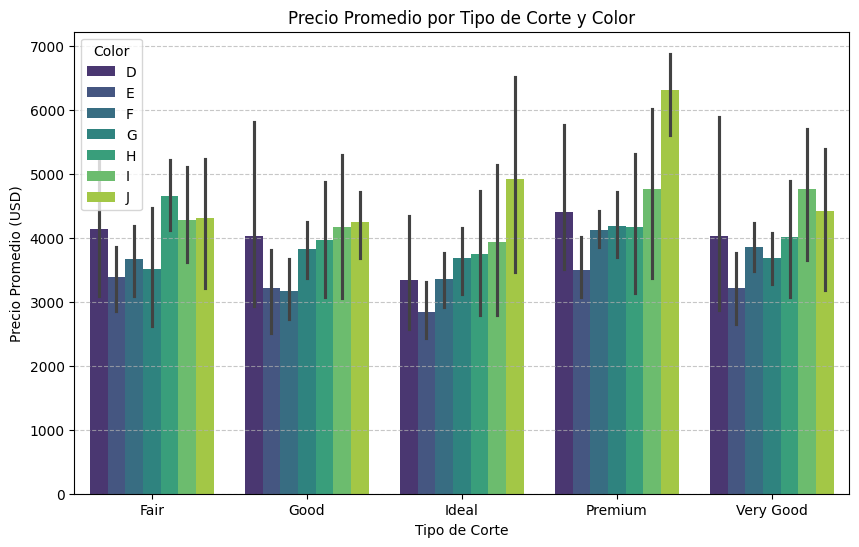

In [65]:
plt.figure(figsize=(10, 6))
sns.barplot(data=grouped, x='cut', y='price_mean', hue='color', palette='viridis')
plt.title("Precio Promedio por Tipo de Corte y Color")
plt.xlabel("Tipo de Corte")
plt.ylabel("Precio Promedio (USD)")
plt.legend(title='Color')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


#### Observaciones clave:

**Relación entre corte y precio**:
   - Los cortes de tipo "Premium" parecen tener los precios más altos en promedio, incluso más que los de tipo "Very Good".

**Impacto del color**:
   - Los colores cercanos al rango "J" tienen precios más altos en los cortes "Ideal" y "Premium", mientras que los colores como "E" tienden a estar asociados a precios más bajos en promedio.

**Variabilidad del precio**:
   - Las barras de error sugieren que la variabilidad del precio dentro de cada grupo es significativa.

**Barras de error**:
   - Son muy grandes en comparación con el precio promedio en cada tipo de corte y color.

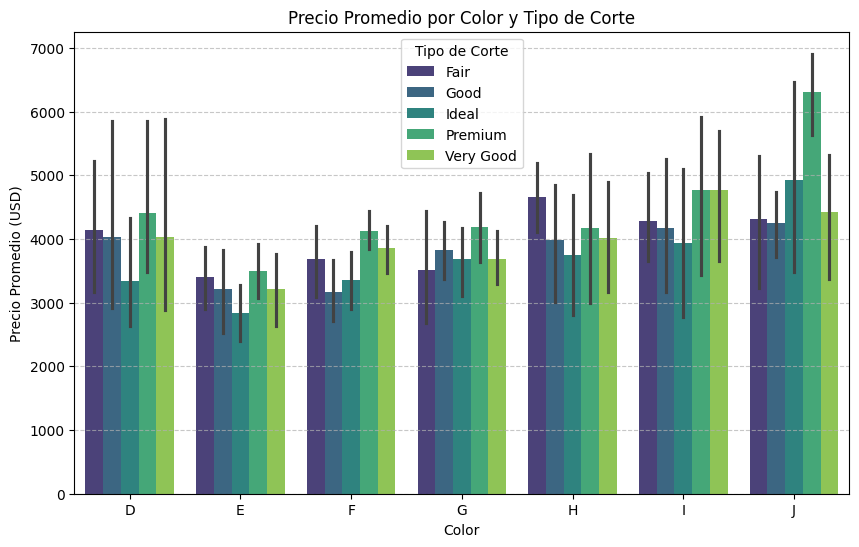

In [66]:
plt.figure(figsize=(10, 6))
sns.barplot(data=grouped, x='color', y='price_mean', hue='cut', palette='viridis')
plt.title("Precio Promedio por Color y Tipo de Corte")
plt.xlabel("Color")
plt.ylabel("Precio Promedio (USD)")
plt.legend(title='Tipo de Corte')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

#### Observaciones clave:

**Relación entre color y precio**:
   - El precio promedio aumenta gradualmente con los colores de "E" a "J".

**Diferencias en tipo de corte**:
   - El tipo de corte "Premium" tiene precios más altos en casi todos los colores, salvo en el "H".
   - El corte "Fair" tiene el precio promedio más alto para el color "H".

**Correlaciones posibles**:
   - Es interesante analizar si colores específicos en combinación con tipos de corte tienen más influencia en el precio. Este gráfico sugiere correlaciones adicionales.



C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3843815142.py:14: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby(categoria).agg({columna: metrica}).reset_index()
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3843815142.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=grouped, x=categoria, y=columna, ax=axes[i, j], palette='viridis')
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3843815142.py:14: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silen

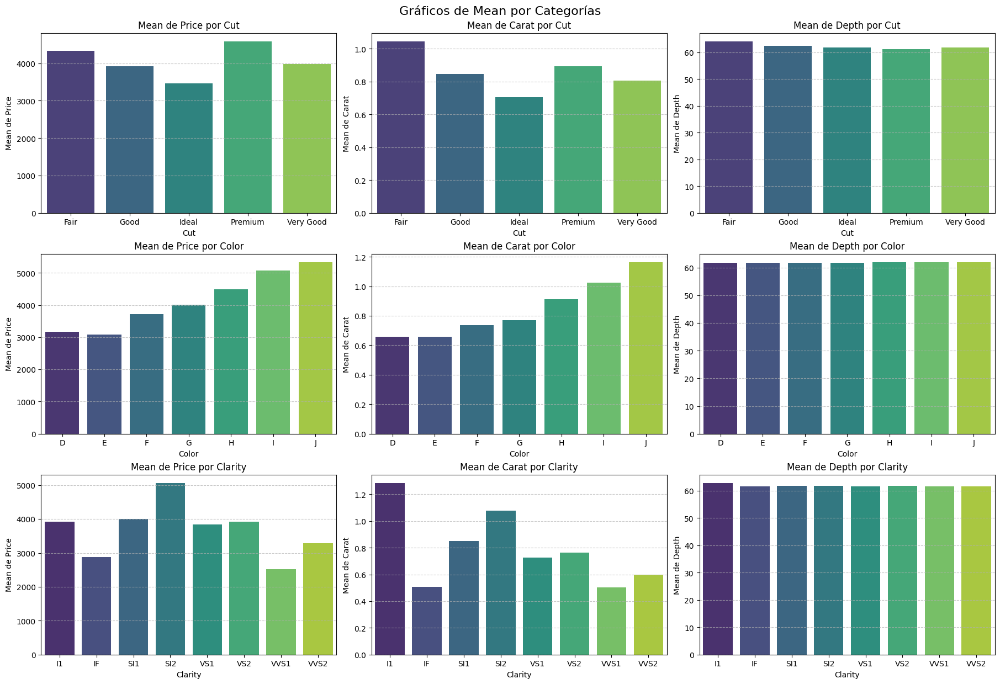

C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3843815142.py:14: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby(categoria).agg({columna: metrica}).reset_index()
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3843815142.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=grouped, x=categoria, y=columna, ax=axes[i, j], palette='viridis')
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3843815142.py:14: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silen

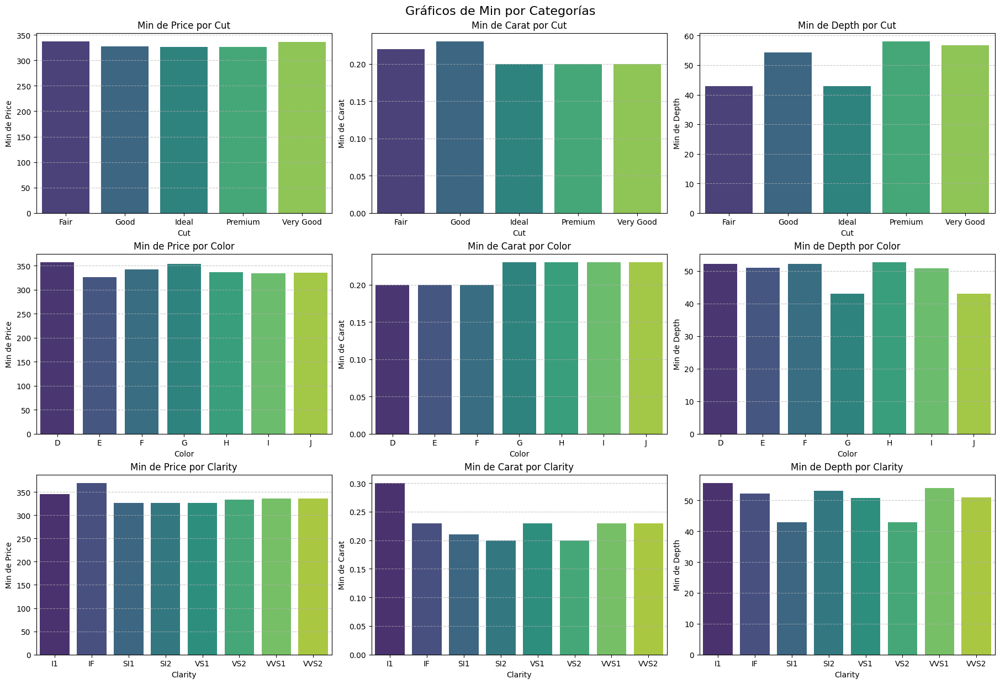

C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3843815142.py:14: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby(categoria).agg({columna: metrica}).reset_index()
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3843815142.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=grouped, x=categoria, y=columna, ax=axes[i, j], palette='viridis')
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3843815142.py:14: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silen

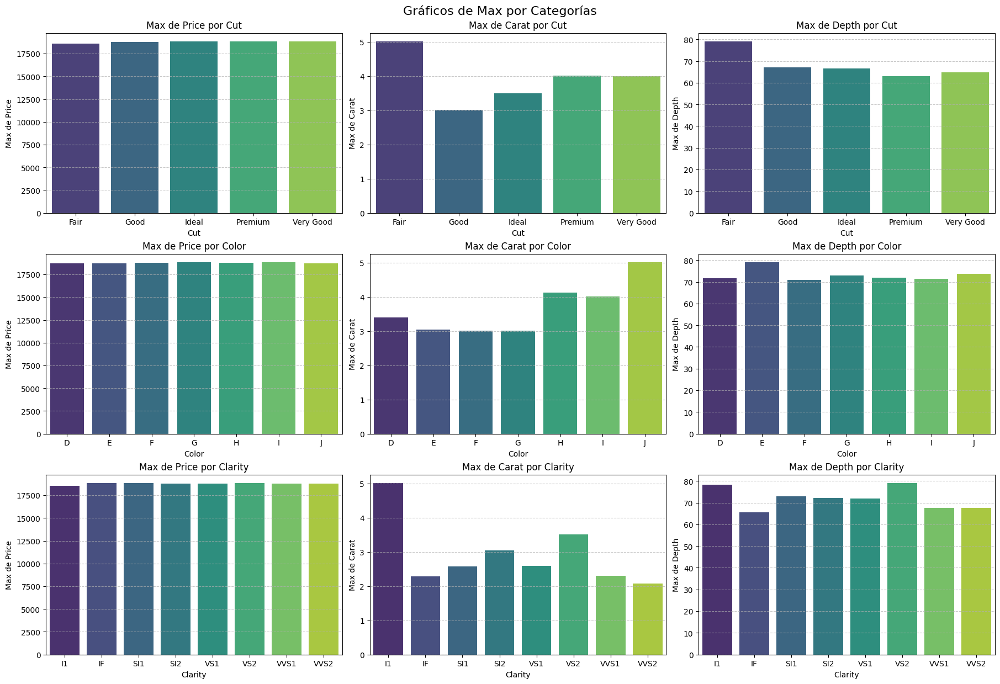

In [67]:
# Categorías y métricas a usar
categorias = ['cut', 'color', 'clarity']
metricas = ['mean', 'min', 'max']
columnas_numericas = ['price', 'carat', 'depth']

# Crear una figura por cada métrica
for metrica in metricas:
    fig, axes = plt.subplots(len(categorias), len(columnas_numericas), figsize=(18, 12), constrained_layout=True)

    # Iterar sobre las categorías y columnas numéricas
    for i, categoria in enumerate(categorias):
        for j, columna in enumerate(columnas_numericas):
            # Agrupar por la categoría actual y calcular la métrica deseada
            grouped = df.groupby(categoria).agg({columna: metrica}).reset_index()
            
            # Crear el gráfico en el subplot correspondiente
            sns.barplot(data=grouped, x=categoria, y=columna, ax=axes[i, j], palette='viridis')
            
            # Configurar el título y las etiquetas
            axes[i, j].set_title(f"{metrica.title()} de {columna.title()} por {categoria.title()}")
            axes[i, j].set_xlabel(categoria.title())
            axes[i, j].set_ylabel(f"{metrica.title()} de {columna.title()}")
            axes[i, j].grid(axis='y', linestyle='--', alpha=0.7)

    # Configurar el título general de la figura
    plt.suptitle(f"Gráficos de {metrica.title()} por Categorías", fontsize=16, y=1.02)
    
    # Mostrar la figura completa
    plt.show()


C:\Users\carol\AppData\Local\Temp\ipykernel_45876\1393144452.py:25: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby(categoria)[columna].agg(metricas).reset_index()
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\1393144452.py:25: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby(categoria)[columna].agg(metricas).reset_index()
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\1393144452.py:25: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True 

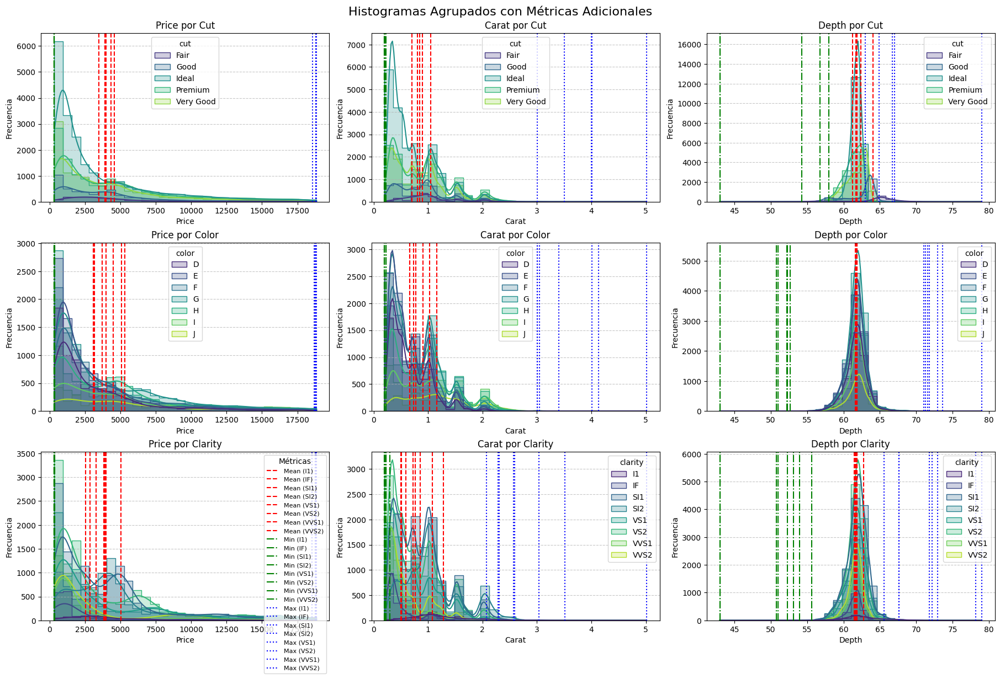

In [68]:
# Categorías y columnas a usar
categorias = ['cut', 'color', 'clarity']
columnas_numericas = ['price', 'carat', 'depth']
metricas = ['mean', 'min', 'max']

# Configurar la figura con subplots (3x3)
fig, axes = plt.subplots(len(categorias), len(columnas_numericas), figsize=(18, 12), constrained_layout=True)

# Iterar sobre las categorías y columnas numéricas
for i, categoria in enumerate(categorias):
    for j, columna in enumerate(columnas_numericas):
        # Crear el histograma con hue
        sns.histplot(
            data=df, 
            x=columna, 
            hue=categoria, 
            kde=True, 
            bins=30, 
            palette='viridis', 
            ax=axes[i, j],
            element='step'
        )
        
        # Calcular y agregar métricas
        grouped = df.groupby(categoria)[columna].agg(metricas).reset_index()
        for metric, style, color in zip(metricas, ['--', '-.', ':'], ['red', 'green', 'blue']):
            for cat, value in zip(grouped[categoria], grouped[metric]):
                axes[i, j].axvline(
                    value, 
                    color=color, 
                    linestyle=style, 
                    linewidth=1.5, 
                    label=f'{metric.capitalize()} ({cat})'
                )

        # Configurar título y etiquetas
        axes[i, j].set_title(f"{columna.title()} por {categoria.title()}")
        axes[i, j].set_xlabel(columna.title())
        axes[i, j].set_ylabel("Frecuencia")
        axes[i, j].grid(axis='y', linestyle='--', alpha=0.7)

        # Mostrar una leyenda única por cada subplot
        if i == len(categorias) - 1 and j == 0:  # Colocar leyenda solo en el primer gráfico
            axes[i, j].legend(title="Métricas", loc='upper right', fontsize=8)

# Mostrar la figura completa
plt.suptitle("Histogramas Agrupados con Métricas Adicionales", fontsize=16, y=1.02)
plt.show()


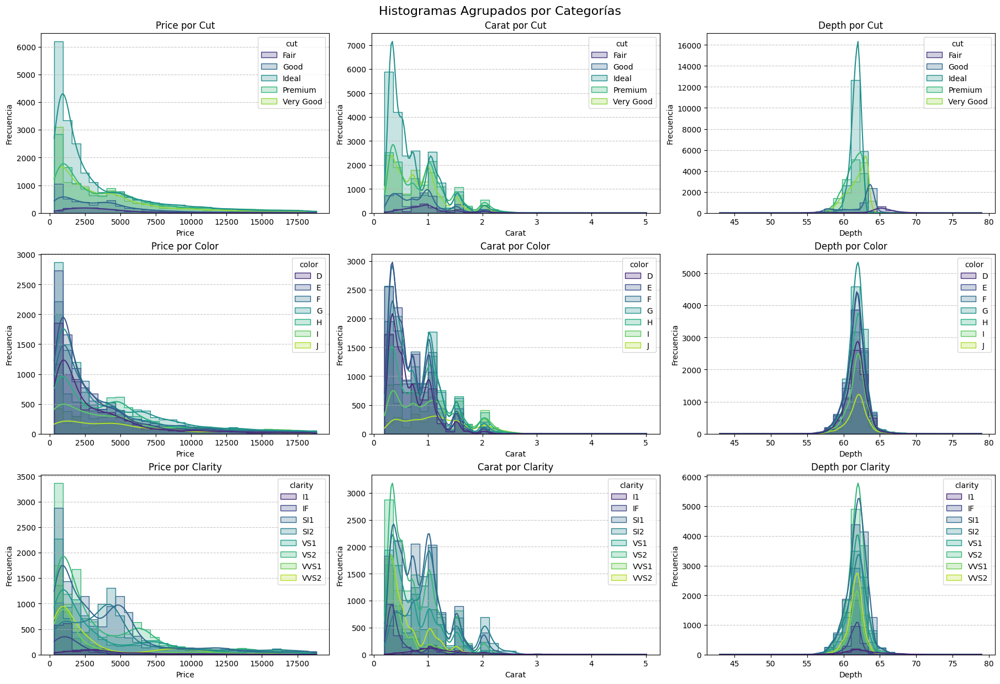

In [69]:
# Categorías y columnas a usar
categorias = ['cut', 'color', 'clarity']
columnas_numericas = ['price', 'carat', 'depth']

# Configurar la figura con subplots
fig, axes = plt.subplots(len(categorias), len(columnas_numericas), figsize=(18, 12), constrained_layout=True)

# Iterar sobre las categorías y columnas numéricas
for i, categoria in enumerate(categorias):
    for j, columna in enumerate(columnas_numericas):
        # Crear el gráfico en el subplot correspondiente
        sns.histplot(
            data=df, 
            x=columna, 
            hue=categoria, 
            kde=True, 
            bins=30, 
            palette='viridis', 
            ax=axes[i, j],
            element='step'
        )
        
        # Configurar el título y las etiquetas
        axes[i, j].set_title(f"{columna.title()} por {categoria.title()}")
        axes[i, j].set_xlabel(columna.title())
        axes[i, j].set_ylabel("Frecuencia")
        axes[i, j].grid(axis='y', linestyle='--', alpha=0.7)

# Mostrar la figura completa
plt.suptitle("Histogramas Agrupados por Categorías", fontsize=16, y=1.02)
plt.show()


# PARTE 3: 20 % distribuciones: 


## 3.1. Outliers: Visualización Q1 y Q3 y calcular límites tukey y filtrar. Sobre la columna precio.
    * limpieza-tratamiento de outliers

Cálculo de Q1, Q3 e IQR:

Q1 (25%): El valor debajo del cual se encuentra el 25% de los datos.
Q3 (75%): El valor debajo del cual se encuentra el 75% de los datos.
IQR: La diferencia entre Q3 y Q1, mide la dispersión central de los datos.
Límites de Tukey:

Límite inferior: 
𝑄
1
−
1.5
×
𝐼
𝑄
𝑅
Q1−1.5×IQR
Límite superior: 
𝑄
3
+
1.5
×
𝐼
𝑄
𝑅
Q3+1.5×IQR
Filtrar Outliers:

Separamos los valores que están fuera de los límites y los etiquetamos como outliers.

In [70]:
df.head()

,carat,cut,color,clarity,depth,table,price,x,y,z,cut_int,price_IVA,discount_applied,price_discount,volumen,price_per_carat,price_per_gr
0,0.229980,Ideal,E,SI2,61.5,55.0,326.0,3.95,3.98,2.43,3,394.460022,10,293.4,38.202030,1417.511719,7087.558594
1,0.209961,Premium,E,SI1,59.8,61.0,326.0,3.89,3.84,2.31,4,394.460022,0,326.0,34.505856,1552.669800,7763.349121
2,0.229980,Good,E,VS1,56.9,65.0,327.0,4.05,4.07,2.31,2,395.670013,0,327.0,38.076885,1421.859863,7109.299316
3,0.290039,Premium,I,VS2,62.4,58.0,334.0,4.20,4.23,2.63,4,404.140015,0,334.0,46.724580,1151.568970,5757.844727
4,0.310059,Good,J,SI2,63.3,58.0,335.0,4.34,4.35,2.75,2,405.350006,0,335.0,51.917250,1080.440918,5402.204590


In [71]:
# Cuartiles e IQR
def cuartiles_iqr(dataframe, columna):
    # Cálculo de Q1, Q3 e IQR
    Q1 = np.percentile(dataframe[columna], 25)  # Primer cuartil
    Q2 = np.percentile(dataframe[columna], 50)  # Segundo cuartil == mediana
    Q3 = np.percentile(dataframe[columna], 75)  # Tercer cuartil
    IQR = Q3 - Q1 # Rango intercuartílico
    print("Cuartiles e IQR:")
    print(f"Q1: {Q1}, Q2 (mediana): {Q2}, Q3: {Q3}")
    print(f"IQR: {IQR}")
    return Q1, Q2, Q3, IQR

Q1, Q2, Q3, IQR = cuartiles_iqr(df, 'price')
print("------------------------------------------------")


Cuartiles e IQR:
Q1: 951.0, Q2 (mediana): 2401.0, Q3: 5325.0
IQR: 4374.0
------------------------------------------------


In [72]:
# Filtrar por porcentaje
def filtrar_por_porcentaje(dataframe, columna):
    sorted_values = np.sort(dataframe[columna])   # Ordenar los valores de la columna
    # Calcular los percentiles
    bottom_20_percent = np.percentile(sorted_values, 20)
    top_20_percent = np.percentile(sorted_values, 80)
    
    # Filtrar precios según los percentiles
    bottom_prices = dataframe[dataframe[columna]<= bottom_20_percent]
    top_prices = dataframe[dataframe[columna] >= top_20_percent]

    # Imprimir resultados
    print(f"Filtrar columna {columna} por porcentaje:")
    print(f"Percentil 20: {bottom_20_percent:.2f}")
    print(f"Percentil 80: {top_20_percent:.2f}")
    print(f"Cantidad en el 20% más barato: {len(bottom_prices)}")
    print(f"Cantidad en el 20% más caro: {len(top_prices)}")
   
    return top_prices, bottom_prices, top_20_percent, bottom_20_percent

# Llamar a la función con el DataFrame y la columna 'price'
top_prices, bottom_prices, top_20_percent, bottom_20_percent = filtrar_por_porcentaje(df, 'price')
print("------------------------------------------------")


Filtrar columna price por porcentaje:
Percentil 20: 837.00
Percentil 80: 6302.00
Cantidad en el 20% más barato: 10761
Cantidad en el 20% más caro: 10760
------------------------------------------------


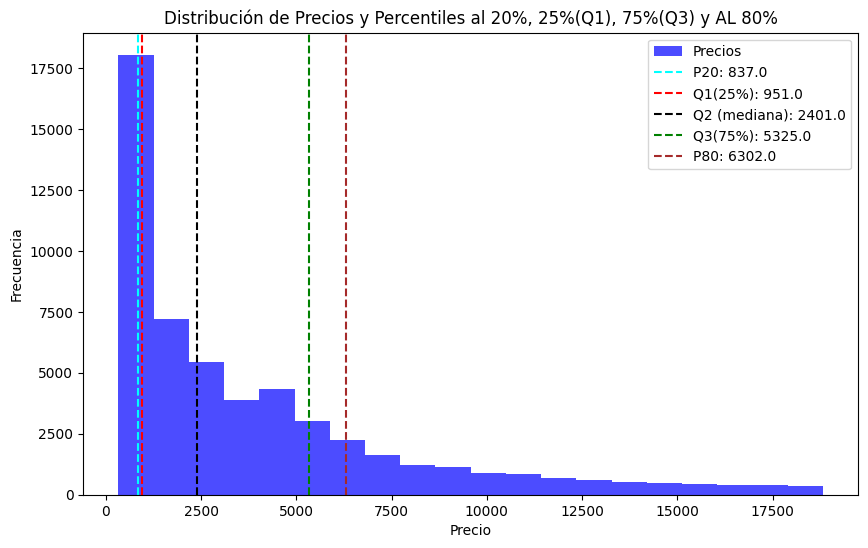

In [73]:
# histograma para visualizar los datos y marcar los percentiles:
plt.figure(figsize=(10, 6))
plt.hist(df['price'], bins=20, color='blue', alpha=0.7, label='Precios')
plt.axvline(bottom_20_percent, color='cyan', linestyle='--', label=f'P20: {bottom_20_percent}')
plt.axvline(Q1, color='red', linestyle='--', label=f'Q1(25%): {Q1}')
plt.axvline(Q2, color='black', linestyle='--', label=f'Q2 (mediana): {Q2}')
plt.axvline(Q3, color='green', linestyle='--', label=f'Q3(75%): {Q3}')
plt.axvline(top_20_percent, color='brown', linestyle='--', label=f'P80: {top_20_percent}')
plt.title("Distribución de Precios y Percentiles al 20%, 25%(Q1), 75%(Q3) y AL 80%")
plt.xlabel("Precio")
plt.ylabel("Frecuencia")
plt.legend()
plt.show()

#### Observaciones clave:
**Percentil 20 (P20)**:
   - Indica que el 20% de los precios más bajos se encuentran por debajo de aproximadamente **837 USD**.

**Primer Cuartil (Q1)**:
   - Marca el 25% más bajo de los precios, con un valor alrededor de **950 USD**.
   - Valores por debajo de este punto se consideran el "rango inferior" de precios.

**Tercer Cuartil (Q3)**:
   - Representa el límite superior del 75% de los datos, alrededor de **5324 USD**.
   - Los precios por encima de este valor están en el 25% más caro.

**Percentil 80 (P80)**:
   - Define que el 20% más alto de los precios están por encima de aproximadamente **6301 USD**.

**Distribución de precios**:
   - La mayoría de los precios están concentrados en valores bajos (pico inicial), lo que indica que la mayoría de los diamantes son relativamente asequibles.
   - A medida que los precios aumentan, la frecuencia disminuye drásticamente, con una cola larga hacia la derecha. (Hay una gran asimetría en la distribución)

**Utilidad**:
Este gráfico es valioso para:
- **Segmentación**: Identificar rangos de precios para diferentes categorías de clientes.
- **Outliers**: Detectar posibles valores extremos más allá de Q1 o Q3.
- **Estrategia de precios**: Evaluar qué proporción de los productos está dentro de ciertos rangos.

In [74]:
'''Crear una nueva columna para identificar si cada fila está en el 20% más barato o más caro:
df['percentile_category'] = df['price'].apply(
    lambda x: 'Bottom 20%' if x <= bottom_20_percent else 'Top 20%' if x >= top_20_percent else 'Middle'
)'''

"Crear una nueva columna para identificar si cada fila está en el 20% más barato o más caro:\ndf['percentile_category'] = df['price'].apply(\n    lambda x: 'Bottom 20%' if x <= bottom_20_percent else 'Top 20%' if x >= top_20_percent else 'Middle'\n)"

In [75]:
'''#Si necesito calcular los cuartiles para grupos dentro del DataFrame:
grouped = df.groupby('otra_columna')['price'].apply(lambda x: np.percentile(x, [25, 50, 75]))
print(grouped)'''

"#Si necesito calcular los cuartiles para grupos dentro del DataFrame:\ngrouped = df.groupby('otra_columna')['price'].apply(lambda x: np.percentile(x, [25, 50, 75]))\nprint(grouped)"

In [76]:
# Varianza y desviación estándar
def varianza_desviacion(columna):
    variance = np.var(columna)
    std_dev = np.std(columna)
    print(f"Varianza: {variance:.2f}, Desviación estándar: {std_dev:.2f}")
    return variance, std_dev

# Llamar a la función con la columna 'price'
variance, std_dev = varianza_desviacion(df['price'])
print("------------------------------------------------")

Varianza: 15901259.00, Desviación estándar: 3987.64
------------------------------------------------


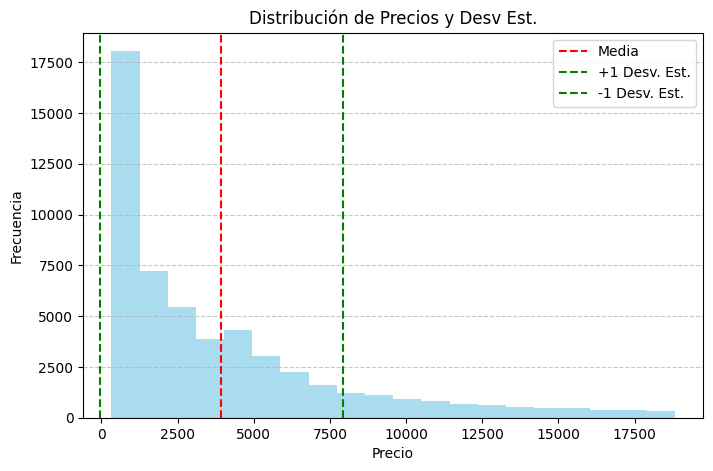

In [77]:
# histograma o boxplot para visualizar la dispersión de los datos:
plt.figure(figsize=(8, 5))
plt.hist(df['price'], bins=20, color='skyblue', alpha=0.7)
plt.axvline(df['price'].mean(), color='red', linestyle='--', label='Media')
plt.axvline(df['price'].mean() + std_dev, color='green', linestyle='--', label='+1 Desv. Est.')
plt.axvline(df['price'].mean() - std_dev, color='green', linestyle='--', label='-1 Desv. Est.')
plt.title("Distribución de Precios y Desv Est.")

plt.xlabel('Precio')
plt.ylabel('Frecuencia')
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()



Este gráfico muestra la **distribución de precios** junto con las **estadísticas de dispersión** (media y desviación estándar).

#### Observaciones:

**Media (Línea roja)**:
   - Representa el precio promedio de los diamantes.
   - Se encuentra cerca de los **4000 USD**, lo que sugiere que la mayoría de los precios tienden hacia este rango, aunque hay una asimetría hacia valores más bajos.

**+1 Desviación Estándar (Línea verde, derecha)**:
   - Indica un rango en el que se encuentran aproximadamente el **68% de los datos superiores** desde la media.
   - Marca la dispersión hacia precios más altos.

**-1 Desviación Estándar (Línea verde, izquierda)**:
   - Muestra el rango en el que se encuentran aproximadamente el **68% de los datos inferiores** desde la media.
   - Los valores hacia este lado representan los precios más asequibles.

**Distribución**:
   - La distribución tiene un pico muy alto cerca de los precios más bajos (derecha del rango -1 desviación estándar).
   - Hay una cola larga hacia precios elevados, lo que sugiere que hay pocos diamantes de lujo o excepcionalmente caros.

### Utilidad:
- **Segmentación del mercado**: Los rangos de desviación estándar pueden ayudar a clasificar los diamantes por categorías (económico, promedio y lujo).
- **Análisis de dispersión**: Es útil para comprender la variabilidad de los precios y cómo están distribuidos alrededor de la media.
- **Identificación de outliers**: Los datos fuera de las desviaciones estándar (+1 o -1) pueden ser considerados extremos.


In [78]:
# Detectar outliers con Tukey
def filtro_outliers_tukey(dataframe, columna, q1, q3, iqr):
    # Cálculo de límites de Tukey
    upper_limit = q3 + 1.5 * iqr
    lower_limit = q1 - 1.5 * iqr
    # Filtrar los outliers
    outliers = dataframe[(dataframe[columna] < lower_limit) | (dataframe[columna] > upper_limit)]
    df_sin_outliers = dataframe[(dataframe[columna] >= lower_limit) & (dataframe[columna] <= upper_limit)]
    print(f"Outliers detectados con Tukey: {len(outliers)}")
    print(f"Límite Inferior: {lower_limit}, Límite Superior: {upper_limit}")
    print("\nOutliers detectados:")
    print(outliers)
    # Agregar Columnas para Identificar Outliers:
    dataframe['is_outlier'] = (dataframe[columna] < lower_limit) | (dataframe[columna] > upper_limit)
    
    return upper_limit, lower_limit, outliers, df_sin_outliers

# Llamar a la función con el DataFrame y la columna 'price'
upper_limit, lower_limit, outliers, df_sin_outliers = filtro_outliers_tukey(df, 'price', Q1, Q3, IQR)
print("------------------------------------------------")

# devuelve el dataframe filtrado sin outliers: df_sin_outliers ****** TO DO

Outliers detectados con Tukey: 3525
Límite Inferior: -5610.0, Límite Superior: 11886.0

Outliers detectados:
          carat        cut color clarity  depth  table    price     x     y  \
23822  1.700195    Premium     I     VS2   62.2   58.0  11888.0  7.65  7.60   
23823  1.089844      Ideal     F      IF   61.6   55.0  11888.0  6.59  6.65   
23824  1.679688      Ideal     E     SI2   60.4   55.0  11888.0  7.79  7.70   
23825  1.540039    Premium     F     SI1   60.9   59.0  11897.0  7.56  7.46   
23826  2.000000    Premium     J     SI2   61.9   55.0  11899.0  8.09  8.06   
...         ...        ...   ...     ...    ...    ...      ...   ...   ...   
27745  2.000000  Very Good     H     SI1   62.8   57.0  18803.0  7.95  8.00   
27746  2.070312      Ideal     G     SI2   62.5   55.0  18804.0  8.20  8.13   
27747  1.509766      Ideal     G      IF   61.7   55.0  18806.0  7.37  7.41   
27748  2.000000  Very Good     G     SI1   63.5   56.0  18818.0  7.90  7.97   
27749  2.289062    Pre

In [79]:
'''# Aplicar Tukey a Múltiples Columnas: Si deseas aplicar este análisis a varias columnas numéricas:
for col in df.select_dtypes(include=np.number).columns:
    filtro_outliers_tukey(df, col)

#Filtrar el DataFrame: Si deseas eliminar los outliers y trabajar solo con los datos filtrados:
filtered_df.to_csv('filtered_data.csv', index=False)'''

"# Aplicar Tukey a Múltiples Columnas: Si deseas aplicar este análisis a varias columnas numéricas:\nfor col in df.select_dtypes(include=np.number).columns:\n    filtro_outliers_tukey(df, col)\n\n#Filtrar el DataFrame: Si deseas eliminar los outliers y trabajar solo con los datos filtrados:\nfiltered_df.to_csv('filtered_data.csv', index=False)"

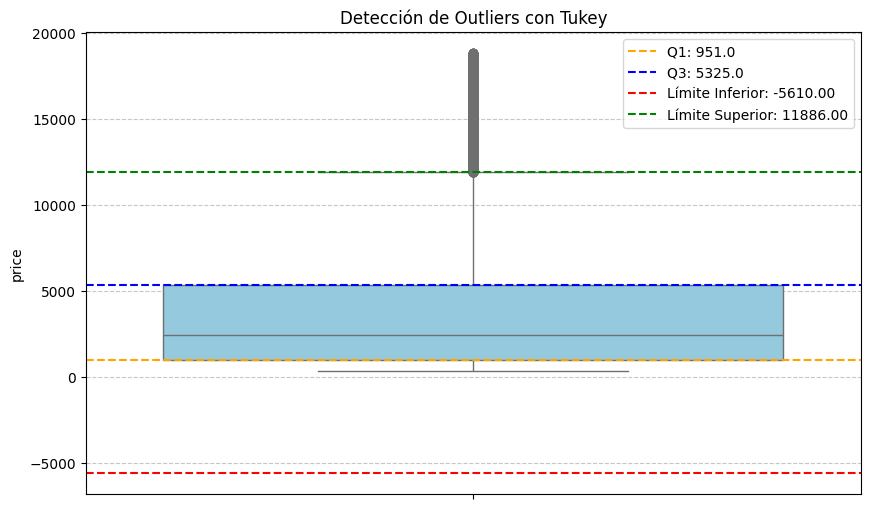

In [80]:
# boxplot para visualizar los datos y marcar los límites:
plt.figure(figsize=(10, 6))
sns.boxplot(data=df, y='price', color='skyblue')  # se hace con el df sin quitar outliers, el mismo boxploit los marca
plt.axhline(Q1, color='orange', linestyle='--', label=f'Q1: {Q1}')
plt.axhline(Q3, color='blue', linestyle='--', label=f'Q3: {Q3}')

plt.axhline(lower_limit, color='red', linestyle='--', label=f'Límite Inferior: {lower_limit:.2f}')
plt.axhline(upper_limit, color='green', linestyle='--', label=f'Límite Superior: {upper_limit:.2f}')
plt.title("Detección de Outliers con Tukey")
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

Este gráfico es un **boxplot** de precios con los límites de Tukey marcados, lo que permite visualizar los **outliers** y la dispersión de los datos.

**Percentiles (Q1 y Q3)**:
   - **Q1 (Percentil 25)**: El 25% de los precios están por debajo de **950 USD**.
   - **Q3 (Percentil 75)**: El 75% de los precios están por debajo de **5324 USD**.

**Rango Intercuartílico (IQR)**:
   - IQR = Q3 - Q1 = **5324 - 950 = 4374 USD**.
   - Representa el rango en el que se encuentra el **50% central de los datos**.

**Límites de Tukey**:
   - **Límite Inferior**: Q1 - 1.5 * IQR = **-5611 USD**.
   - **Límite Superior**: Q3 + 1.5 * IQR = **11885 USD**.
   - Valores fuera de estos límites se consideran **outliers**.

**Distribución de los precios**:
   - La mayoría de los precios están dentro del rango intercuartílico.
   - Existen valores superiores a **11885 USD** (outliers superiores), lo que indica que hay diamantes excepcionales con precios muy altos.

**Outliers**:
   - Los **puntos negros** por encima del límite superior representan **outliers**: diamantes que tienen un precio significativamente mayor que el promedio.
   - No se observan outliers inferiores, ya que el límite inferior es negativo y los precios no pueden ser negativos.

**Uso práctico**:
- **Identificación de diamantes de lujo**: Los outliers superiores corresponden a los diamantes más caros.
- **Control de calidad**: Permite identificar posibles errores o precios inusualmente altos.
- **Filtrado de datos**: Si deseas trabajar con datos sin outliers, puedes filtrar los precios que están dentro de los límites de Tukey.


Graficar Outliers


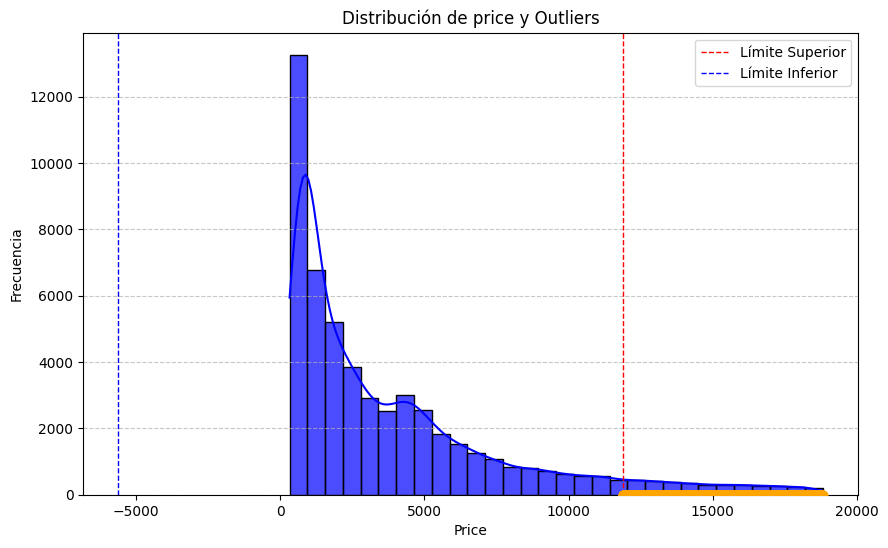

In [81]:

# Graficar outliers
def graficar_outliers(dataframe, columna, upper_limit, lower_limit, outliers):
    print("Graficar Outliers")
    plt.figure(figsize=(10, 6))
    # Histograma con KDE
    sns.histplot(dataframe[columna], bins=30, color="blue", alpha=0.7, kde=True)
    # Límites
    # Se agregan líneas verticales para marcar los límites superior e inferior:
    plt.axvline(upper_limit, color='red', linestyle='dashed', linewidth=1, label="Límite Superior")
    plt.axvline(lower_limit, color='blue', linestyle='dashed', linewidth=1, label="Límite Inferior")
    # Configuración del gráfico
    plt.legend()
    plt.title(f"Distribución de {columna} y Outliers")
    plt.xlabel(columna.capitalize())
    plt.ylabel("Frecuencia")
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    # Resaltar los outliers en el gráfico:
    plt.scatter(outliers[columna],[0]*len(outliers), color='orange', label='Outliers', zorder=5)
    # plt.grid()
    plt.show()
    
graficar_outliers(df, 'price', upper_limit, lower_limit, outliers)


Vemos los outliers marcados en naranja, por encima del valor de Q3

   - La distribución está sesgada hacia la derecha, indicando que la mayoría de los precios son bajos, mientras que hay valores altos (outliers) menos frecuentes.

   - Los outliers suelen tener un impacto significativo en estadísticas como la media y la varianza, lo que podría requerir transformaciones o tratamientos adicionales, dependiendo del análisis.

   - Dada la naturaleza sesgada de los datos, podrías considerar trabajar con la transformación logarítmica para una mejor visualización y análisis, como ya se hizo anteriormente.


    * estandarizar


**A partir de aquí, cojo sólo el dataframe sin outliers**:


In [82]:
# A partir de aquí, cojo sólo el datafram sin outliers:
df = df_sin_outliers

In [83]:
# Estandarizar una columna
def estandarizar(dataframe, columna):
    print(f"Estandarización de la columna '{columna}':")
    # Cálculo de la media y desviación estándar
    mean_columna = np.mean(dataframe[columna])
    std_dev_columna = np.std(dataframe[columna])
    print(f"Media: {mean_columna:.2f}, Desviación estándar: {std_dev_columna:.2f}")
    # Estandarización
    columna_std = (dataframe[columna] - mean_columna) / std_dev_columna
    return columna_std

df['price_std'] = estandarizar(df, 'price')
print("------------------------------------------------")
# Mostrar el DataFrame resultante
print("DataFrame sin outliers,con columna estandarizada:")
#print("DataFrame con columna estandarizada:")
print(df)


Estandarización de la columna 'price':
Media: 3160.68, Desviación estándar: 2764.76
------------------------------------------------
DataFrame sin outliers,con columna estandarizada:
          carat        cut color clarity  depth  table   price     x     y  \
0      0.229980      Ideal     E     SI2   61.5   55.0   326.0  3.95  3.98   
1      0.209961    Premium     E     SI1   59.8   61.0   326.0  3.89  3.84   
2      0.229980       Good     E     VS1   56.9   65.0   327.0  4.05  4.07   
3      0.290039    Premium     I     VS2   62.4   58.0   334.0  4.20  4.23   
4      0.310059       Good     J     SI2   63.3   58.0   335.0  4.34  4.35   
...         ...        ...   ...     ...    ...    ...     ...   ...   ...   
53935  0.720215      Ideal     D     SI1   60.8   57.0  2757.0  5.75  5.76   
53936  0.720215       Good     D     SI1   63.1   55.0  2757.0  5.69  5.75   
53937  0.700195  Very Good     D     SI1   62.8   60.0  2757.0  5.66  5.68   
53938  0.859863    Premium     H     

In [84]:
# Verificación: Verifica si la media de la columna estandarizada es cercana a 0 y la desviación estándar cercana a 1:
print(df['price_std'].mean(), df['price_std'].std())

# Verificar si la transformación es correcta
print(f"Media de 'price_std': {df['price_std'].mean()}")
#print(f"Desviación estándar de 'price_std': {df['price_std'].std()}")
print(f"Desviación estándar (sin outliers) de 'price_std': {df['price_std'].std()}")
print()
# Para confirmar que los datos estandarizados son correctos, puedes inspeccionar la columna price_std:
print(df[['price', 'price_std']])
#plt.figure(figsize=(10, 6))
#plt.scatter(df['price'], df['price_std'], color='blue', alpha=0.5)

-1.9608859e-07 1.0000099
Media de 'price_std': -1.9608859247455257e-07
Desviación estándar (sin outliers) de 'price_std': 1.0000098943710327

        price  price_std
0       326.0  -1.025291
1       326.0  -1.025291
2       327.0  -1.024929
3       334.0  -1.022397
4       335.0  -1.022035
...       ...        ...
53935  2757.0  -0.146010
53936  2757.0  -0.146010
53937  2757.0  -0.146010
53938  2757.0  -0.146010
53939  2757.0  -0.146010

[50269 rows x 2 columns]


TO DO : Explicar qué significado tienen estos valores que han salido::

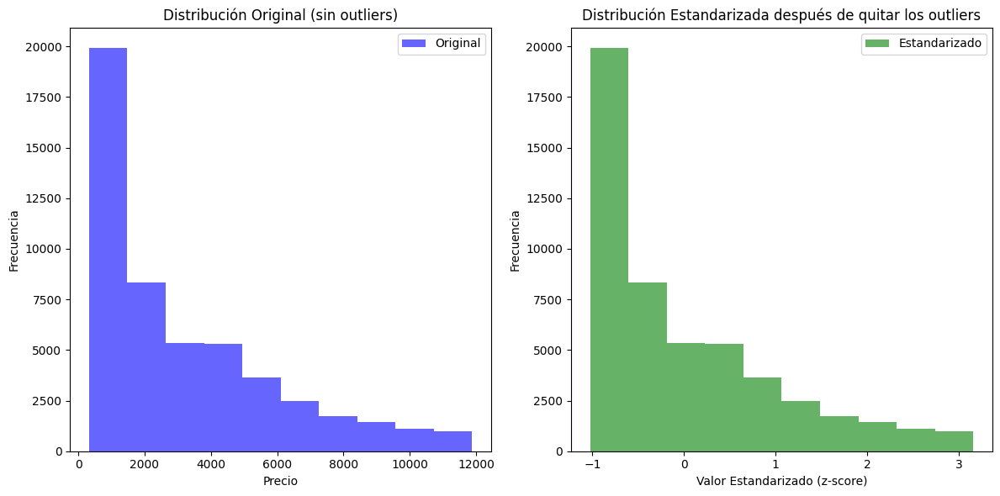

In [85]:
# Visualización
plt.figure(figsize=(12, 6))

# Histograma original
plt.subplot(1, 2, 1)
plt.hist(df['price'], bins=10, alpha=0.6, color='blue', label='Original')
#plt.title('Distribución Original')
plt.title('Distribución Original (sin outliers)')
plt.xlabel('Precio')
plt.ylabel('Frecuencia')
plt.legend()

# Histograma estandarizado
plt.subplot(1, 2, 2)
plt.hist(df['price_std'], bins=10, alpha=0.6, color='green', label='Estandarizado')
#plt.title('Distribución Estandarizada')
plt.title('Distribución Estandarizada después de quitar los outliers')
plt.xlabel('Valor Estandarizado (z-score)')
plt.ylabel('Frecuencia')
plt.legend()

plt.tight_layout()
plt.show()

1. **Distribución Original (izquierda)**:
   - La distribución original del precio muestra una fuerte **asimetría positiva** (derecha). Esto significa que la mayoría de los precios son bajos, con algunos valores muy altos que generan una "cola" a la derecha, a pesar de haber quitado los outliers.
   - Este tipo de distribución puede afectar negativamente algunos análisis estadísticos, como el cálculo de la media o varianza, al estar influenciados por los valores extremos.

2. **Distribución Estandarizada (derecha)**:
   - La transformación **estandariza** los datos para tener una media de 0 y una desviación estándar de 1. Esto convierte los valores del precio en puntuaciones z (**z-score**), que representan cuántas desviaciones estándar se encuentra un valor respecto a la media.
   - La asimetría aún se conserva, ya que la estandarización no cambia la forma general de la distribución.


- La estandarización es útil para comparar diferentes variables en la misma escala, especialmente en modelos de aprendizaje automático o análisis multivariados.
- Sin embargo, si el objetivo es trabajar con una distribución más normalizada (menos sesgada), podría ser necesario aplicar transformaciones como logarítmica o raíz cuadrada antes de estandarizar.


In [86]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 50269 entries, 0 to 53939
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   carat             50269 non-null  float32 
 1   cut               50269 non-null  category
 2   color             50269 non-null  category
 3   clarity           50269 non-null  category
 4   depth             50269 non-null  float64 
 5   table             50269 non-null  float64 
 6   price             50269 non-null  float32 
 7   x                 50269 non-null  float64 
 8   y                 50269 non-null  float64 
 9   z                 50269 non-null  float64 
 10  cut_int           50269 non-null  category
 11  price_IVA         50269 non-null  float32 
 12  discount_applied  50269 non-null  int64   
 13  price_discount    50269 non-null  float64 
 14  volumen           50269 non-null  float64 
 15  price_per_carat   50269 non-null  float32 
 16  price_per_gr      50269 non

## 3.2. asimetría, curtosis y transformar datos con logaritmo o raíz cuadrada, aplicar sobre precio, visualizar el histograma y/o boxplot por tipo de corte. Opcional ajustar la escala.


In [87]:

# Asimetría y curtosis
def asimetria_curtosis(dataframe, columna):
    print(f"Asimetría y curtosis de la columna {columna}, después de quitar los outliers")
    skewness = stats.skew(df[columna])
    kurtosis = stats.kurtosis(df[columna])
    print(f"Asimetría: {skewness}, Curtosis: {kurtosis}")
    
asimetria_curtosis(df, 'price')
print("------------------------------------------------")

Asimetría y curtosis de la columna price, después de quitar los outliers
Asimetría: 1.1888598203659058, Curtosis: 0.6258633136749268
------------------------------------------------


### Interpretación de los Resultados de Asimetría y Curtosis

#### **Asimetría (Skewness):** 1.618
- **Valor positivo (1.618):**
  - Indica una **asimetría positiva**. Esto significa que los datos tienen una cola más larga hacia la derecha.
  - En el contexto de precios de diamantes, sugiere que la mayoría de los precios están en rangos más bajos, pero hay algunos diamantes excepcionalmente caros que elevan la cola derecha de la distribución.
- **Valor > 1:** 
  - Refleja una fuerte asimetría, lo cual es común en datos económicos o de precios, donde existen valores atípicos más altos.

---

#### **Curtosis:** 2.178
- **Valor < 3 (Curtosis platicúrtica):**
  - Indica que la distribución tiene colas más delgadas que una distribución normal.
  - Esto sugiere que los precios de los diamantes no tienen una gran cantidad de valores extremos, aunque los que existen son suficientemente influyentes para causar una asimetría positiva significativa.
- **Interpretación en este caso:**
  - Aunque hay valores extremos, no son lo suficientemente frecuentes como para engrosar las colas de la distribución.

---

#### Conclusiones:
1. **Los precios de los diamantes están fuertemente sesgados hacia la derecha.** ??????? TO DO
   - La mayoría de los precios están concentrados en rangos bajos, pero unos pocos diamantes de lujo tienen precios extremadamente altos, afectando la asimetría.
2. **La distribución no tiene colas gruesas (Curtosis < 3):**
   - Los valores extremos existen, pero no son tan frecuentes como para engrosar las colas de la distribución.
3. **Transformaciones sugeridas:**
   - Aplicar una transformación logarítmica puede reducir la asimetría y mejorar la interpretación de los datos en gráficos y análisis posteriores.
   
---

#### Acción Recomendada:
Visualizar el efecto de la transformación logarítmica o raíz cuadrada en el histograma de precios para observar cómo cambia la simetría y la curtosis. Esto puede hacer más fáciles de interpretar las relaciones entre los precios y otras variables categóricas como `cut`, `color` y `clarity`.

    * transformaciones


Transformando distribución de la columna 'price'


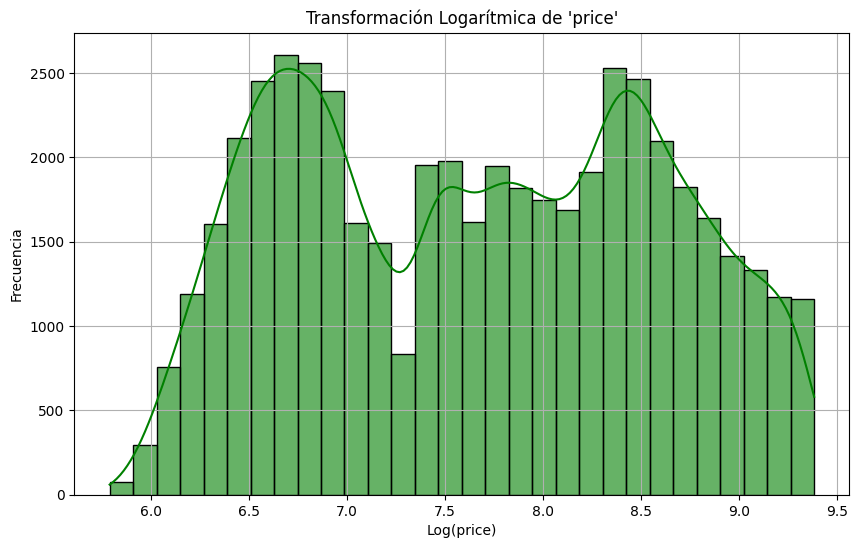

------------------------------------------------
Valores transformados (log):
0        5.786897
1        5.786897
2        5.789960
3        5.811141
4        5.814131
           ...   
53935    7.921898
53936    7.921898
53937    7.921898
53938    7.921898
53939    7.921898
Name: price, Length: 50269, dtype: float32


In [88]:
# Transformar distribuciones
def transformar_distribuciones(dataframe, columna):
    print(f"Transformando distribución de la columna '{columna}'")
    # Filtrar valores positivos (aunque sepamos que todos los precios lo son)
    valores_positivos = dataframe[columna][dataframe[columna] > 0]
    
    # Aplicar transformación logarítmica
    log_transformation = np.log(valores_positivos)
    
    # Gráfico de la distribución transformada
    plt.figure(figsize=(10, 6))
    sns.histplot(log_transformation, kde=True, bins=30, color="green", alpha=0.6)
    plt.title(f"Transformación Logarítmica de '{columna}'")
    plt.xlabel(f"Log({columna})")
    plt.ylabel("Frecuencia")
    plt.grid()
    plt.show()
    
    # Retornar la transformación
    return log_transformation

# Llamar a la función con la columna 'price'
price_log = transformar_distribuciones(df, 'price')
print("------------------------------------------------")

# Mostrar los datos transformados
print("Valores transformados (log):")
print(price_log)



#### **Interpretación del Histograma Logarítmico de Price:**

1. **Transformación Logarítmica:**
   - Al aplicar el logaritmo a los precios, la distribución de datos parece haber mejorado en términos de simetría, distribuyendo los precios de manera más uniforme.

2. **Picos y Modos:**
   - La distribución parece mostrar varios **picos** o **modos**, lo que puede indicar subconjuntos de precios característicos en diferentes rangos.
   - Estos picos podrían relacionarse con diferentes características categóricas como el tipo de corte (`cut`), claridad (`clarity`), o color (`color`) del diamante.

3. **Cola a la Derecha:**
   - Aunque la transformación ha reducido significativamente la asimetría, sigue existiendo un atisbo de cola hacia la derecha, aunque menos prominente que antes.

**Acción Recomendada:**
1. **Relacionar con otras variables:**
   - Es interesante analizar cómo estos rangos de precios se distribuyen según variables categóricas como `cut`, `color` o `clarity`.
   - Realizar gráficos bivariantes (por ejemplo, `price` vs. `cut` con `hue=color`) puede proporcionar información valiosa.

2. **Boxplot para Tipos de Corte:**
   - Crear un gráfico de caja para los tipos de corte permitirá observar la dispersión de los precios después de la transformación.

3. **Contraste con otras transformaciones:**
   - Realizar una transformación de raíz cuadrada sobre la misma variable y comparar cómo afecta la distribución respecto a la transformación logarítmica.


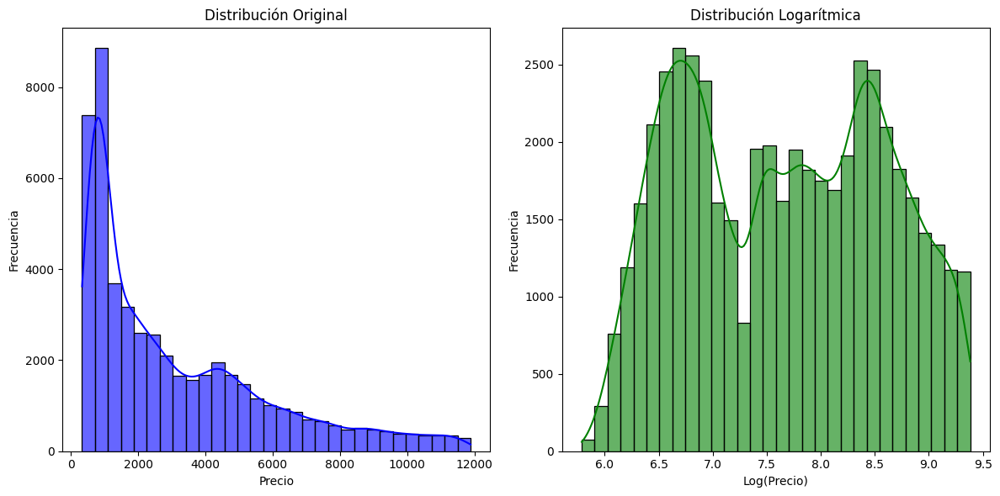

In [89]:
# Comparar Distribuciones Originales y Transformadas: Gráficos lado a lado para comparar:
plt.figure(figsize=(12, 6))

# Original
plt.subplot(1, 2, 1)
# plt.subplot(1,3,1)
sns.histplot(df['price'], kde=True, bins=30, color="blue", alpha=0.6)
plt.title("Distribución Original")
plt.xlabel("Precio")
plt.ylabel("Frecuencia")

# Transformada: logarítmica
plt.subplot(1, 2, 2)
# plt.subplot(1, 3, 2)
sns.histplot(price_log, kde=True, bins=30, color="green", alpha=0.6)
plt.title("Distribución Logarítmica")
plt.xlabel("Log(Precio)")
plt.ylabel("Frecuencia")

# Transformada: logarítmica con la escala del precio
#plt.subplot(1, 2, 2)
#plt.subplot(1, 3, 3)
#sns.histplot(price_log, kde=True, bins=30, color="green", alpha=0.6)
#plt.title("Distribución Logarítmica con precio en sus unidades")
#plt.xlabel("Precio")
#plt.ylabel("Frecuencia")


#fig = px.box(df_ticket, x='Quantity', y='price_log')
#fig.update_layout(
#    xaxis= {
#        'range': [5.5 , 10],
#        'tickvals': [5.5, 6.0, 6.5, 7.0, 7.5, 8.0, 8.5, 9.0, 9.5, 10, 10.5],
#        'ticktext': [f'{x:.2f} €' for x in np.exp([5.5, 6.0, 6.5, 7.0, 7.5, 8.0, 8.5, 9.0, 9.5, 10, 10.5])]
#    }
#)
# si no ponemos np.exp las etiquetas ticktext se mantendrán en la escala logarítmica: -1, 0, 1, 2, 3, 4, 5
#np.exp revertir la transformación logarítmica para regresar a la escala original

plt.tight_layout()
plt.show()


In [90]:
'''#Histograma Separado por Categorías: Para separar los histogramas:
g = sns.FacetGrid(df, col='cut', col_wrap=3, height=4, sharex=True, sharey=True)
g.map(sns.histplot, 'price', kde=True, bins=20)
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Distribución de Precios por Tipo de Corte")
plt.show()'''

'#Histograma Separado por Categorías: Para separar los histogramas:\ng = sns.FacetGrid(df, col=\'cut\', col_wrap=3, height=4, sharex=True, sharey=True)\ng.map(sns.histplot, \'price\', kde=True, bins=20)\ng.fig.subplots_adjust(top=0.9)\ng.fig.suptitle("Distribución de Precios por Tipo de Corte")\nplt.show()'

'''# Transformaciones Alternativas:  la raíz cuadrada o el inverso:
sqrt_transformation = np.sqrt(valores_positivos)
inv_transformation = 1 / valores_positivos'''  TO DO

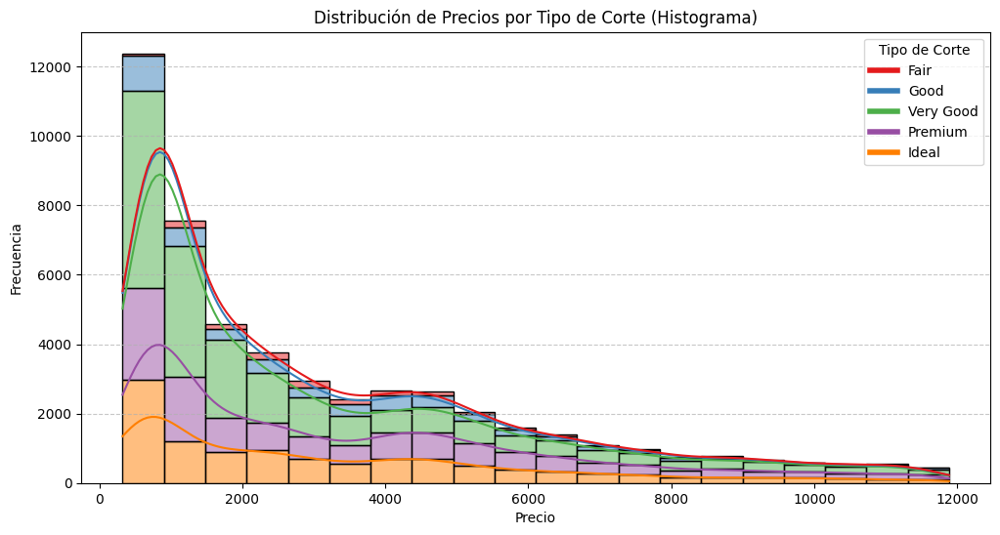

In [91]:
# Definir los tipos de corte y colores manualmente
cuts = ['Fair', 'Good', 'Very Good', 'Premium', 'Ideal']
colors = sns.color_palette('Set1', len(cuts))  # Paleta de colores

# Histograma por tipo de corte
plt.figure(figsize=(12, 6))
sns.histplot(data=df, x='price', hue='cut', multiple='stack', kde=True, bins=20, palette=colors)
plt.title("Distribución de Precios por Tipo de Corte (Histograma)")
plt.xlabel("Precio")
plt.ylabel("Frecuencia")
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Crear leyenda estática
handles = [plt.Line2D([0], [0], color=color, lw=4) for color in colors]  # Colores de la leyenda
plt.legend(handles, cuts, title="Tipo de Corte", loc="upper right", fontsize=10)
plt.show()


En este gráfico de histograma, se visualiza cómo el precio de los diamantes se distribuye por tipo de corte:

1. **Diferencias entre tipos de corte**:
   - Los cortes **Very Good**, **Premium** e **Ideal** son los que más frecuentemente aparecen en rangos bajos de precios. 
   - El corte **Fair** tiene menor frecuencia, pero con precios más concentrados en rangos intermedios.

2. **Asimetría de la distribución**:
   - Todas las distribuciones muestran una asimetría positiva, con colas largas hacia los precios altos, a pesar de haber quitado outliers (quizá debería aumentar el margen) TO DO.
   - Esto es consistente con la mayoría de los diamantes en el conjunto de datos teniendo precios bajos o moderados.

3. **Superposición de las curvas KDE**:
   - Las líneas suaves (Kernel Density Estimation, KDE) muestran patrones similares de acumulación de precios bajos, pero con diferencias sutiles en las distribuciones según el tipo de corte.

4. **Observaciones adicionales**:
   - Sería interesante analizar cómo estas distribuciones cambian al segmentar por otras características como `clarity` o `color`.
   - También podríamos estudiar los precios logarítmicos para ver si las diferencias entre tipos de corte se vuelven más evidentes.


C:\Users\carol\AppData\Local\Temp\ipykernel_45876\1476472980.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='cut', y='price', palette='Set2')
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\1476472980.py:8: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(title="Tipo de Corte", loc="upper left")  # Seaborn no incluye leyenda automáticamente en boxplots


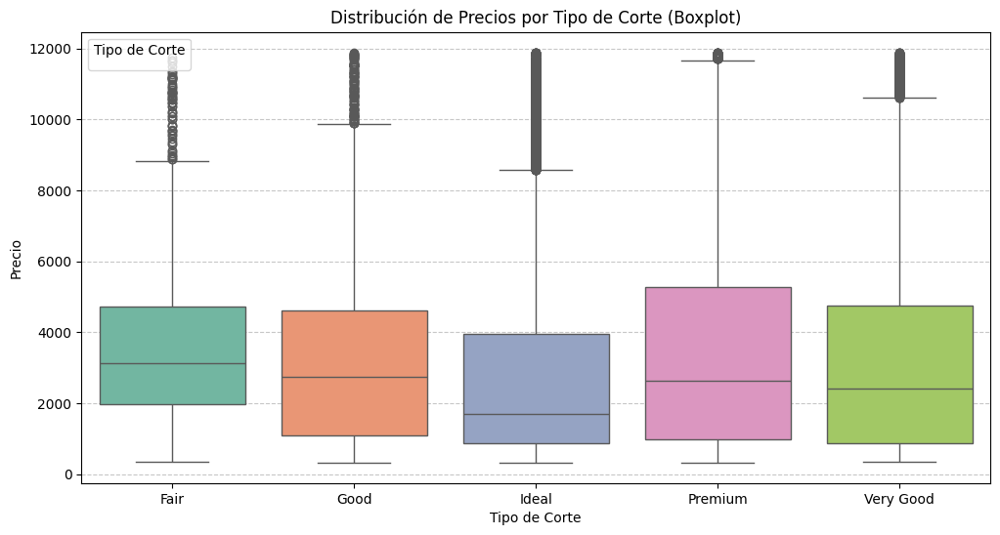

In [92]:
# Boxplot por tipo de corte
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x='cut', y='price', palette='Set2')
plt.title("Distribución de Precios por Tipo de Corte (Boxplot)")
plt.xlabel("Tipo de Corte")
plt.ylabel("Precio")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title="Tipo de Corte", loc="upper left")  # Seaborn no incluye leyenda automáticamente en boxplots
plt.show()

**Límites de los bigotes (whiskers):**
   - Ahora los bigotes se limitan aproximadamente al rango intercuartílico más un factor ajustado, excluyendo los valores extremos más altos.

**Outliers:**
   - Se pueden observar valores atípicos (puntos) más claramente definidos.
   - Los cortes **Premium** e **Ideal** tienen un número notable de outliers en el extremo superior, a pesar de haberlos eliminado anteriormente.

**Escala de precios:**
   - A diferencia de gráficos anteriores con outliers más extremos, este se centra en un rango más práctico de hasta 12,000 USD, eliminando valores fuera de este límite.

- Este gráfico proporciona una visión más centrada en los valores habituales de precios, eliminando la distracción de los valores atípicos extremadamente altos.
- Sería interesante superponer este gráfico con una versión que incluya el precio por quilate para analizar cómo se distribuyen los precios en función de la calidad del corte. TO DO

C:\Users\carol\AppData\Local\Temp\ipykernel_45876\2045876070.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='cut', y='price', palette='Set2')


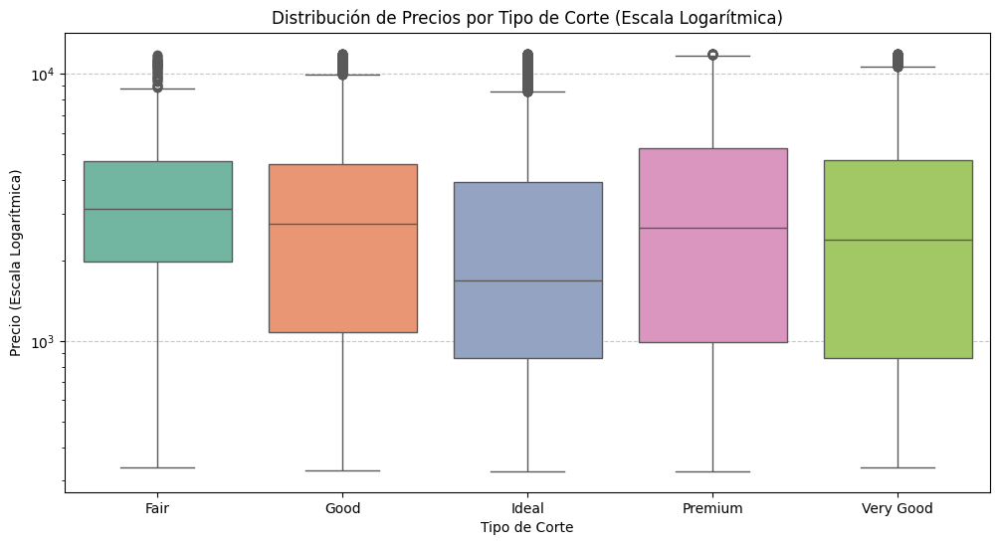

In [93]:
# Ajustar Escala (Logarítmica)
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x='cut', y='price', palette='Set2')
plt.yscale('log')
plt.title("Distribución de Precios por Tipo de Corte (Escala Logarítmica)")
plt.xlabel("Tipo de Corte")
plt.ylabel("Precio (Escala Logarítmica)")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


**Distribución por categoría:**
     - **Fair** tiene una mediana alta, lo que no concuerda con su calidad inferior.
     - **Ideal** presenta la mediana más baja, siendo el tipo de corte menos costoso. Es el que más se recomendaría a un comprador, dada la relación calidad/precio.

In [94]:
# Comparar Métricas por Tipo de Corte: Usando groupby para calcular estadísticas:
stats = df.groupby('cut')['price'].describe()
print(stats)

             count         mean          std    min     25%     50%     75%  \
cut                                                                           
Fair        1499.0  3658.691162  2363.353027  337.0  1982.0  3119.0  4721.0   
Good        4629.0  3288.859619  2570.925293  327.0  1077.0  2732.0  4602.0   
Ideal      20333.0  2813.352783  2697.583740  326.0   862.0  1689.0  3945.0   
Premium    12495.0  3541.717285  2917.339600  326.0   989.5  2644.0  5273.0   
Very Good  11313.0  3245.660645  2760.605225  336.0   863.0  2401.0  4759.0   

               max  
cut                 
Fair       11739.0  
Good       11869.0  
Ideal      11886.0  
Premium    11883.0  
Very Good  11879.0  


C:\Users\carol\AppData\Local\Temp\ipykernel_45876\1587014793.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  stats = df.groupby('cut')['price'].describe()


TO DO comentar los resultados

## 3.3. Discretizar la columna precio por barato, medio, caro usando la función pd.cut


lo asigno así:

- barato: 0 - 2_500 USD
- medio: 2_500 - 7_500 USD
- caro: más de 7_500 USD 

y lo llamo price_category_my

In [95]:
# Definir límites para los precios
bins = [0, 2500, 7500, float('inf')]  # Estos valores se pueden cambiar si es necesario
labels = ['Barato', 'Medio', 'Caro']

# Discretizar la columna `price`
df['price_category_my'] = pd.cut(df['price'], bins=bins, labels=labels)

# Mostrar las primeras filas del DataFrame
#print(df[['price', 'price_category_my']].head(15))

# Contar cuántos diamantes hay en cada categoría
print("\nDistribución de Precios por Categorías :")
print('- barato: 0 - 2_500 USD')
print('- medio: 2_500 - 7_500 USD')
print('- caro: más de 7_500 USD')
# Análisis por Categoría: Calcular estadísticas como la media o la mediana para cada categoría:
print(df.groupby('price_category_my')['price'].describe())



Distribución de Precios por Categorías :
- barato: 0 - 2_500 USD
- medio: 2_500 - 7_500 USD
- caro: más de 7_500 USD
                     count         mean          std     min      25%     50%  \
price_category_my                                                               
Barato             27461.0  1153.204956   574.850281   326.0   698.00   965.0   
Medio              17976.0  4541.957031  1346.206055  2501.0  3389.00  4407.5   
Caro                4832.0  9430.867188  1259.739136  7501.0  8337.75  9290.0   

                       75%      max  
price_category_my                    
Barato              1617.0   2500.0  
Medio               5524.0   7500.0  
Caro               10483.0  11886.0  


C:\Users\carol\AppData\Local\Temp\ipykernel_45876\1703487438.py:17: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  print(df.groupby('price_category_my')['price'].describe())


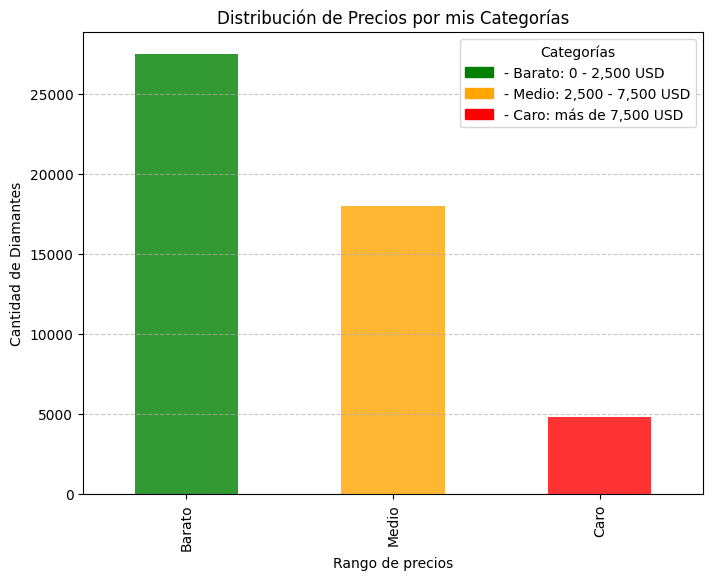

In [96]:
# Distribución de precios categorizados
# Gráfico de barras para la distribución de categorías
plt.figure(figsize=(8, 6))
colors = {'Barato': 'green', 'Medio': 'orange', 'Caro': 'red'}
# Obtener los datos y colores para las barras
value_counts = df['price_category_my'].value_counts()
bars = value_counts.plot(
    kind='bar',
    color=[colors[label] for label in value_counts.index],
    alpha=0.8
)
# Títulos y etiquetas
plt.title('Distribución de Precios por mis Categorías')
plt.xlabel('Rango de precios')
plt.ylabel('Cantidad de Diamantes')
# Añadir leyenda personalizada
labels = [
    '- Barato: 0 - 2,500 USD',
    '- Medio: 2,500 - 7,500 USD',
    '- Caro: más de 7,500 USD'
]
handles = [plt.Rectangle((0, 0), 1, 1, color=colors[label]) for label in value_counts.index]
plt.legend(handles, labels, title="Categorías", loc="upper right")
# Añadir grid
plt.grid(axis='y', linestyle='--', alpha=0.7)
# Mostrar el gráfico
plt.show()


Con la asignación que he hecho, se ve que hay muchísimos más diamantes baratos, y muy pocos caros.

C:\Users\carol\AppData\Local\Temp\ipykernel_45876\1752505480.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='price_category_my', y='carat', palette=palette)


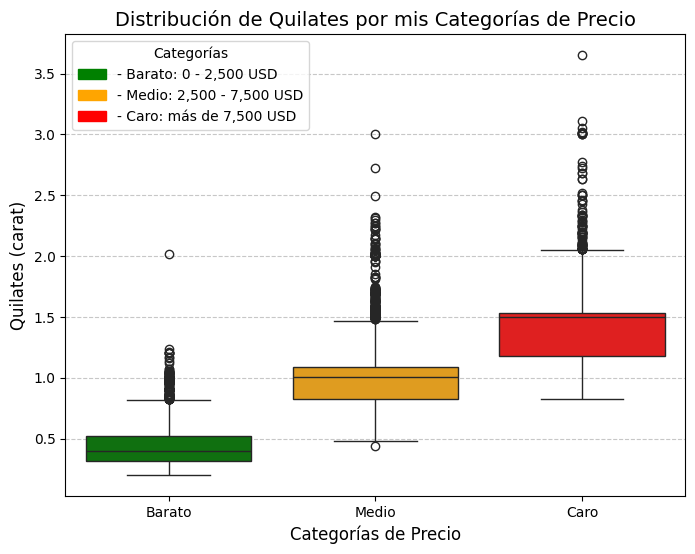

In [97]:
# Gráficos por Categoría: Usar gráficos para explorar otras características por categoría
plt.figure(figsize=(8, 6))
# Crear el boxplot con la paleta personalizada
palette = {'Barato': 'green', 'Medio': 'orange', 'Caro': 'red'}
sns.boxplot(data=df, x='price_category_my', y='carat', palette=palette)
#sns.boxplot(data=df, x='price_category_my', y='carat', palette='Set2')

# Título y etiquetas
plt.title('Distribución de Quilates por mis Categorías de Precio', fontsize=14)
plt.xlabel('Categorías de Precio', fontsize=12)
plt.ylabel('Quilates (carat)', fontsize=12)

# Añadir leyenda personalizada
labels = [
    '- Barato: 0 - 2,500 USD',
    '- Medio: 2,500 - 7,500 USD',
    '- Caro: más de 7,500 USD'
]
handles = [plt.Rectangle((0, 0), 1, 1, color=palette[label]) for label in df['price_category_my'].unique()]
plt.legend(handles, labels, title="Categorías", loc="upper left", fontsize=10)

# Mostrar el gráfico
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


La mediana de carat aumenta de izquierda a derecha, indicando que los diamantes de las categorías más caras tienden a ser de mayor tamaño.



In [98]:
# Definir Límites Dinámicamente: usando percentiles iguales para cada rango:
bins = [0, df['price'].quantile(0.33), df['price'].quantile(0.66), float('inf')]
labels = ['Barato', 'Medio', 'Caro']
df['price_category_tercios'] = pd.cut(df['price'], bins=bins, labels=labels)

Rango de precios para la categoría 'Barato': 326.0 - 1118.0 USD
Rango de precios para la categoría 'Medio': 1119.0 - 3697.0 USD
Rango de precios para la categoría 'Caro': 3699.0 - 11886.0 USD


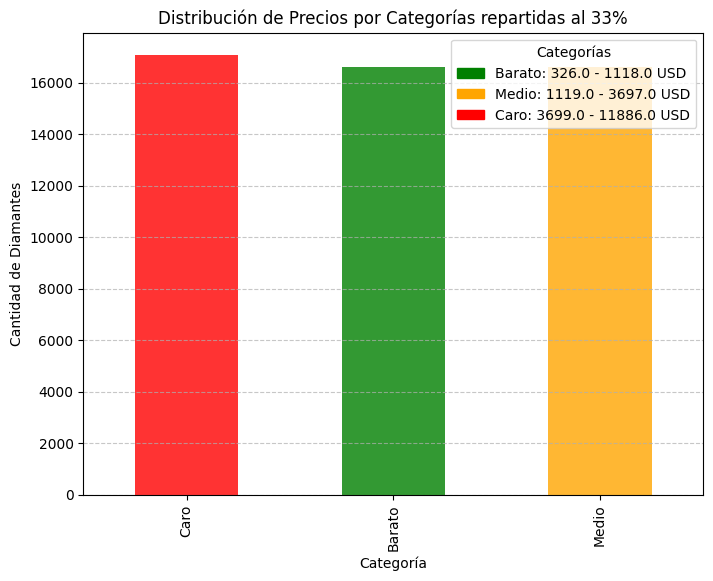

In [99]:
# Extraer rangos de precio para cada categoría, calculadas con un tercio de los datos
rango_barato_min = df[df['price_category_tercios'] == 'Barato']['price'].min()
rango_barato_max = df[df['price_category_tercios'] == 'Barato']['price'].max()

rango_medio_min = df[df['price_category_tercios'] == 'Medio']['price'].min()
rango_medio_max = df[df['price_category_tercios'] == 'Medio']['price'].max()

rango_caro_min = df[df['price_category_tercios'] == 'Caro']['price'].min()
rango_caro_max = df[df['price_category_tercios'] == 'Caro']['price'].max()

# Imprimir los rangos
print(f"Rango de precios para la categoría 'Barato': {rango_barato_min} - {rango_barato_max} USD")
print(f"Rango de precios para la categoría 'Medio': {rango_medio_min} - {rango_medio_max} USD")
print(f"Rango de precios para la categoría 'Caro': {rango_caro_min} - {rango_caro_max} USD")

# Gráfico de barras para la distribución de categorías
plt.figure(figsize=(8, 6))
colors = {'Barato': 'green', 'Medio': 'orange', 'Caro': 'red'}

df['price_category_tercios'].value_counts().plot(
    kind='bar',
    color=[colors[label] for label in df['price_category_tercios'].value_counts().index],
    alpha=0.8
)
plt.title('Distribución de Precios por Categorías repartidas al 33%')
plt.xlabel('Categoría')
plt.ylabel('Cantidad de Diamantes')
# Crear etiquetas personalizadas para la leyenda con los rangos extraídos
labels = [
    f"Barato: {rango_barato_min} - {rango_barato_max} USD",
    f"Medio: {rango_medio_min} - {rango_medio_max} USD",
    f"Caro: {rango_caro_min} - {rango_caro_max} USD"
]
# Añadir leyenda: Usamos plt.Rectangle para crear un manejador que represente cada categoría en la leyenda:
handles = [plt.Rectangle((0, 0), 1, 1, color=colors[label.split(':')[0]]) for label in labels]
plt.legend(handles, labels, title="Categorías", loc="upper right")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


Evidentemente, al usar un percentil del 33% para cada rango, nos quedan los 3 poblados casi por igual, salvo la clumna "Caro" que está poblada al 34%

Al usar el métido .count para hacer la gráfica, se incluyen primero los valores más altos


C:\Users\carol\AppData\Local\Temp\ipykernel_45876\636014838.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='price_category_tercios', y='carat', palette=palette)


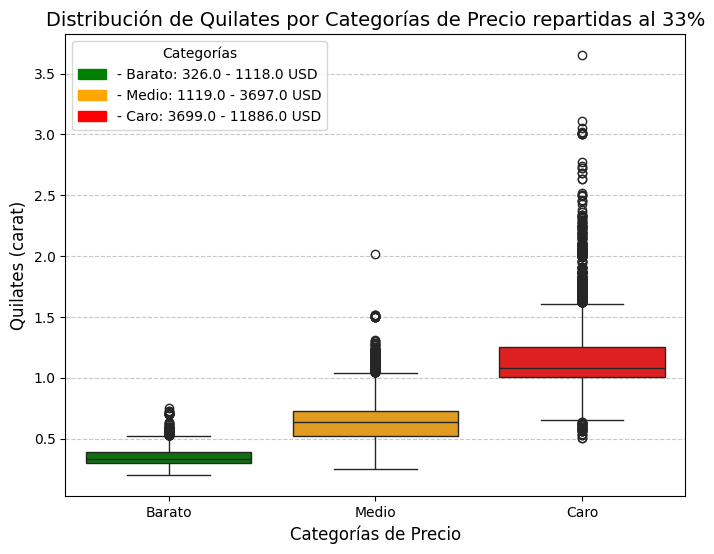

In [100]:
plt.figure(figsize=(8, 6))
# Crear el boxplot con la paleta personalizada
palette = {'Barato': 'green', 'Medio': 'orange', 'Caro': 'red'}
sns.boxplot(data=df, x='price_category_tercios', y='carat', palette=palette)
# Título y etiquetas
plt.title('Distribución de Quilates por Categorías de Precio repartidas al 33%', fontsize=14)
plt.xlabel('Categorías de Precio', fontsize=12)
plt.ylabel('Quilates (carat)', fontsize=12)
# Añadir leyenda personalizada
labels = [
    f'- Barato: {rango_barato_min} - {rango_barato_max} USD',
    f'- Medio: {rango_medio_min} - {rango_medio_max} USD',
    f'- Caro: {rango_caro_min} - {rango_caro_max} USD'
]
handles = [plt.Rectangle((0, 0), 1, 1, color=palette[label]) for label in df['price_category_tercios'].unique()]
plt.legend(handles, labels, title="Categorías", loc="upper left", fontsize=10)
# Mostrar el gráfico
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


En la categoría "Caro", algunos diamantes llegan hasta 3.5 quilates, mientras que en las categorías "Barato" y "Medio", los valores extremos son menores.

El gráfico respalda la relación esperada entre el precio y el tamaño del diamante


In [101]:
# Análisis por Categoría: Calcular estadísticas como la media o la mediana para cada categoría:
print(df.groupby('price_category_tercios')['price'].describe())

                          count         mean          std     min      25%  \
price_category_tercios                                                       
Barato                  16590.0   752.724915   191.111008   326.0   602.00   
Medio                   16589.0  2206.972656   720.457642  1119.0  1629.00   
Caro                    17090.0  6423.940918  2187.375244  3699.0  4617.25   

                           50%     75%      max  
price_category_tercios                           
Barato                   745.0   906.0   1118.0  
Medio                   2115.0  2777.0   3697.0  
Caro                    5788.5  7840.0  11886.0  


C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3571150477.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  print(df.groupby('price_category_tercios')['price'].describe())



**Distribución de los datos:**
   - **Barato:**
     - Tiene la menor mediana y un rango de valores muy estrecho.
     - La mayoría de los diamantes en esta categoría tienen un peso de menos de 0.5 quilates, como era de esperar para diamantes económicos.
     - Los outliers son mínimos en comparación con las otras categorías.
   - **Medio:**
     - La mediana y el rango son mayores que en la categoría "Barato".
     - Los datos están más dispersos y hay más outliers, lo que indica una variabilidad significativa en los quilates de diamantes de precio medio.
   - **Caro:**
     - La mediana y el rango son notablemente mayores que en las otras categorías.
     - Un número considerable de outliers representa diamantes de más de 2 quilates, que son extremadamente costosos y menos comunes.

**Rangos intercuartílicos (IQR):**
   - El rango intercuartílico (IQR) aumenta a medida que se pasa de "Barato" a "Caro". Esto muestra que la variabilidad de los quilates aumenta con el precio.

- El gráfico confirma la correlación esperada entre el tamaño del diamante (en quilates) y su precio.
- Los diamantes más grandes son predominantes en la categoría "Caro", mientras que los pequeños se agrupan en "Barato".
- La categoría "Medio" actúa como un puente, con una combinación de pesos moderados y algunos diamantes más pequeños y más grandes.


# PARTE 4: 30 % visualizaciones:


## 4.1. Seaborn EDAS:


<Axes: ylabel='Count'>

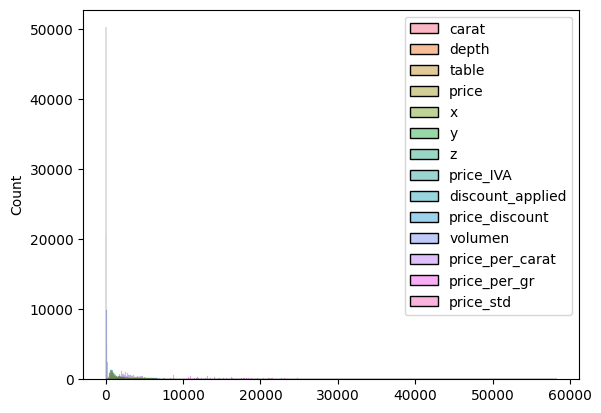

In [102]:
sns.histplot(df)

### 4.1.1. univariantes:


<Axes: ylabel='Density'>

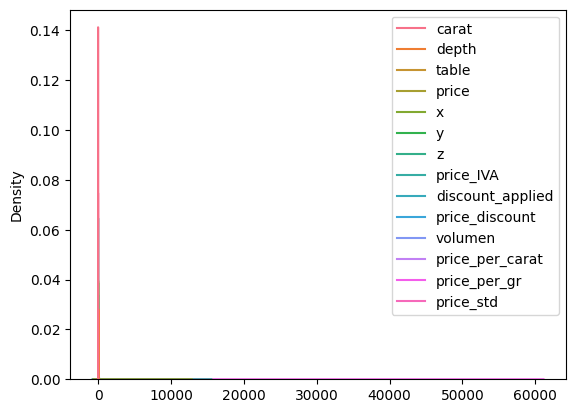

In [103]:
sns.kdeplot(df) #hay escalas diferentes en los datos, mejor filtar para alguna columna

<Axes: ylabel='Density'>

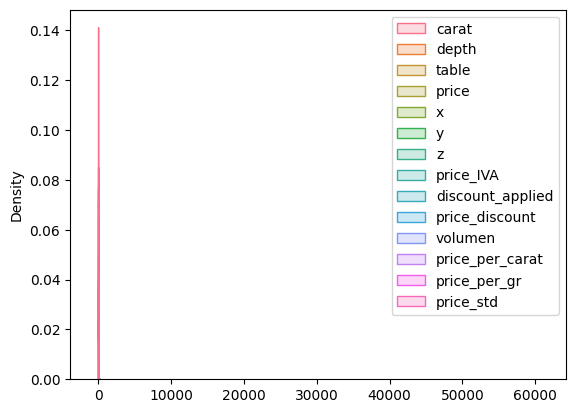

In [104]:
sns.kdeplot(df, fill=True, thresh=0.01, cbar=True)
# thresh controla el umbral de densidad a mostrar en el dibnujo, si es bajo muestra todas las zonas aunque haya pocos datos, y uno alto solo muestra las zonas de mayor densidad de puntos


####  4.1.1.1. histogramas y curvas de densidad


In [105]:
'''# Crear el histograma con KDE
plt.figure(figsize=(12, 6))
sns.histplot(data=df, x='price', bins=30, kde=True, color='blue', alpha=0.6)

# Configuración del gráfico
plt.title("Distribución de Precios", fontsize=14)
plt.xlabel("Precio", fontsize=12)
plt.ylabel("Frecuencia", fontsize=12)

# Agregar la leyenda
plt.legend(["Curva KDE", "Histograma de precios"], loc='upper right', fontsize=10)

# Mostrar la cuadrícula y el gráfico
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()'''


'# Crear el histograma con KDE\nplt.figure(figsize=(12, 6))\nsns.histplot(data=df, x=\'price\', bins=30, kde=True, color=\'blue\', alpha=0.6)\n\n# Configuración del gráfico\nplt.title("Distribución de Precios", fontsize=14)\nplt.xlabel("Precio", fontsize=12)\nplt.ylabel("Frecuencia", fontsize=12)\n\n# Agregar la leyenda\nplt.legend(["Curva KDE", "Histograma de precios"], loc=\'upper right\', fontsize=10)\n\n# Mostrar la cuadrícula y el gráfico\nplt.grid(axis=\'y\', linestyle=\'--\', alpha=0.7)\nplt.show()'

In [106]:
df.describe()

,carat,depth,table,price,x,y,z,price_IVA,discount_applied,price_discount,volumen,price_per_carat,price_per_gr,price_std
count,50269.000000,50269.000000,50269.000000,50269.000000,50269.000000,50269.000000,50269.000000,50269.000000,50269.000000,50269.000000,50269.000000,50269.000000,50269.000000,5.026900e+04
mean,0.723710,61.754433,57.422942,3160.682617,5.583874,5.587065,3.449430,3824.425537,3.100519,3103.107559,117.854136,3709.022461,18545.113281,-1.960886e-07
std,0.383487,1.428000,2.228492,2764.787354,0.992917,0.992279,0.627991,3345.392822,5.489041,2774.620705,61.959978,1663.332397,8316.662109,1.000010e+00
min,0.199951,43.000000,43.000000,326.000000,3.730000,3.680000,1.070000,394.460022,0.000000,293.400000,31.707984,1051.329956,5256.649902,-1.025291e+00
25%,0.379883,61.100000,56.000000,911.000000,4.670000,4.680000,2.880000,1102.310059,0.000000,857.650000,63.224400,2406.988525,12034.942383,-8.136991e-01
50%,0.700195,61.800000,57.000000,2159.000000,5.590000,5.580000,3.430000,2612.390137,0.000000,2074.000000,109.679427,3360.067871,16800.339844,-3.623036e-01
75%,1.009766,62.500000,59.000000,4670.000000,6.430000,6.420000,3.980000,5650.700195,10.000000,4539.000000,163.928314,4616.562012,23082.810547,5.459126e-01
max,3.650391,79.000000,79.000000,11886.000000,9.540000,31.800000,31.800000,14382.060547,15.000000,11886.000000,838.502400,11653.199219,58265.996094,3.155904e+00


Tenemos las columnas numéricas en el dataframe: Index(['carat', 'depth', 'table', 'price', 'x', 'y', 'z', 'price_IVA',
       'discount_applied', 'price_discount', 'volumen', 'price_per_carat',
       'price_per_gr', 'price_std'],
      dtype='object')
Tenemos 14 columnas numéricas
Tenemos 13 columnas numéricas con más de un valor único
3
5
El eje x del histograma de carat va desde 0.199951171875 hasta  3.650390625 con un ancho de columna 0.199951171875
El eje x del histograma de depth va desde 43.0 hasta  79.0 con un ancho de columna 43.0
El eje x del histograma de table va desde 43.0 hasta  79.0 con un ancho de columna 43.0
El eje x del histograma de price va desde 326.0 hasta  11886.0 con un ancho de columna 326.0
El eje x del histograma de x va desde 3.73 hasta  9.54 con un ancho de columna 3.73
El eje x del histograma de y va desde 3.68 hasta  31.8 con un ancho de columna 3.68
El eje x del histograma de z va desde 1.07 hasta  31.8 con un ancho de columna 1.07
El eje x del histogra

C:\Users\carol\AppData\Local\Temp\ipykernel_45876\2780393852.py:44: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


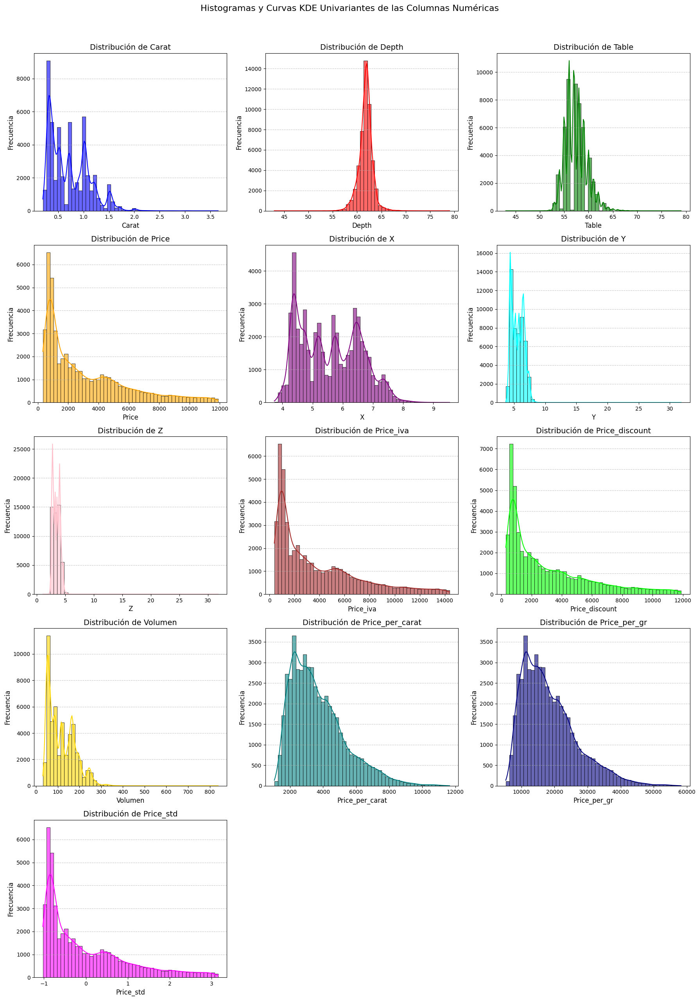

In [107]:
# Seleccionar las columnas numéricas del DataFrame
numerical_columns = df.select_dtypes(include=['float', 'int']).columns
print(f'Tenemos las columnas numéricas en el dataframe: {numerical_columns}')
print(f'Tenemos {len(numerical_columns)} columnas numéricas')

# Filtrar las columnas con más de 3 valores únicos, para no imprimir la columna del IVA, ni las de los descuentos
numerical_columns = [col for col in numerical_columns if df[col].nunique() > 3]
print(f'Tenemos {len(numerical_columns)} columnas numéricas con más de un valor único')

# Configurar la figura para varios subplots
n_cols = 3  # Número de columnas por fila
print(n_cols)
n_rows = (len(numerical_columns) + n_cols - 1) // n_cols  # Calcular el número de filas necesario
print(n_rows)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows), constrained_layout=True)
axes = axes.flatten()  # Aplanar el arreglo de ejes
# Lista de colores
colores = [
    "blue", "red", "green", "orange", "purple", "cyan", 
    "pink", "brown", "lime", "gold", "teal", "navy", 
    "magenta", "darkgreen", "salmon"
]
# Iterar sobre las columnas numéricas y generar los histogramas
for i, column in enumerate(numerical_columns):  
    ax = axes[i]  # Subplot correspondiente
    # Rango de valores para ajustar el ancho
    col_min, col_max = df[column].min(), df[column].max()
    bins = np.linspace(col_min, col_max, 50)  # Crear bins uniformemente distribuidos
    print(f'El eje x del histograma de {column} va desde {col_min} hasta  {col_max} con un ancho de columna {bins[0]}')
    # Usar colores de la lista (repetir si se acaban los colores)
    color = colores[i % len(colores)]  # Asignar color
    sns.histplot(data=df, x=column, bins=bins, kde=True, color=color, alpha=0.6, ax=ax)
    ax.set_title(f"Distribución de {column.capitalize()}", fontsize=14)
    ax.set_xlabel(column.capitalize(), fontsize=12)
    ax.set_ylabel("Frecuencia", fontsize=12)
    ax.grid(axis='y', linestyle='--', alpha=0.7)

# Ocultar subplots adicionales si sobran
for j in range(len(numerical_columns), len(axes)):
    fig.delaxes(axes[j])

# Ajustar el diseño
plt.suptitle("Histogramas y Curvas KDE Univariantes de las Columnas Numéricas", fontsize=16, y=1.02)
plt.tight_layout()
plt.show()


Las distribuciones de Precio, Precio con IVA, y Precio estandarizado tienen la misma forma exactamente, aunque tengan distintos valores en el eje x


La distribución del precio por quilate y del precio por grama, son idénticas.


Sería interesante ver qué ocurre con las variables:
- Carat
- medidas x, y, z y volumen
- tabla

Para entender porque hay tantos subgrupos. Tendrá que ver con las ténicas de tallado?

El gráfico de volumen tiene una larga cola hacia valores altos, sugiriendo algunos diamantes con volúmenes fuera del rango típico.


Tenemos las columnas numéricas en el dataframe: Index(['carat', 'depth', 'table', 'price', 'x', 'y', 'z', 'price_IVA',
       'discount_applied', 'price_discount', 'volumen', 'price_per_carat',
       'price_per_gr', 'price_std'],
      dtype='object')
Tenemos 14 columnas numéricas
Tenemos 14 columnas numéricas con más de un valor único


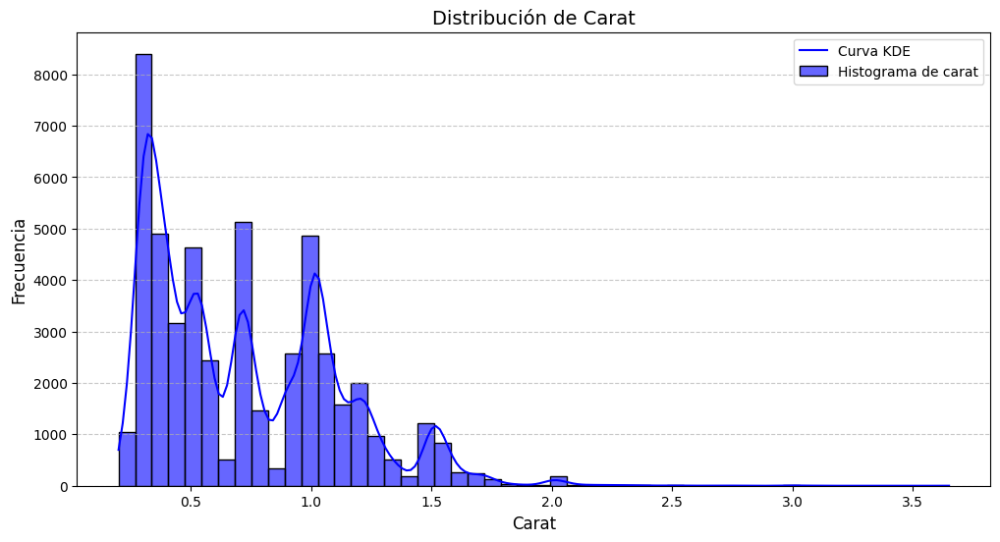

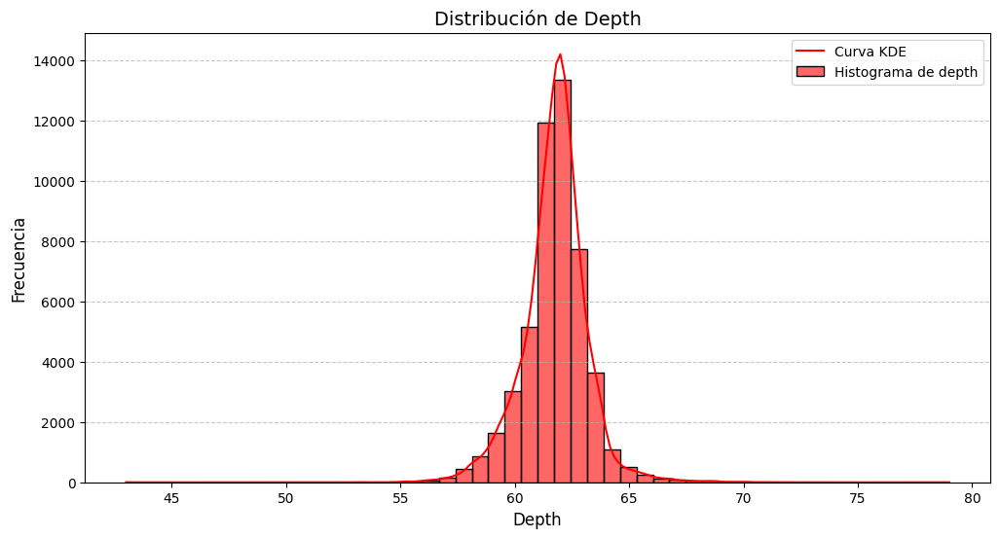

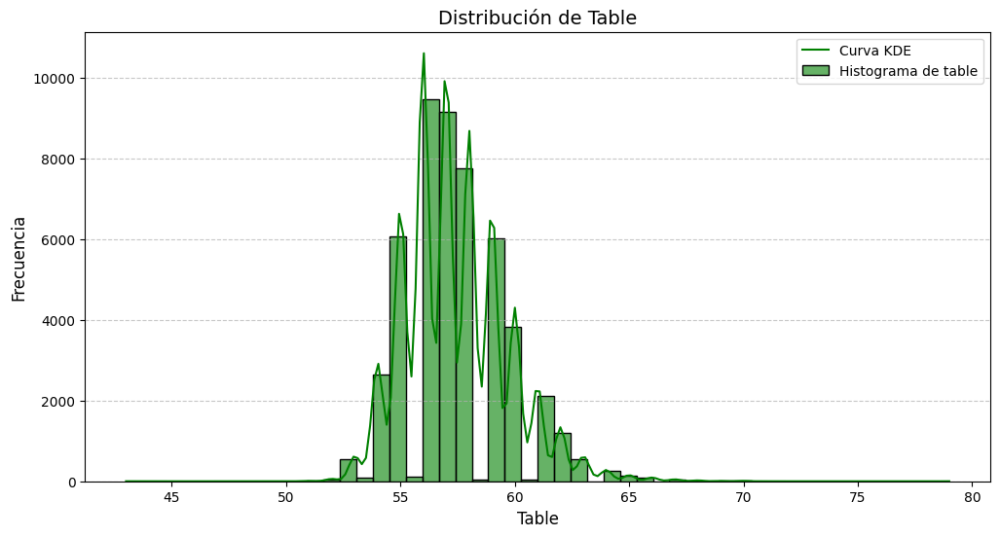

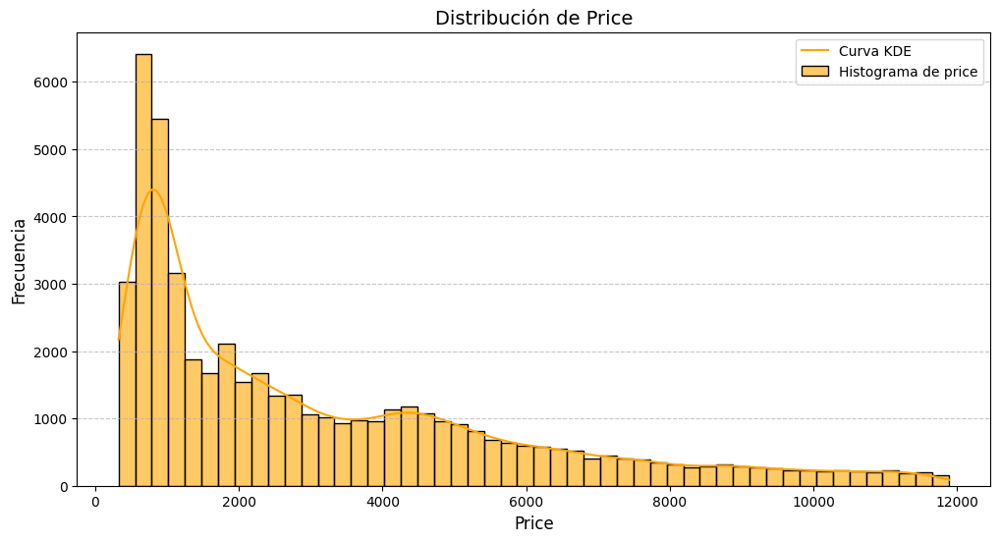

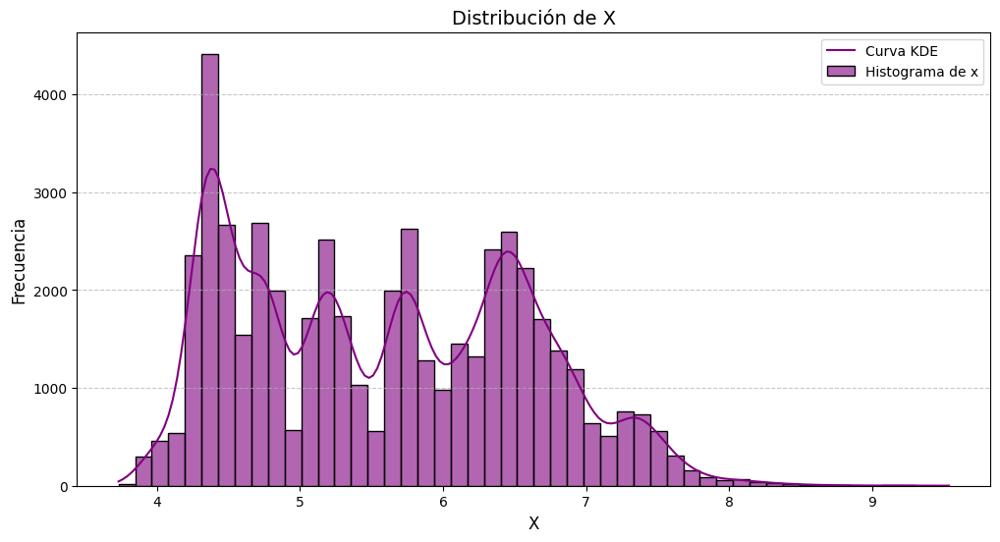

...

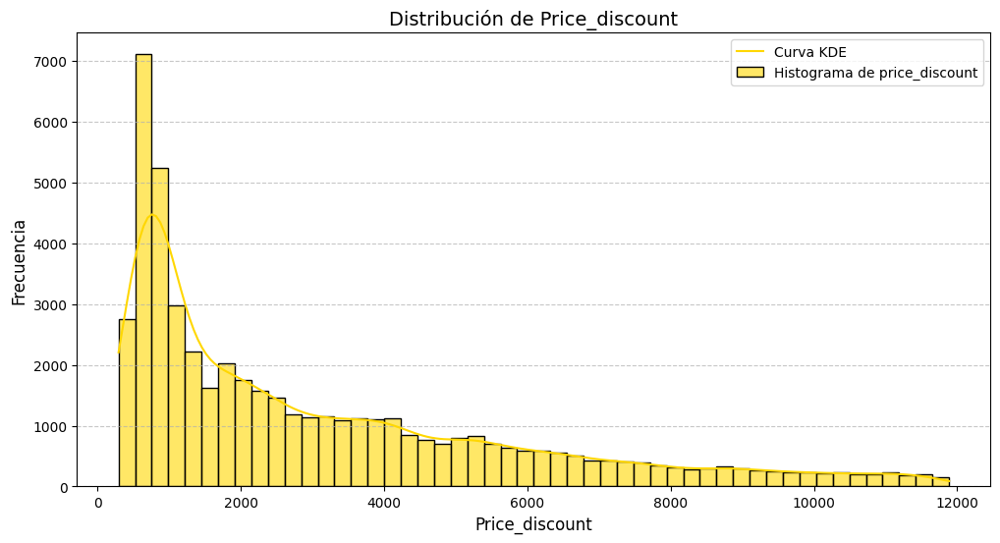

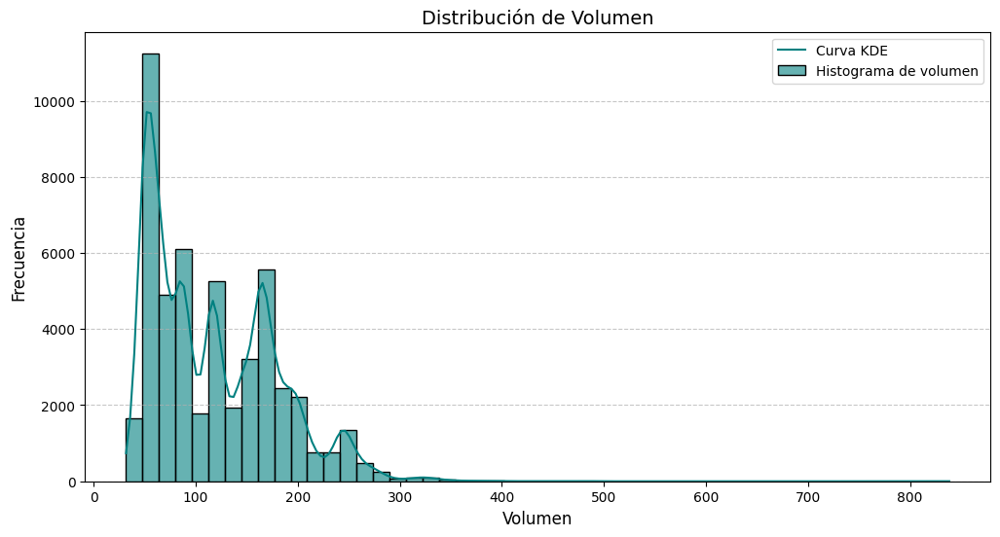

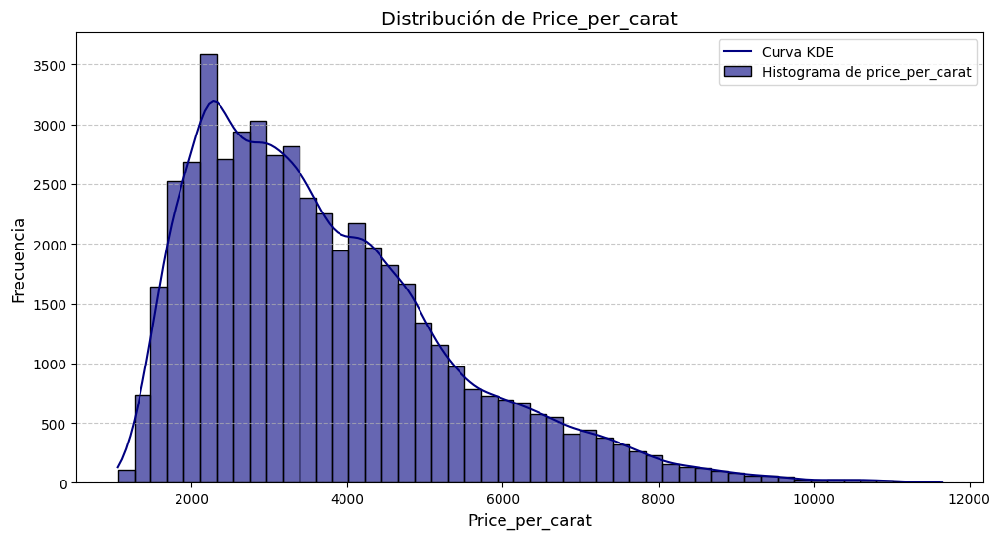

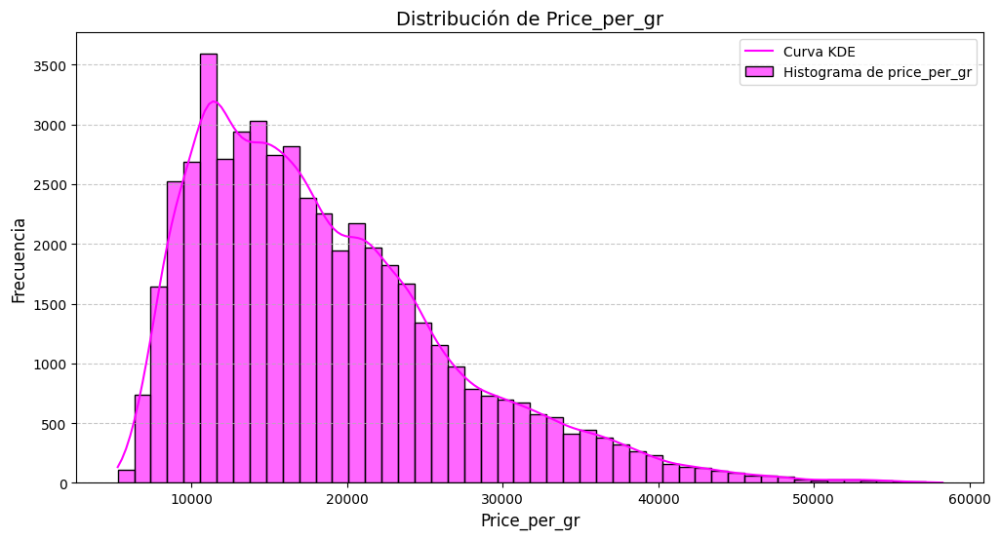

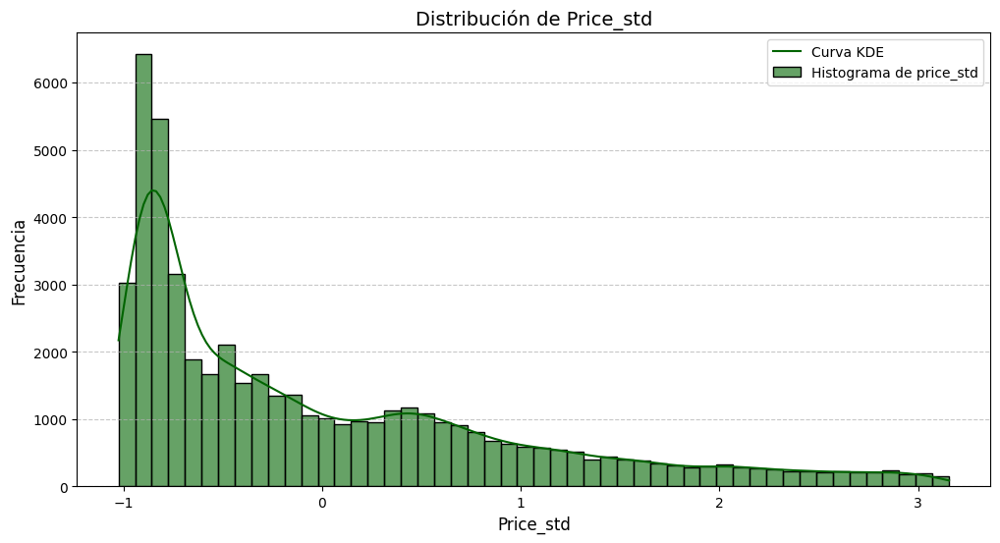

In [108]:
# Seleccionar las columnas numéricas del DataFrame
numerical_columns = df.select_dtypes(include=['float', 'int']).columns
print(f'Tenemos las columnas numéricas en el dataframe: {numerical_columns}')
print(f'Tenemos {len(numerical_columns)} columnas numéricas')

# Filtrar las columnas con más de un valor único
numerical_columns = [col for col in numerical_columns if df[col].nunique() > 1]
print(f'Tenemos {len(numerical_columns)} columnas numéricas con más de un valor único')

# Lista de colores
colores = [
    "blue", "red", "green", "orange", "purple", "cyan", 
    "pink", "brown", "lime", "gold", "teal", "navy", 
    "magenta", "darkgreen", "salmon"
]

# Iterar sobre las columnas numéricas y generar los histogramas
for i, column in enumerate(numerical_columns):
    # Crear una nueva figura para cada columna
    plt.figure(figsize=(12, 6))
    
    # Usar colores de la lista (repetir si se acaban los colores)
    color = colores[i % len(colores)]
    
    # Generar histograma con curva KDE
    sns.histplot(data=df, x=column, bins=50, kde=True, color=color, alpha=0.6)
    
    # Configuración del gráfico
    plt.title(f"Distribución de {column.capitalize()}", fontsize=14)
    plt.xlabel(column.capitalize(), fontsize=12)
    plt.ylabel("Frecuencia", fontsize=12)
    # Agregar la leyenda
    plt.legend(["Curva KDE", f"Histograma de {column}"], loc='upper right', fontsize=10)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    
    # Mostrar gráfico individual
    plt.show()


Las curvas con muchos picos ocurren debido a:

**Tamaño del Conjunto de Datos**:
   Si el conjunto de datos es grande (como en el caso del dataset de diamantes), el estimador de densidad KDE intenta capturar variaciones incluso en valores pequeños, resultando en muchos picos.

**Parámetro `bw_adjust` (Ancho de Banda)**:
   El ancho de banda determina lo suave o detallada que será la curva KDE. Por defecto, Seaborn elige un ancho de banda basado en el tamaño y distribución de los datos, pero si es muy pequeño, produce una curva demasiado detallada (con picos excesivos).

**Distribución de los Datos**:
   Si los datos tienen una gran cantidad de valores repetidos o están distribuidos de manera irregular, la KDE puede amplificar los picos correspondientes a estas concentraciones.

 Soluciones para Suavizar la Curva:
**Ajustar el Ancho de Banda (`bw_adjust`)**:
 
   sns.histplot(data=df, x='table', bins=50, kde=True, color='red', kde_kws={'bw_adjust': 1.5})

**Remover Outliers**:
   Si hay valores atípicos (outliers), estos pueden alterar la forma de la KDE. Filtrar de nuevo los datos antes de graficar.

**Usar una Aproximación Diferente**:
   Si los datos tienen muchos valores repetidos, podrías intentar representar las frecuencias de los valores únicos en lugar de usar una KDE.



<Axes: ylabel='Count'>

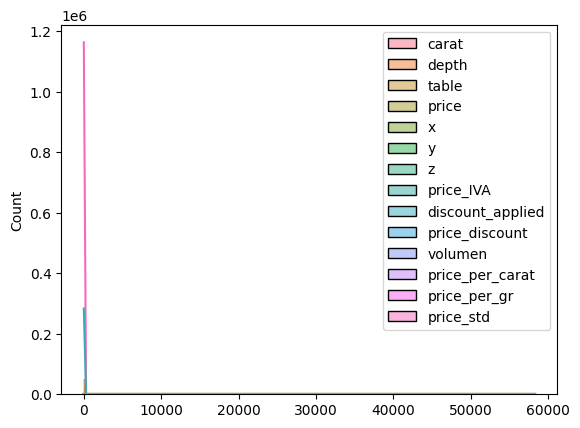

In [109]:
sns.histplot(df, kde=True)

No nos aporta información

In [110]:
# Recordemos las columnas categóricas que tenemos:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 50269 entries, 0 to 53939
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   carat                   50269 non-null  float32 
 1   cut                     50269 non-null  category
 2   color                   50269 non-null  category
 3   clarity                 50269 non-null  category
 4   depth                   50269 non-null  float64 
 5   table                   50269 non-null  float64 
 6   price                   50269 non-null  float32 
 7   x                       50269 non-null  float64 
 8   y                       50269 non-null  float64 
 9   z                       50269 non-null  float64 
 10  cut_int                 50269 non-null  category
 11  price_IVA               50269 non-null  float32 
 12  discount_applied        50269 non-null  int64   
 13  price_discount          50269 non-null  float64 
 14  volumen                 502

#### 4.1.1.2. boxplot

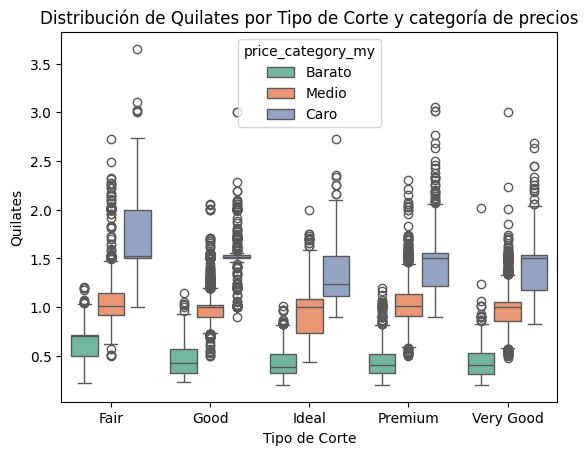

In [111]:
# Boxplot para la columna 'carat'
plt.figure()
sns.boxplot(df, x='cut', y='carat', hue='price_category_my', palette='Set2')
plt.title("Distribución de Quilates por Tipo de Corte y categoría de precios")
plt.xlabel("Tipo de Corte")
plt.ylabel("Quilates")
plt.show()

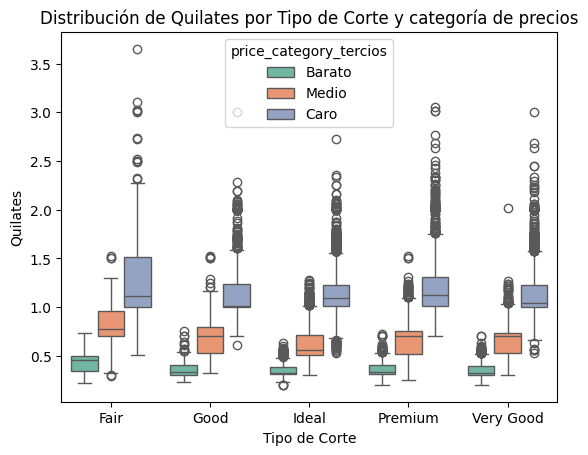

In [112]:
# Boxplot para la columna 'carat'
plt.figure()
sns.boxplot(df, x='cut', y='carat', hue='price_category_tercios', palette='Set2')
plt.title("Distribución de Quilates por Tipo de Corte y categoría de precios")
plt.xlabel("Tipo de Corte")
plt.ylabel("Quilates")
plt.show()

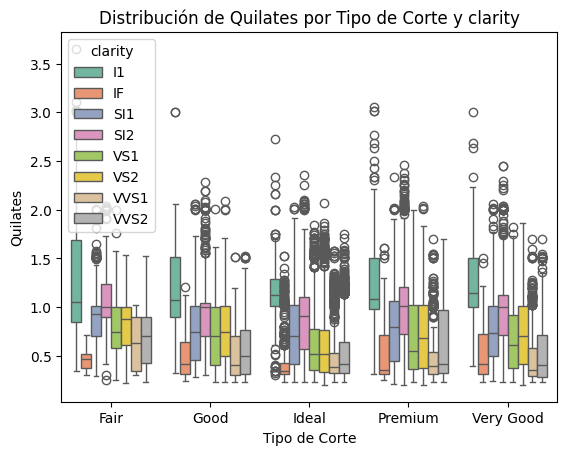

In [113]:
# Boxplot para la columna 'carat'
plt.figure()
sns.boxplot(df, x='cut', y='carat', hue='clarity', palette='Set2')
plt.title("Distribución de Quilates por Tipo de Corte y clarity")
plt.xlabel("Tipo de Corte")
plt.ylabel("Quilates")
plt.show()

Columnas categóricas: Index(['cut', 'color', 'clarity', 'cut_int', 'price_category_my',
       'price_category_tercios'],
      dtype='object')


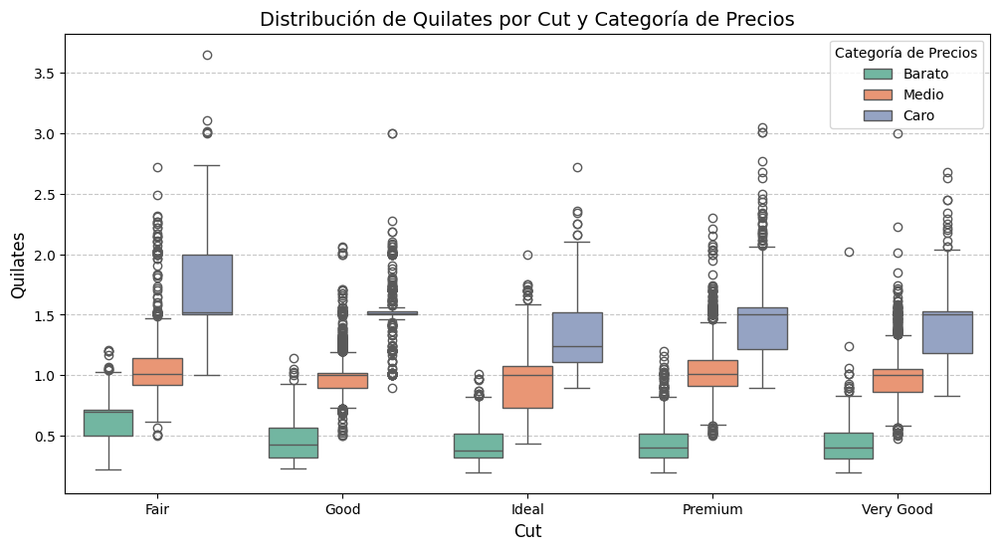

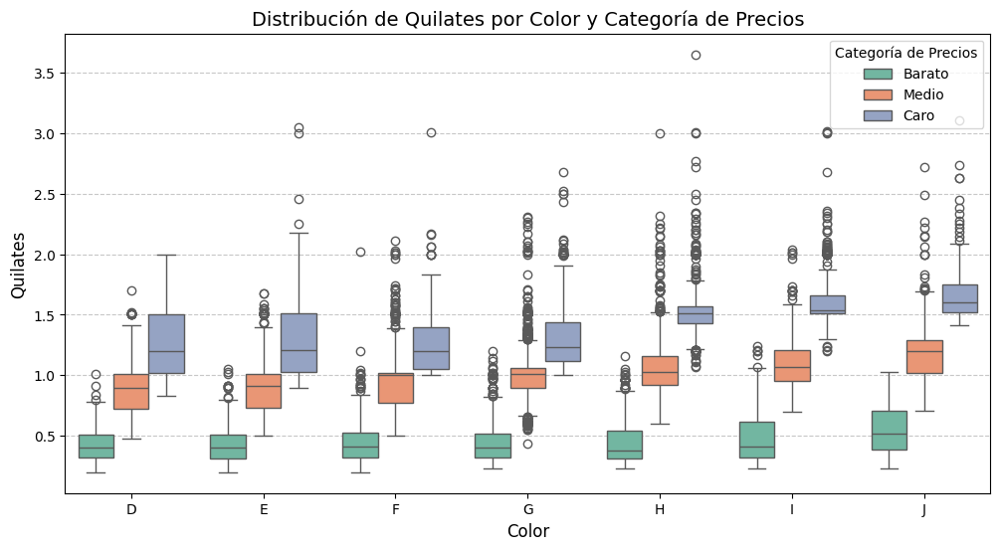

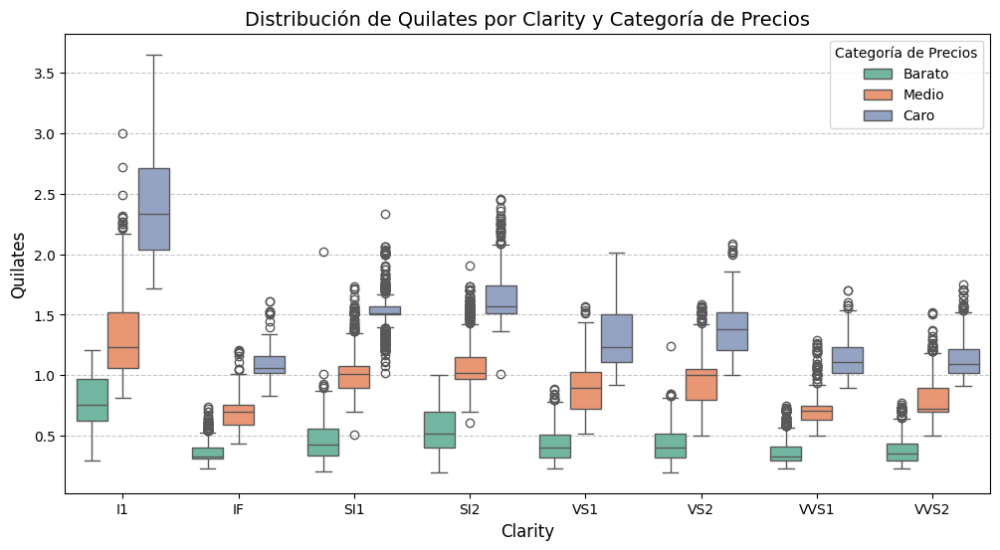

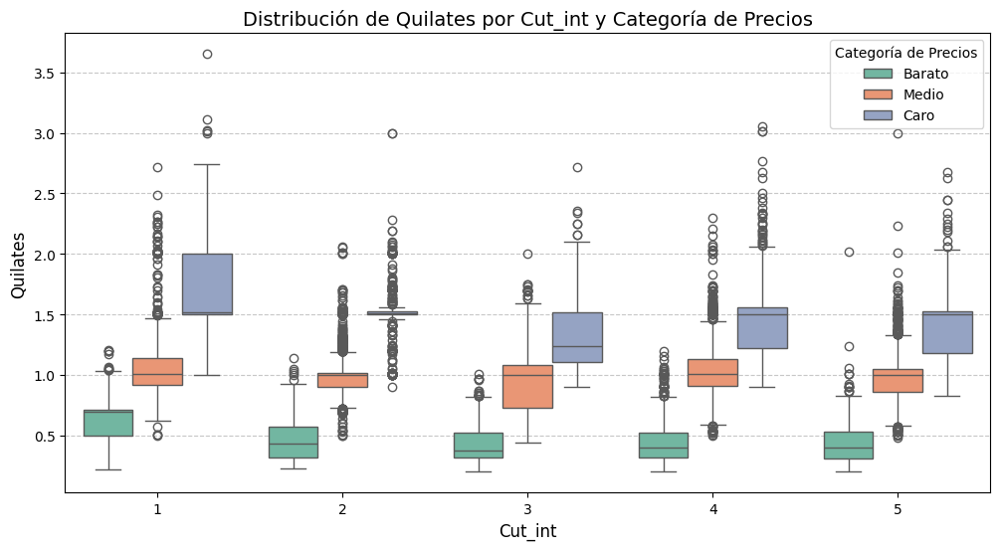

C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3824012176.py:16: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(title='Categoría de Precios', loc='upper right')


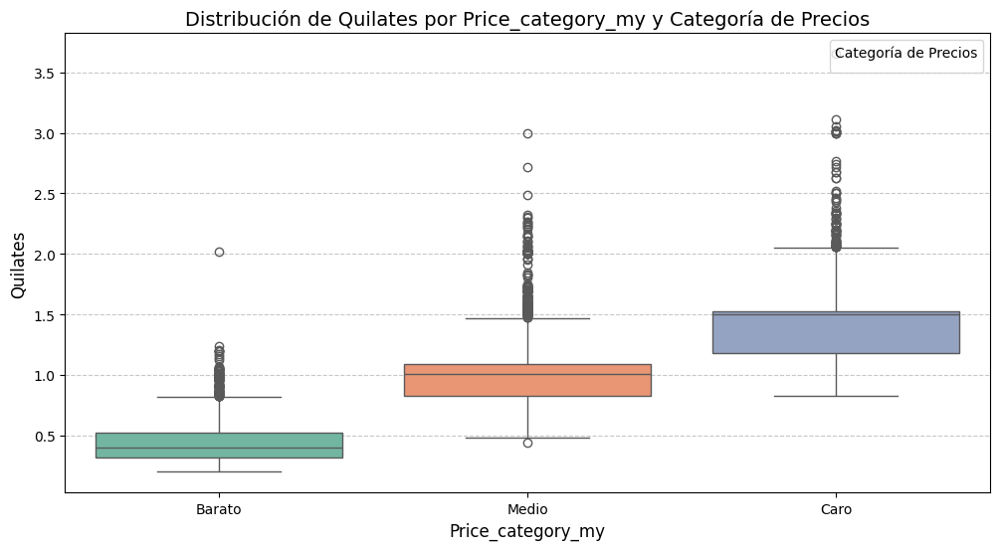

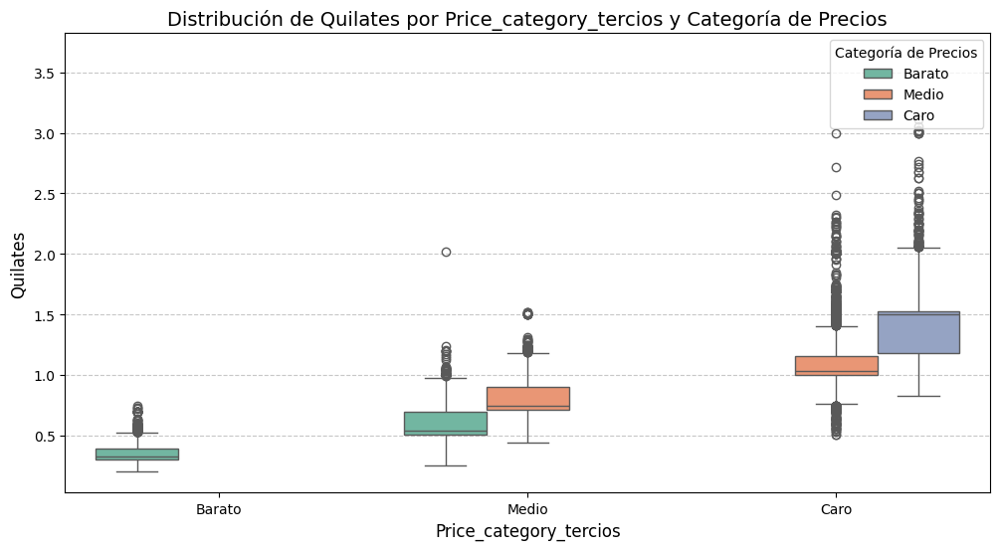

In [114]:
# Seleccionar columnas categóricas
categorical_columns = df.select_dtypes(include=['object', 'category']).columns
print(f'Columnas categóricas: {categorical_columns}')

# Iterar sobre las columnas categóricas y generar los boxplots
for col in categorical_columns:
    plt.figure(figsize=(12, 6))  # Ajustar el tamaño de cada figura
    sns.boxplot(data=df, x=col, y='carat', hue='price_category_my', palette='Set2')
    
    # Configurar título y etiquetas
    plt.title(f"Distribución de Quilates por {col.capitalize()} y Categoría de Precios", fontsize=14)
    plt.xlabel(col.capitalize(), fontsize=12)
    plt.ylabel("Quilates", fontsize=12)
    
    # Mostrar el gráfico
    plt.legend(title='Categoría de Precios', loc='upper right')
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.show()


In [115]:
'''# Obtener las columnas categóricas
categorical_columns = df.select_dtypes(include=['object', 'category']).columns
print(f"Columnas categóricas: {categorical_columns}")
print(f"Total de columnas categóricas: {len(categorical_columns)}")
# Configurar la figura para varios subplots
n_cols = 3  # Número de columnas por fila
print(n_cols)
#n_rows = ((len(categorical_columns))^2 + n_cols - 1) // n_cols  # Calcular el número de filas necesario
n_rows=20
print(n_rows)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows), constrained_layout=True)
axes = axes.flatten()  # Aplanar el arreglo de ejes
# Iterar sobre pares de columnas categóricas
for i, x_col in enumerate(categorical_columns):
    for y_col in enumerate(categorical_columns):
        for hue_col in categorical_columns:
            if (x_col != hue_col) & (x_col != y_col) & (y_col != hue_col):  # Evitar comparar la misma columna consigo misma
                ax = axes[i]
                #plt.figure(figsize=(12, 6))
                sns.boxplot(data=df, x=x_col, y=y_col, hue=hue_col, palette='Set2', ax=ax)
                ax.set_title(f"Distribución de {column.capitalize()}", fontsize=14)
                ax.set_xlabel(column.capitalize(), fontsize=12)
                ax.set_ylabel(y_col, fontsize=12)
                ax.grid(axis='y', linestyle='--', alpha=0.7)
  
  
                #plt.title(f"Distribución de {y_col}: {x_col} vs {hue_col}", fontsize=14)
                #plt.xlabel(x_col.capitalize(), fontsize=12)
                #plt.ylabel(y_col, fontsize=12)
                #plt.legend(title=hue_col.capitalize(), loc='upper right')
                plt.grid(axis='y', linestyle='--', alpha=0.7)
                
                
    
    #ax = axes[i]  # Subplot correspondiente

    #sns.histplot(data=df, x=column, bins=bins, kde=True, color=color, alpha=0.6, ax=ax)
    #ax.set_title(f"Distribución de {column.capitalize()}", fontsize=14)
    #ax.set_xlabel(column.capitalize(), fontsize=12)
    #ax.set_ylabel("Frecuencia", fontsize=12)
    #ax.grid(axis='y', linestyle='--', alpha=0.7)

# Ocultar subplots adicionales si sobran
for j in range(len(numerical_columns), len(axes)):
    fig.delaxes(axes[j])
               
plt.show()'''



'# Obtener las columnas categóricas\ncategorical_columns = df.select_dtypes(include=[\'object\', \'category\']).columns\nprint(f"Columnas categóricas: {categorical_columns}")\nprint(f"Total de columnas categóricas: {len(categorical_columns)}")\n# Configurar la figura para varios subplots\nn_cols = 3  # Número de columnas por fila\nprint(n_cols)\n#n_rows = ((len(categorical_columns))^2 + n_cols - 1) // n_cols  # Calcular el número de filas necesario\nn_rows=20\nprint(n_rows)\nfig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows), constrained_layout=True)\naxes = axes.flatten()  # Aplanar el arreglo de ejes\n# Iterar sobre pares de columnas categóricas\nfor i, x_col in enumerate(categorical_columns):\n    for y_col in enumerate(categorical_columns):\n        for hue_col in categorical_columns:\n            if (x_col != hue_col) & (x_col != y_col) & (y_col != hue_col):  # Evitar comparar la misma columna consigo misma\n                ax = axes[i]\n                #plt.figure(

Columnas categóricas: Index(['cut', 'color', 'clarity', 'cut_int', 'price_category_my',
       'price_category_tercios'],
      dtype='object')
Total de columnas categóricas: 6
Total de combinaciones generadas: 120
Filas necesarias: 40, Columnas: 3


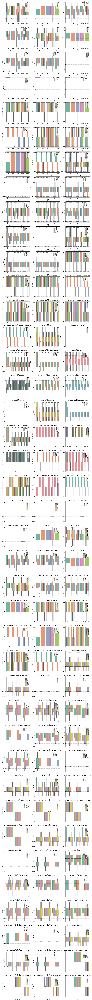

In [116]:
# Obtener las columnas categóricas
categorical_columns = df.select_dtypes(include=['object', 'category']).columns
print(f"Columnas categóricas: {categorical_columns}")
print(f"Total de columnas categóricas: {len(categorical_columns)}")

# Generar combinaciones únicas de columnas categóricas manualmente
combinations = []
for x_col in categorical_columns:
    for y_col in categorical_columns:
        for hue_col in categorical_columns:
            if x_col != y_col and x_col != hue_col and y_col != hue_col:
                combinations.append((x_col, y_col, hue_col))

print(f"Total de combinaciones generadas: {len(combinations)}")

# Configurar subplots
n_cols = 3  # Número de columnas por fila
n_rows = (len(combinations) + n_cols - 1) // n_cols  # Calcular el número de filas necesario
print(f"Filas necesarias: {n_rows}, Columnas: {n_cols}")
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows), constrained_layout=True)
axes = axes.flatten()  # Aplanar el arreglo de ejes

# Iterar sobre las combinaciones y generar los gráficos
for idx, (x_col, y_col, hue_col) in enumerate(combinations):
    ax = axes[idx]  # Subplot correspondiente
    
    # Crear el boxplot
    sns.boxplot(data=df, x=x_col, y=y_col, hue=hue_col, palette='Set2', ax=ax)
    
    # Configurar el título y etiquetas
    ax.set_title(f"{y_col} por {x_col} con {hue_col}", fontsize=14)
    ax.set_xlabel(x_col.capitalize(), fontsize=12)
    ax.set_ylabel(y_col.capitalize(), fontsize=12)
    ax.legend(title=hue_col.capitalize(), loc='upper right')
    ax.grid(axis='y', linestyle='--', alpha=0.7)

# Ocultar subplots adicionales si sobran
for j in range(len(combinations), len(axes)):
    fig.delaxes(axes[j])

# Mostrar los gráficos
plt.show()


Columnas categóricas: Index(['cut', 'color', 'clarity', 'cut_int', 'price_category_my',
       'price_category_tercios'],
      dtype='object')
Total de columnas categóricas: 6
Total de combinaciones generadas: 120
Generando gráficos para cut...
Gráfico guardado como: boxplot_cut.png


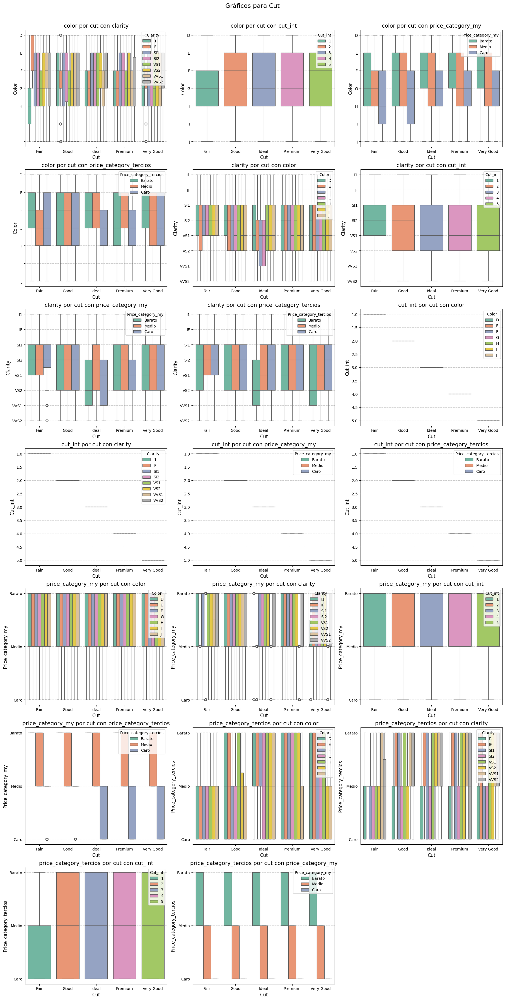

Generando gráficos para color...
Gráfico guardado como: boxplot_color.png


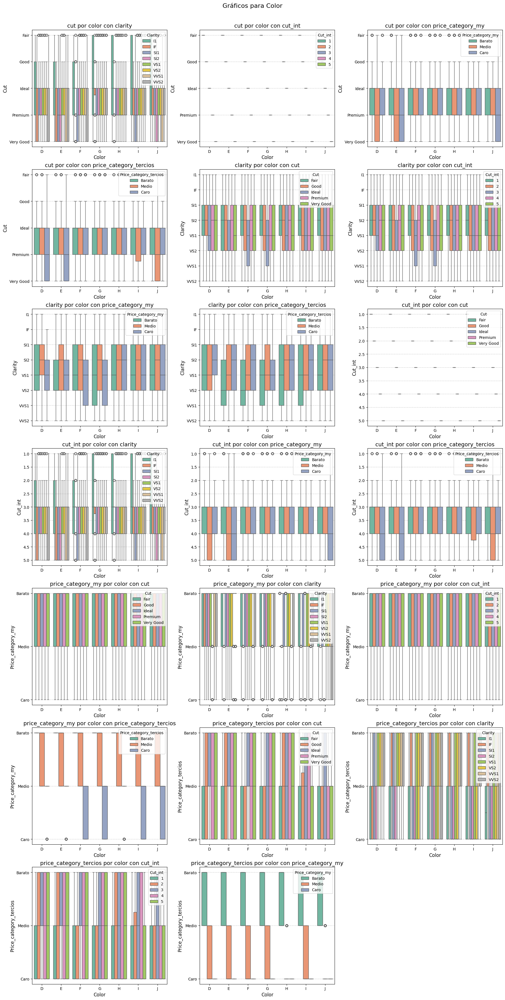

Generando gráficos para clarity...
Gráfico guardado como: boxplot_clarity.png


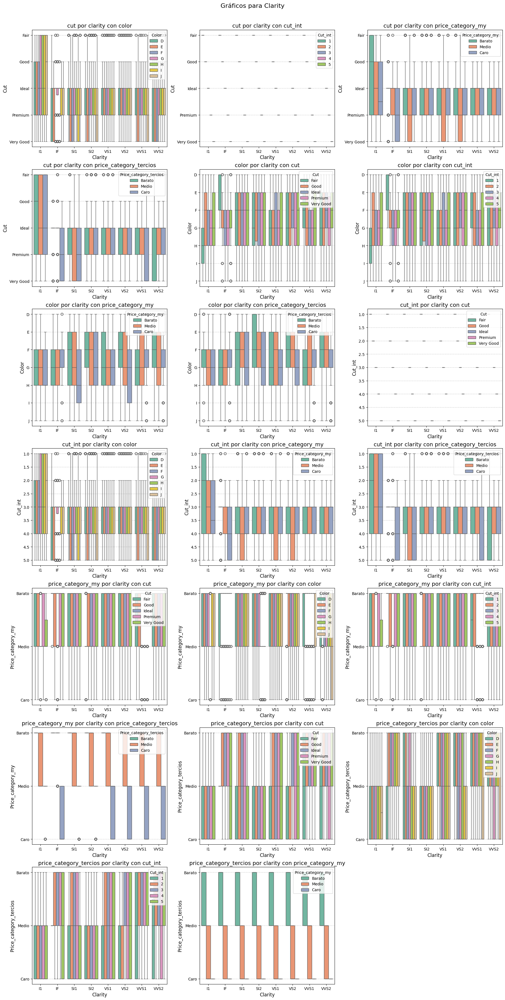

Generando gráficos para cut_int...
Gráfico guardado como: boxplot_cut_int.png


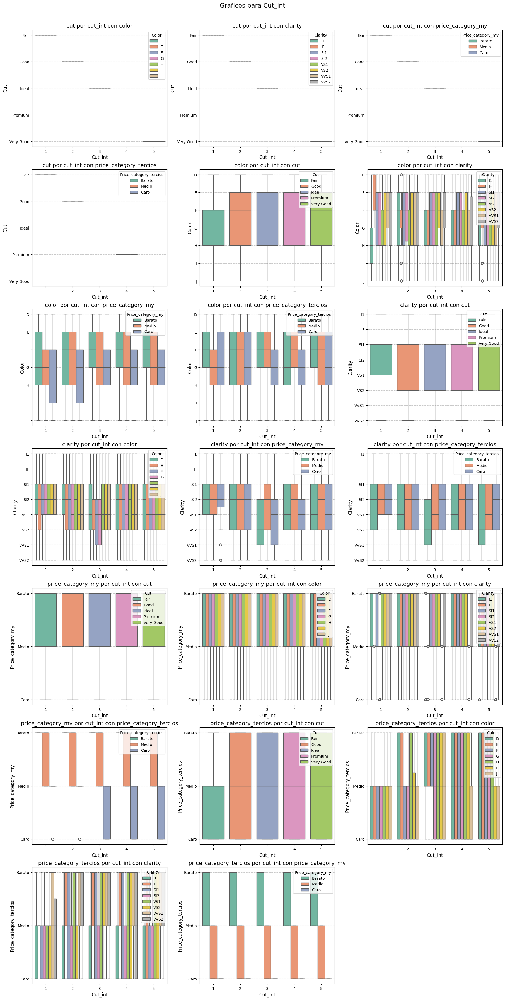

Generando gráficos para price_category_my...
Gráfico guardado como: boxplot_price_category_my.png


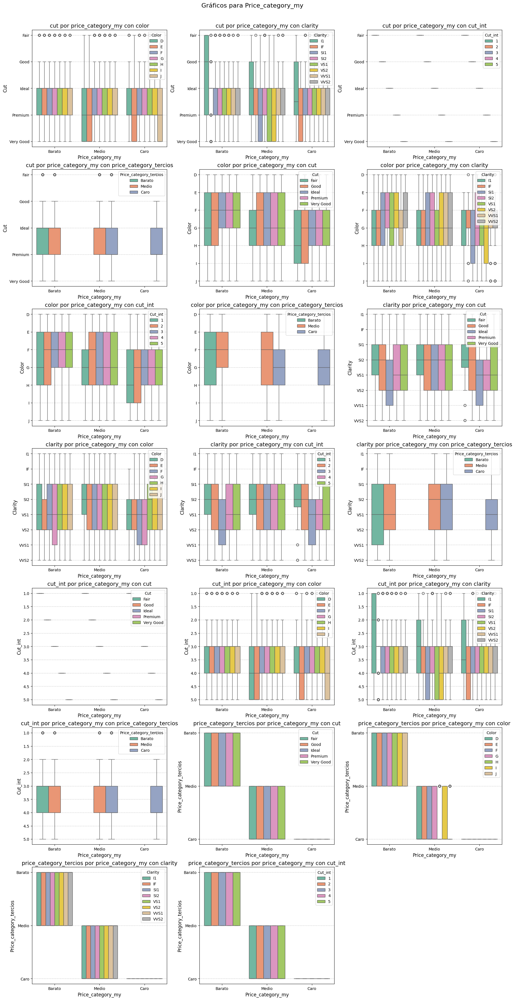

Generando gráficos para price_category_tercios...
Gráfico guardado como: boxplot_price_category_tercios.png


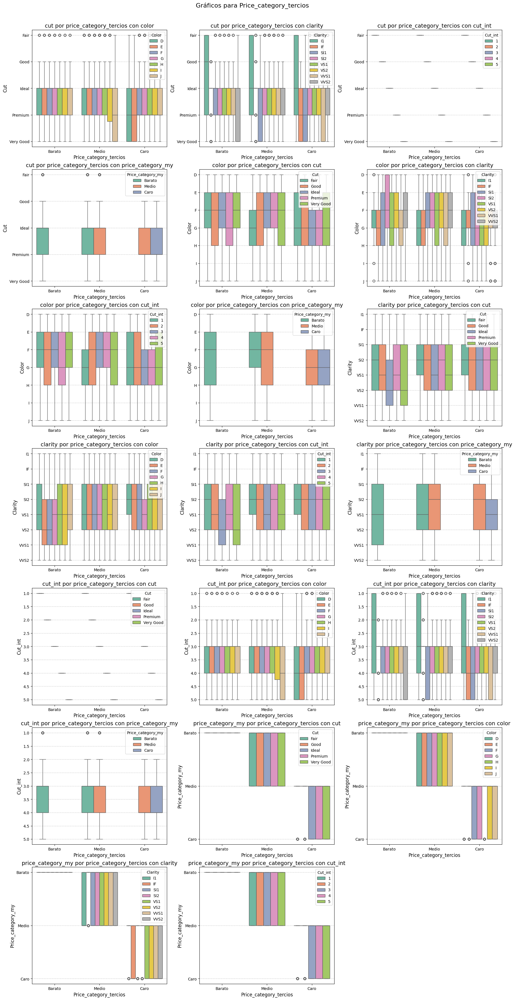

In [117]:
# Obtener las columnas categóricas
categorical_columns = df.select_dtypes(include=['object', 'category']).columns
print(f"Columnas categóricas: {categorical_columns}")
print(f"Total de columnas categóricas: {len(categorical_columns)}")

# Generar combinaciones únicas manualmente
combinations = []
for x_col in categorical_columns:
    for y_col in categorical_columns:
        for hue_col in categorical_columns:
            if x_col != y_col and x_col != hue_col and y_col != hue_col:
                combinations.append((x_col, y_col, hue_col))

print(f"Total de combinaciones generadas: {len(combinations)}")

# Agrupar combinaciones por x_col
grouped_combinations = {}
for x_col, y_col, hue_col in combinations:
    if x_col not in grouped_combinations:
        grouped_combinations[x_col] = []
    grouped_combinations[x_col].append((y_col, hue_col))

# Generar figuras separadas por x_col
for x_col, group in grouped_combinations.items():
    print(f"Generando gráficos para {x_col}...")
    
    n_cols = 3  # Número de columnas por fila
    n_rows = (len(group) + n_cols - 1) // n_cols  # Calcular el número de filas necesario
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows), constrained_layout=True)
    axes = axes.flatten()  # Aplanar el arreglo de ejes
    
    for idx, (y_col, hue_col) in enumerate(group):
        ax = axes[idx]
        
        # Crear el boxplot
        sns.boxplot(data=df, x=x_col, y=y_col, hue=hue_col, palette='Set2', ax=ax)
        
        # Configurar el título y etiquetas
        ax.set_title(f"{y_col} por {x_col} con {hue_col}", fontsize=14)
        ax.set_xlabel(x_col.capitalize(), fontsize=12)
        ax.set_ylabel(y_col.capitalize(), fontsize=12)
        ax.legend(title=hue_col.capitalize(), loc='upper right')
        ax.grid(axis='y', linestyle='--', alpha=0.7)
    
    # Ocultar subplots adicionales si sobran
    for j in range(len(group), len(axes)):
        fig.delaxes(axes[j])
    
    # Guardar la figura como archivo
    filename = f"boxplot_{x_col}.png"
    plt.suptitle(f"Gráficos para {x_col.capitalize()}", fontsize=16, y=1.02)
    plt.savefig(filename, dpi=300, bbox_inches="tight")
    print(f"Gráfico guardado como: {filename}")
   
    # Mostrar la figura
    plt.suptitle(f"Gráficos para {x_col.capitalize()}", fontsize=16, y=1.02)
    plt.show()
  


####  4.1.1.3. countplot

cuenta por categorías



C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3373207001.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x='cut', palette='pastel')


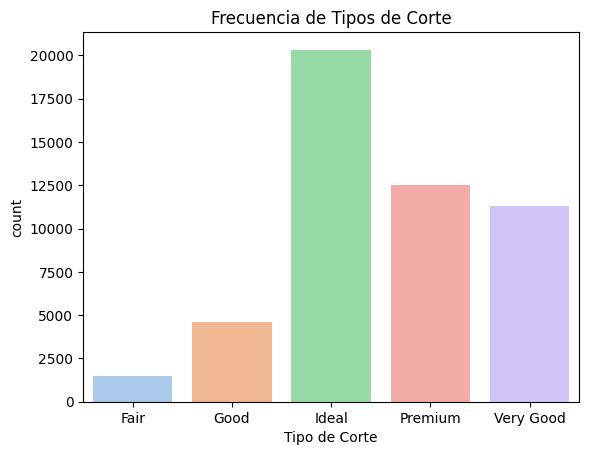

In [118]:
# Countplot para la columna 'cut'
plt.figure()
sns.countplot(data=df, x='cut', palette='pastel')
plt.title("Frecuencia de Tipos de Corte")
plt.xlabel("Tipo de Corte")
plt.ylabel("count")
plt.show()

C:\Users\carol\AppData\Local\Temp\ipykernel_45876\2679932707.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x=column, palette='pastel', ax=ax)


Columnas categóricas: ['cut', 'color', 'clarity', 'price_category_my', 'price_category_tercios']
Total de columnas categóricas: 5


C:\Users\carol\AppData\Local\Temp\ipykernel_45876\2679932707.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x=column, palette='pastel', ax=ax)
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\2679932707.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x=column, palette='pastel', ax=ax)
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\2679932707.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x=column, palette='pastel', ax=ax)
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\2679932707.py:18:

Gráfico guardado como: countplot.png


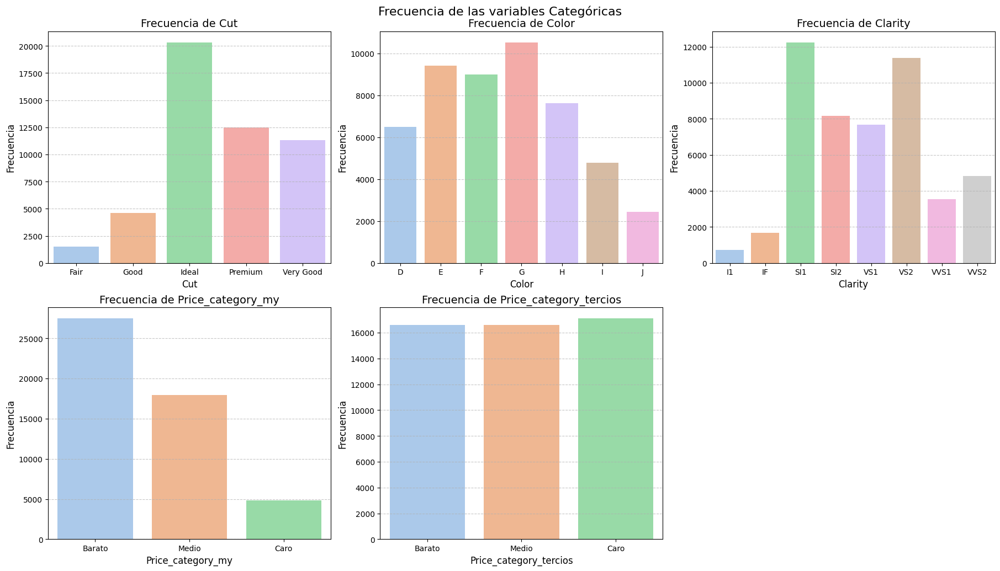

In [119]:
# Obtener las columnas categóricas excluyendo 'cut_int'
categorical_columns = df.select_dtypes(include=['object', 'category']).columns
categorical_columns = [col for col in categorical_columns if col != 'cut_int']
print(f"Columnas categóricas: {categorical_columns}")
print(f"Total de columnas categóricas: {len(categorical_columns)}")

# Configurar la figura para varios subplots
n_cols = 3  # Número de columnas por fila
n_rows = (len(categorical_columns) + n_cols - 1) // n_cols  # Calcular el número de filas necesario
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows), constrained_layout=True)
axes = axes.flatten()  # Aplanar el arreglo de ejes

# Iterar sobre las columnas categóricas y generar countplots
for idx, column in enumerate(categorical_columns):
    ax = axes[idx]
    
    # Crear el gráfico
    sns.countplot(data=df, x=column, palette='pastel', ax=ax)
    
    # Configuración del gráfico
    ax.set_title(f"Frecuencia de {column.capitalize()}", fontsize=14)
    ax.set_xlabel(column.capitalize(), fontsize=12)
    ax.set_ylabel("Frecuencia", fontsize=12)
    ax.grid(axis='y', linestyle='--', alpha=0.7)

# Ocultar subplots adicionales si sobran
for j in range(len(categorical_columns), len(axes)):
    fig.delaxes(axes[j])


# Guardar la figura como archivo
filename = f"countplot.png"
plt.savefig(filename, dpi=300, bbox_inches="tight")
print(f"Gráfico guardado como: {filename}")

# Mostrar la figura
plt.suptitle("Frecuencia de las variables Categóricas", fontsize=16, y=1.02)
plt.show()


C:\Users\carol\AppData\Local\Temp\ipykernel_45876\1122876652.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x='cut', order=order, palette='pastel')


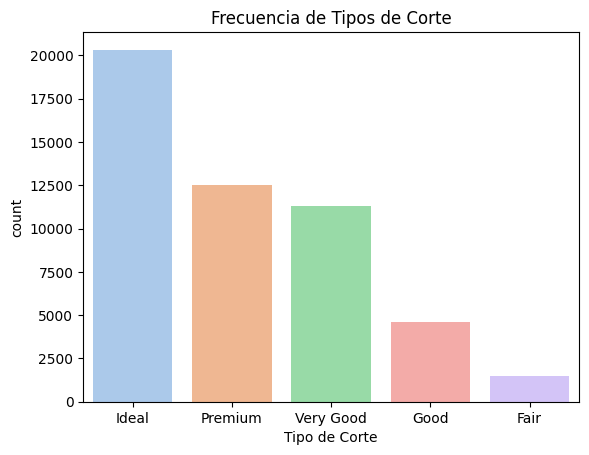

In [120]:
# Para ordenar por cantidad en cada barra
order = df['cut'].value_counts().index 
plt.figure()
sns.countplot(data=df, x='cut', order=order, palette='pastel')
plt.title("Frecuencia de Tipos de Corte")
plt.xlabel("Tipo de Corte")
plt.ylabel("count")
plt.show()

Columnas categóricas: ['cut', 'color', 'clarity', 'price_category_my', 'price_category_tercios']
Total de columnas categóricas: 5


C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3873124403.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x=column, order=order, palette='pastel', ax=ax)
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3873124403.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x=column, order=order, palette='pastel', ax=ax)
C:\Users\carol\AppData\Local\Temp\ipykernel_45876\3873124403.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x=column, order=order, palette='pastel', ax=ax)
C:\Users\carol\AppData\Local

Gráfico guardado como: countplot_orden.png


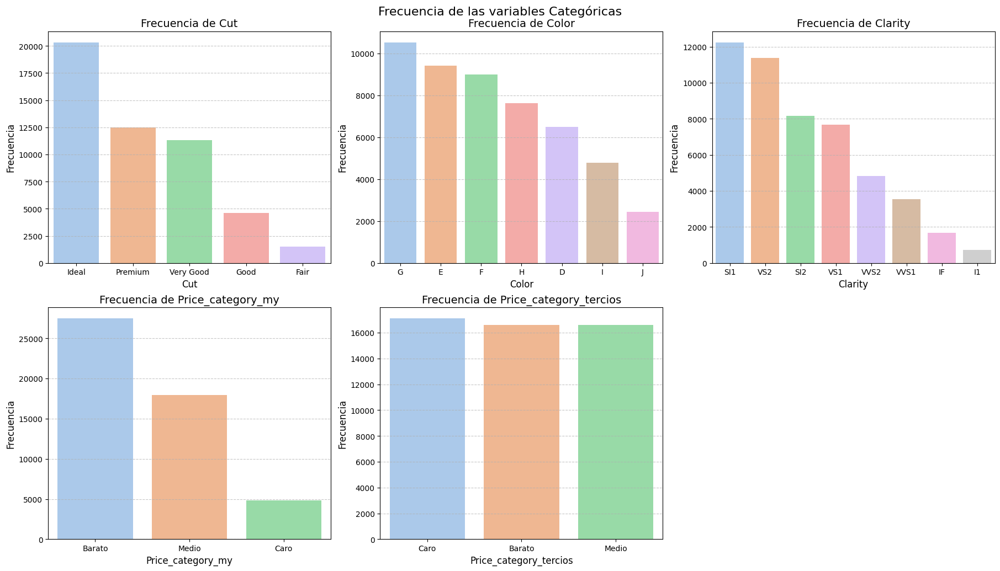

In [121]:
# Obtener las columnas categóricas excluyendo 'cut_int'
categorical_columns = df.select_dtypes(include=['object', 'category']).columns
categorical_columns = [col for col in categorical_columns if col != 'cut_int']
print(f"Columnas categóricas: {categorical_columns}")
print(f"Total de columnas categóricas: {len(categorical_columns)}")

# Configurar la figura para varios subplots
n_cols = 3  # Número de columnas por fila
n_rows = (len(categorical_columns) + n_cols - 1) // n_cols  # Calcular el número de filas necesario
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows), constrained_layout=True)
axes = axes.flatten()  # Aplanar el arreglo de ejes

# Iterar sobre las columnas categóricas y generar countplots
for idx, column in enumerate(categorical_columns):
    ax = axes[idx]
    order = df[column].value_counts().index 
    # Crear el gráfico
    sns.countplot(data=df, x=column, order=order, palette='pastel', ax=ax)    
    # Configuración del gráfico
    ax.set_title(f"Frecuencia de {column.capitalize()}", fontsize=14)
    ax.set_xlabel(column.capitalize(), fontsize=12)
    ax.set_ylabel("Frecuencia", fontsize=12)
    ax.grid(axis='y', linestyle='--', alpha=0.7)

# Ocultar subplots adicionales si sobran
for j in range(len(categorical_columns), len(axes)):
    fig.delaxes(axes[j])


# Guardar la figura como archivo
filename = f"countplot_orden.png"
plt.savefig(filename, dpi=300, bbox_inches="tight")
print(f"Gráfico guardado como: {filename}")

# Mostrar la figura
plt.suptitle("Frecuencia de las variables Categóricas", fontsize=16, y=1.02)
plt.show()


### 4.1.2. bivariantes y multivariantes


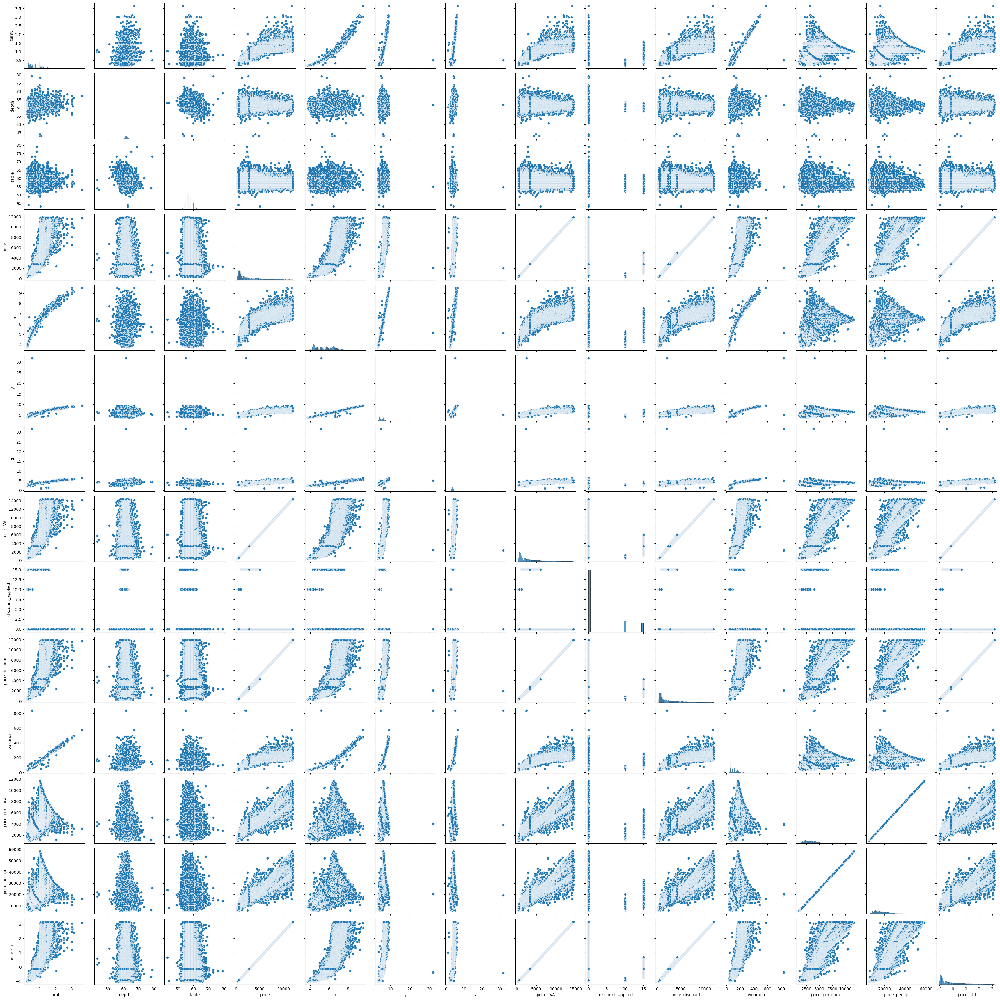

In [122]:
# alternativa para mostrar todos los scatterplots de todas las combinaciones dos a dos: 
# CUIDADO: se lleva muca potencia de computación, mejor usar .sample() si hay muchas filas
# Una idea es hacer ptimero el pairplot y luego enfocarse en aquellas compbinaciones que sean interesantes para hacer los scatterplot
sns.pairplot(df)
#sns.pairplot(df, vars=['HP', 'Attack', 'Defense'], hue='Legendary')

<Axes: >

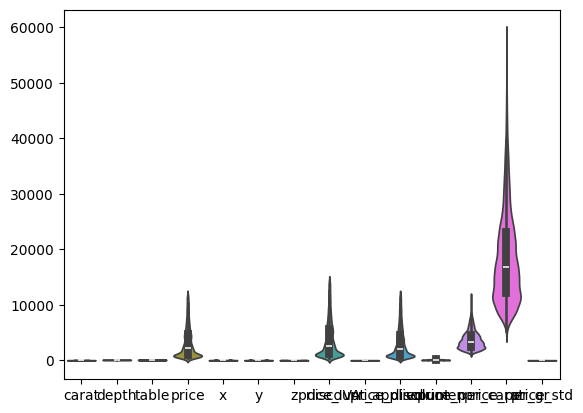

In [123]:
#sns.violinplot(x=df['Legendary'], y=df['Attack'])
sns.violinplot(df)

Columnas categóricas: Index(['cut', 'color', 'clarity', 'cut_int', 'price_category_my',
       'price_category_tercios'],
      dtype='object')
Total de columnas categóricas: 6
Total de combinaciones generadas: 120
Generando gráficos para cut...
Figura guardada como violinplots_cut.png


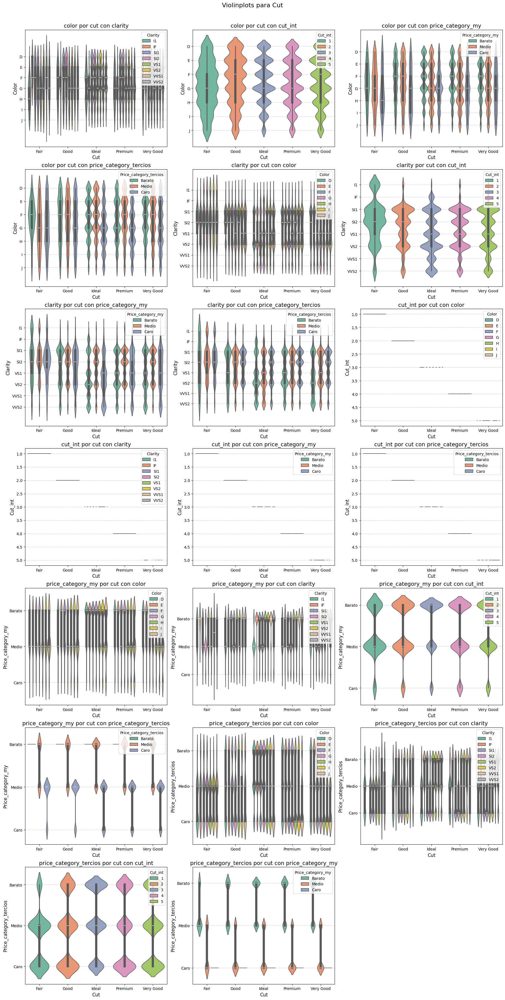

Generando gráficos para color...
Figura guardada como violinplots_color.png


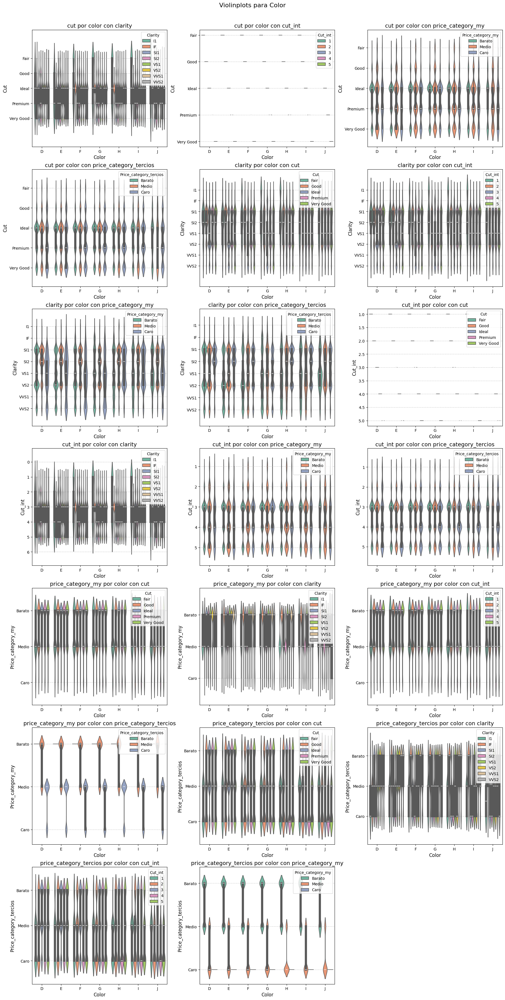

Generando gráficos para clarity...
Figura guardada como violinplots_clarity.png


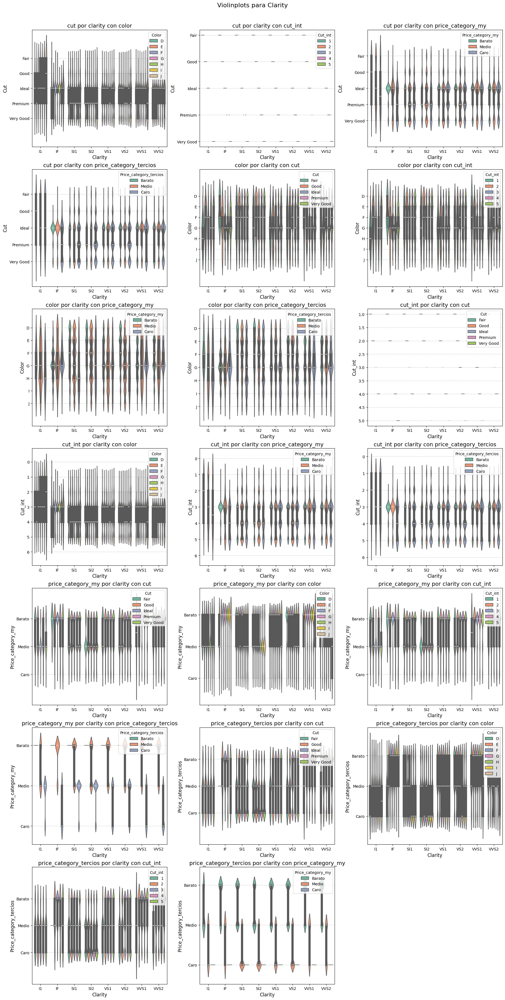

Generando gráficos para cut_int...
Figura guardada como violinplots_cut_int.png


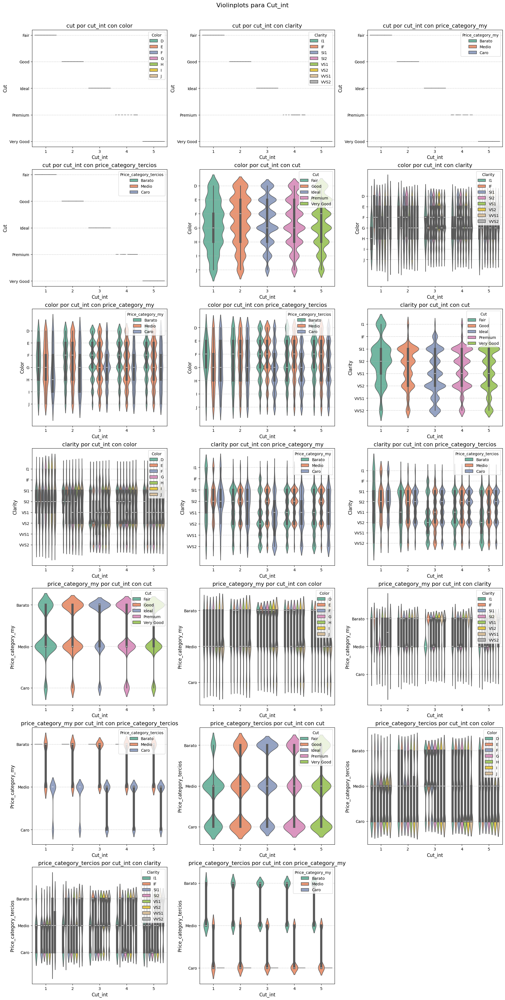

Generando gráficos para price_category_my...
Figura guardada como violinplots_price_category_my.png


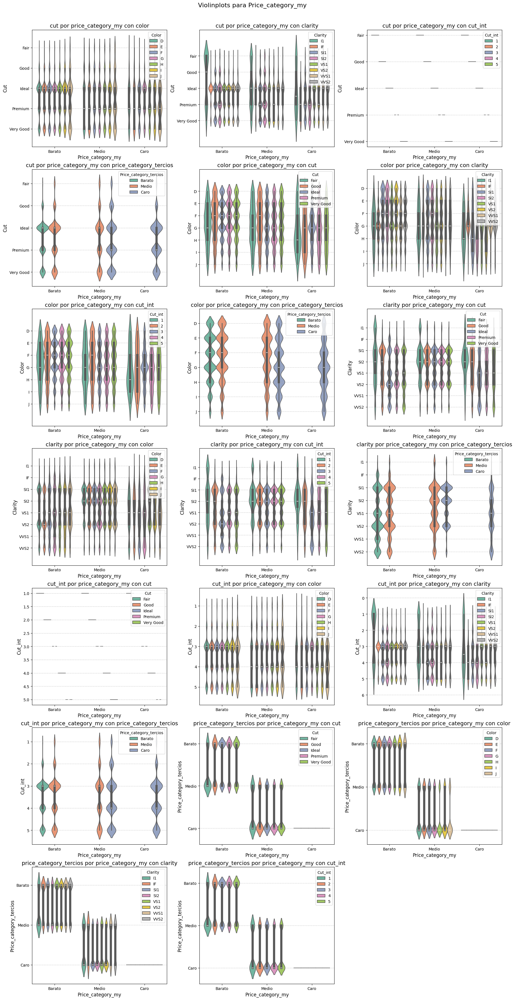

Generando gráficos para price_category_tercios...
Figura guardada como violinplots_price_category_tercios.png


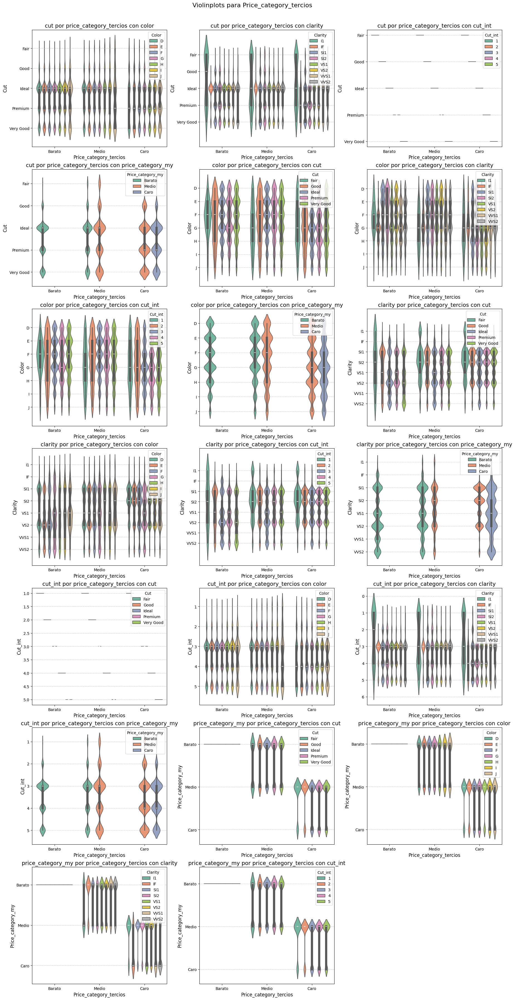

In [124]:
# Obtener las columnas categóricas
categorical_columns = df.select_dtypes(include=['object', 'category']).columns
print(f"Columnas categóricas: {categorical_columns}")
print(f"Total de columnas categóricas: {len(categorical_columns)}")

# Crear combinaciones únicas para x, y, y hue
combinations = []
for x_col in categorical_columns:
    for y_col in categorical_columns:
        for hue_col in categorical_columns:
            if x_col != y_col and x_col != hue_col and y_col != hue_col:
                combinations.append((x_col, y_col, hue_col))

print(f"Total de combinaciones generadas: {len(combinations)}")

# Agrupar combinaciones por x_col
grouped_combinations = {}
for x_col, y_col, hue_col in combinations:
    if x_col not in grouped_combinations:
        grouped_combinations[x_col] = []
    grouped_combinations[x_col].append((y_col, hue_col))

# Generar figuras separadas por x_col
for x_col, group in grouped_combinations.items():
    print(f"Generando gráficos para {x_col}...")
    
    n_cols = 3  # Número de columnas por fila
    n_rows = (len(group) + n_cols - 1) // n_cols  # Calcular el número de filas necesario
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows), constrained_layout=True)
    axes = axes.flatten()  # Aplanar el arreglo de ejes
    
    for idx, (y_col, hue_col) in enumerate(group):
        ax = axes[idx]
        
        # Crear el violinplot
        sns.violinplot(data=df, x=x_col, y=y_col, hue=hue_col, palette='Set2', ax=ax)
        
        # Configurar el título y etiquetas
        ax.set_title(f"{y_col} por {x_col} con {hue_col}", fontsize=14)
        ax.set_xlabel(x_col.capitalize(), fontsize=12)
        ax.set_ylabel(y_col.capitalize(), fontsize=12)
        ax.legend(title=hue_col.capitalize(), loc='upper right')
        ax.grid(axis='y', linestyle='--', alpha=0.7)
    
    # Ocultar subplots adicionales si sobran
    for j in range(len(group), len(axes)):
        fig.delaxes(axes[j])
    
    # Guardar la figura en un archivo
    file_name = f"violinplots_{x_col}.png"
    plt.suptitle(f"Violinplots para {x_col.capitalize()}", fontsize=16, y=1.02)
    plt.savefig(file_name)
    print(f"Figura guardada como {file_name}")
    
    # Mostrar la figura
    plt.show()


#### 4.1.2.1. scatterplot con hue, con size, con style


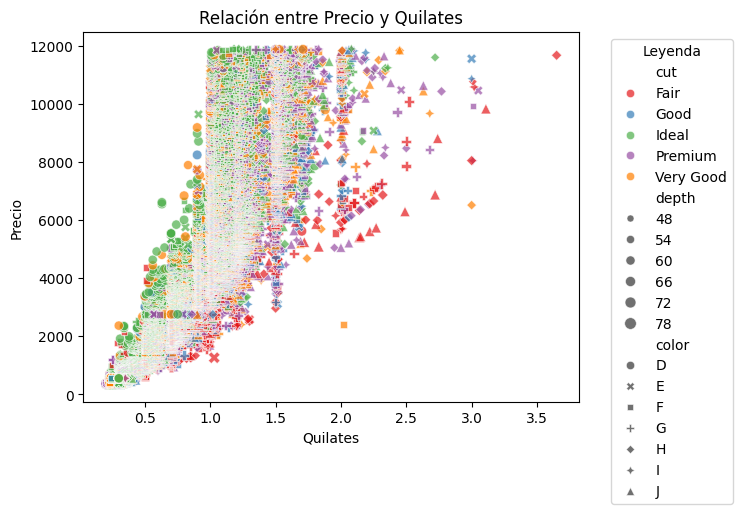

In [125]:
#Scatterplot con hue, size y style
plt.figure()
sns.scatterplot(data=df, x='carat', y='price', hue='cut', size='depth', style='color', palette='Set1', alpha=0.7)
plt.title("Relación entre Precio y Quilates")
plt.xlabel("Quilates")
plt.ylabel("Precio")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title="Leyenda")
plt.show()

In [ ]:
# Obtener columnas categóricas y numéricas
categorical_columns = df.select_dtypes(include=['object', 'category']).columns
numerical_columns = df.select_dtypes(include=['float', 'int']).columns

print(f"Columnas categóricas: {categorical_columns}")
print(f"Columnas numéricas: {numerical_columns}")

# Crear combinaciones únicas de categóricas (x), numéricas (y), y hue
combinations = []
for x_col in categorical_columns:
    for y_col in numerical_columns:
        for hue_col in categorical_columns:
            if x_col != hue_col:
                combinations.append((x_col, y_col, hue_col))

print(f"Total de combinaciones generadas: {len(combinations)}")

# Agrupar combinaciones por x_col
grouped_combinations = {}
for x_col, y_col, hue_col in combinations:
    if x_col not in grouped_combinations:
        grouped_combinations[x_col] = []
    grouped_combinations[x_col].append((y_col, hue_col))

# Generar figuras separadas por x_col
for x_col, group in grouped_combinations.items():
    print(f"Generando gráficos para {x_col}...")
    
    n_cols = 3  # Número de columnas por fila
    n_rows = (len(group) + n_cols - 1) // n_cols  # Calcular el número de filas necesario
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows), constrained_layout=True)
    axes = axes.flatten()  # Aplanar el arreglo de ejes
    
    for idx, (y_col, hue_col) in enumerate(group):
        ax = axes[idx]
        
        # Crear el scatterplot
        sns.scatterplot(data=df, x=x_col, y=y_col, hue=hue_col, palette='Set2', ax=ax, alpha=0.7)
        
        # Configurar el título y etiquetas
        ax.set_title(f"{y_col} vs {x_col} (Hue: {hue_col})", fontsize=14)
        ax.set_xlabel(x_col.capitalize(), fontsize=12)
        ax.set_ylabel(y_col.capitalize(), fontsize=12)
        ax.legend(title=hue_col.capitalize(), loc='upper right')
        ax.grid(axis='y', linestyle='--', alpha=0.7)
    
    # Ocultar subplots adicionales si sobran
    for j in range(len(group), len(axes)):
        fig.delaxes(axes[j])
    
    # Guardar la figura en un archivo
    file_name = f"scatterplots_{x_col}.png"
    plt.suptitle(f"Scatterplots para {x_col.capitalize()}", fontsize=16, y=1.02)
    plt.savefig(file_name)
    print(f"Figura guardada como {file_name}")
    
    # Mostrar la figura
    plt.show()


Columnas categóricas: Index(['cut', 'color', 'clarity', 'cut_int', 'price_category_my',
       'price_category_tercios'],
      dtype='object')
Columnas numéricas: Index(['carat', 'depth', 'table', 'price', 'x', 'y', 'z', 'price_IVA',
       'discount_applied', 'price_discount', 'volumen', 'price_per_carat',
       'price_per_gr', 'price_std'],
      dtype='object')
Total de combinaciones generadas: 420
Generando gráficos para cut...


In [ ]:
#sns.scatterplot(df[df['Type 1'] == 'Grass'], x='Attack', y='Defense')

C:\Users\carol\AppData\Roaming\Python\Python313\site-packages\IPython\core\events.py:82: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)
C:\Users\carol\AppData\Roaming\Python\Python313\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


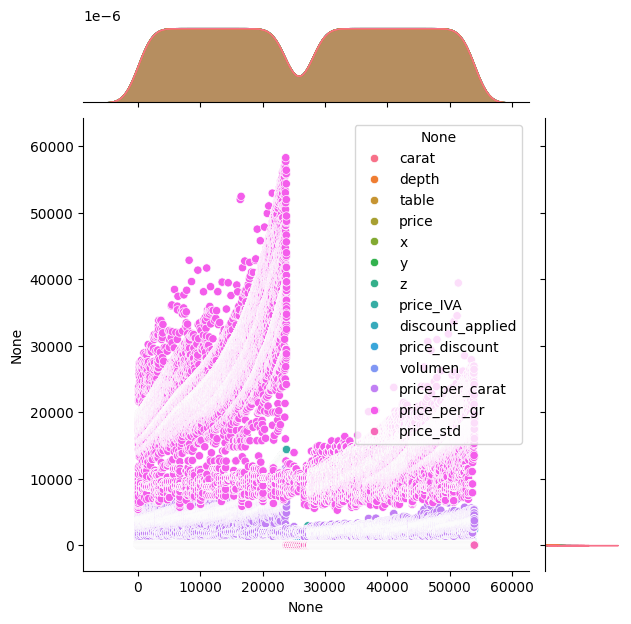

In [103]:
sns.jointplot(df)

Columnas numéricas: Index(['carat', 'depth', 'table', 'price', 'x', 'y', 'z', 'price_IVA',
       'discount_applied', 'price_discount', 'volumen', 'price_per_carat',
       'price_per_gr', 'price_std'],
      dtype='object')
Total de columnas numéricas: 14
Total de combinaciones generadas: 91
Generando jointplot para carat y depth...
Figura guardada como jointplot_carat_vs_depth.png


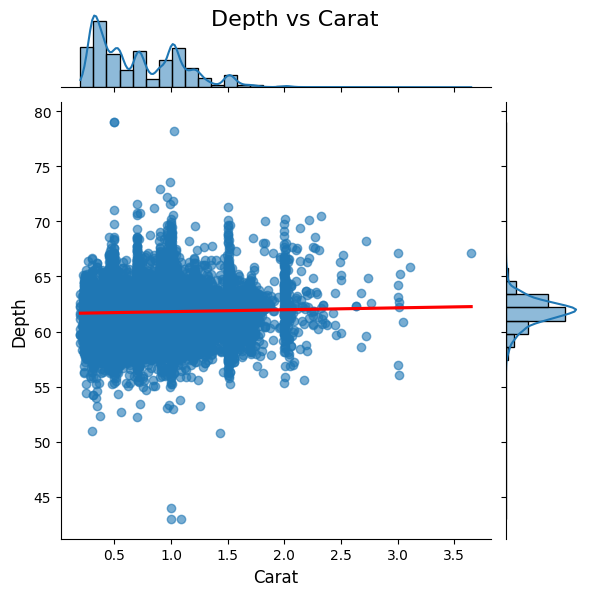

Generando jointplot para carat y table...
Figura guardada como jointplot_carat_vs_table.png


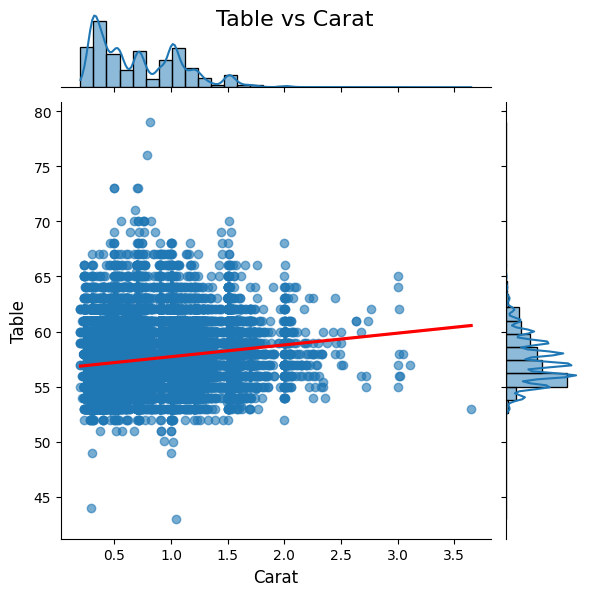

Generando jointplot para carat y price...
Figura guardada como jointplot_carat_vs_price.png


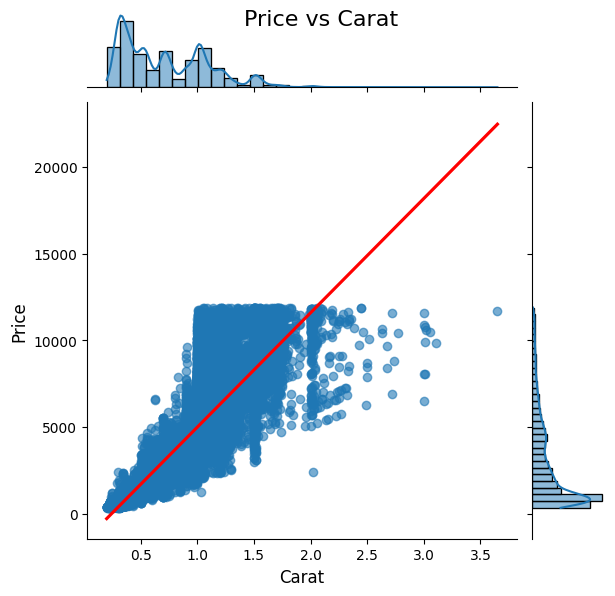

Generando jointplot para carat y x...
Figura guardada como jointplot_carat_vs_x.png


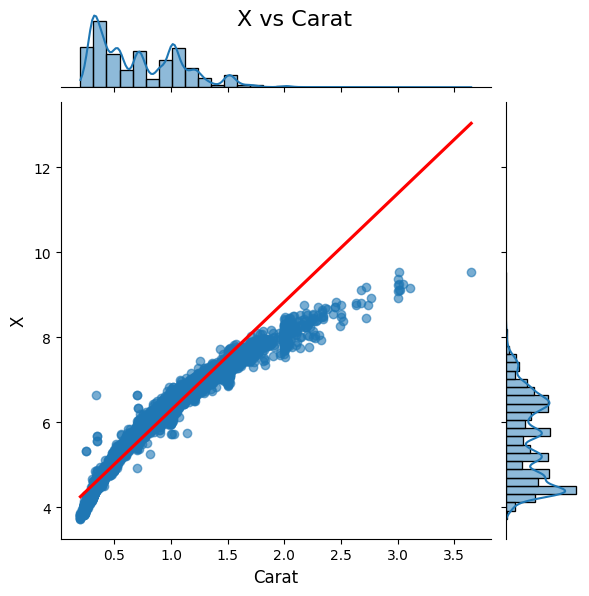

Generando jointplot para carat y y...
Figura guardada como jointplot_carat_vs_y.png


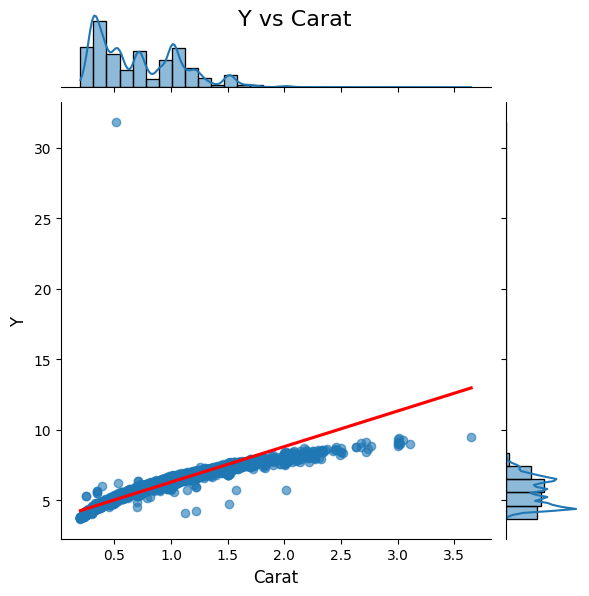

Generando jointplot para carat y z...
Figura guardada como jointplot_carat_vs_z.png


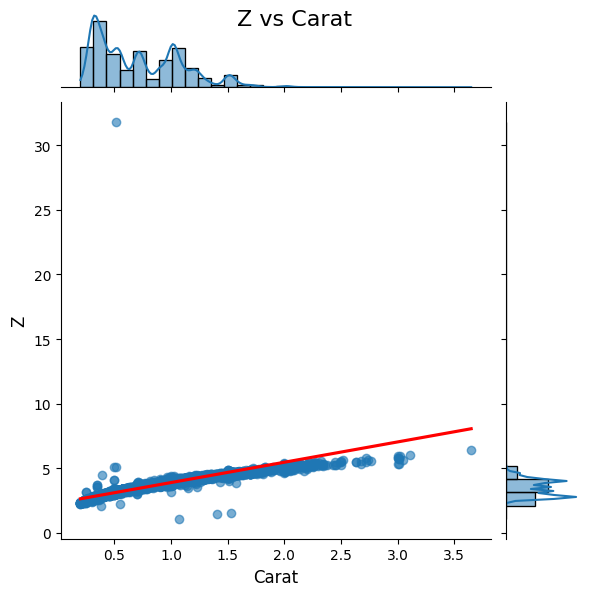

Generando jointplot para carat y price_IVA...
Figura guardada como jointplot_carat_vs_price_IVA.png


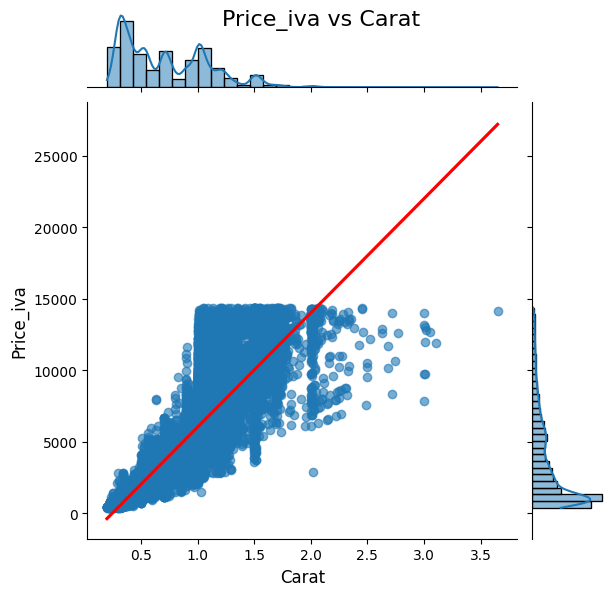

Generando jointplot para carat y discount_applied...
Figura guardada como jointplot_carat_vs_discount_applied.png


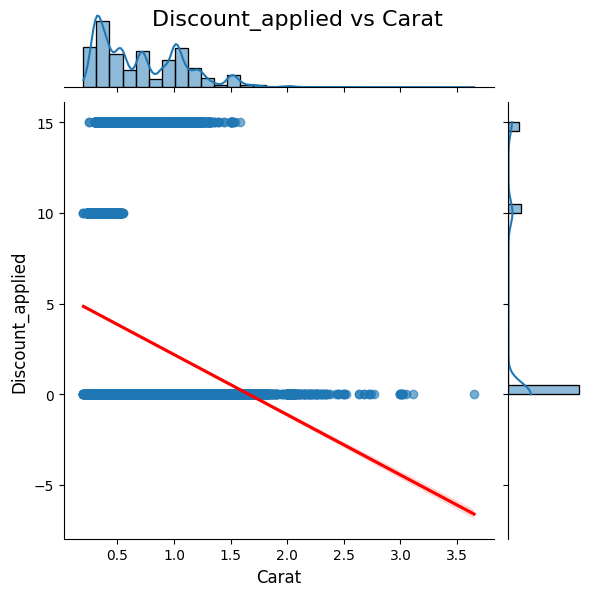

Generando jointplot para carat y price_discount...
Figura guardada como jointplot_carat_vs_price_discount.png


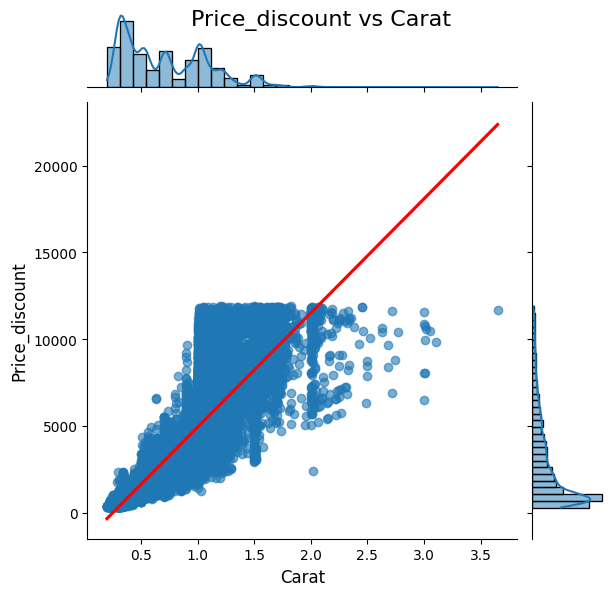

Generando jointplot para carat y volumen...
Figura guardada como jointplot_carat_vs_volumen.png


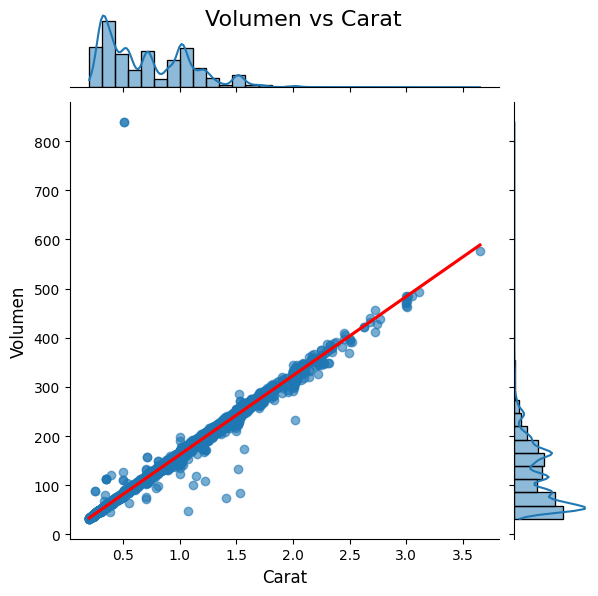

Generando jointplot para carat y price_per_carat...
Figura guardada como jointplot_carat_vs_price_per_carat.png


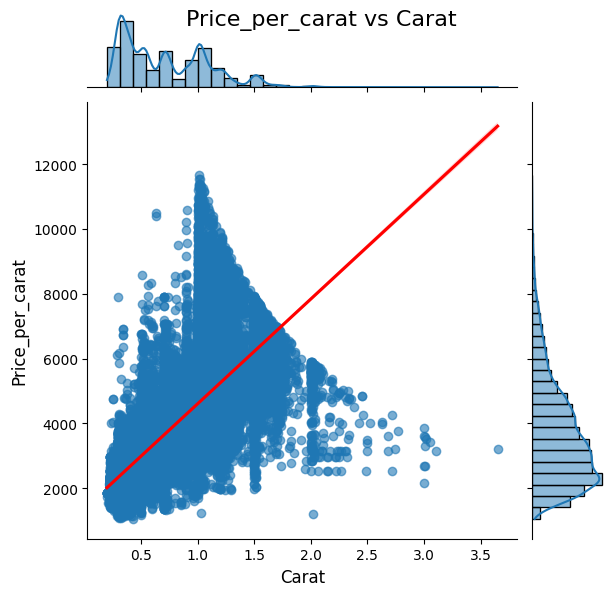

Generando jointplot para carat y price_per_gr...
Figura guardada como jointplot_carat_vs_price_per_gr.png


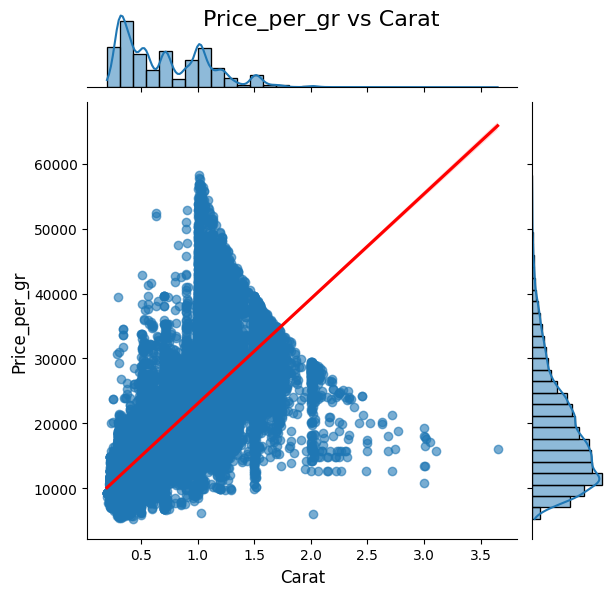

Generando jointplot para carat y price_std...
Figura guardada como jointplot_carat_vs_price_std.png


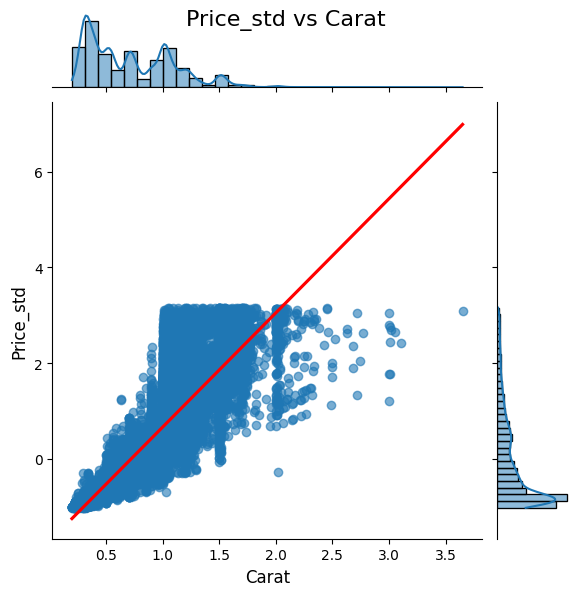

Generando jointplot para depth y table...
Figura guardada como jointplot_depth_vs_table.png


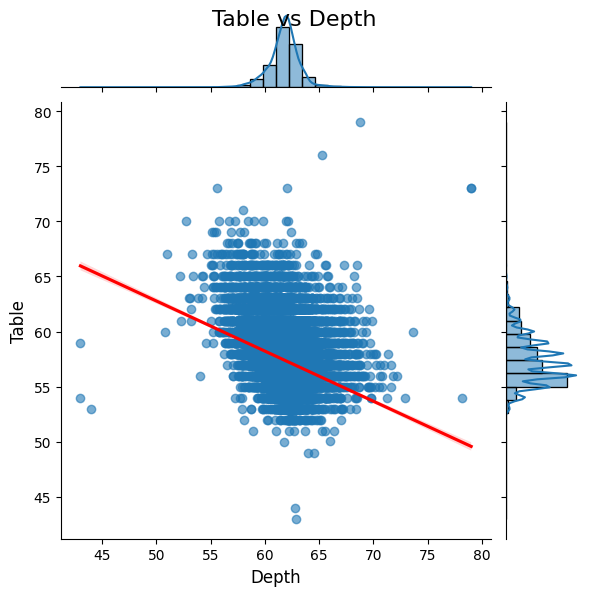

Generando jointplot para depth y price...
Figura guardada como jointplot_depth_vs_price.png


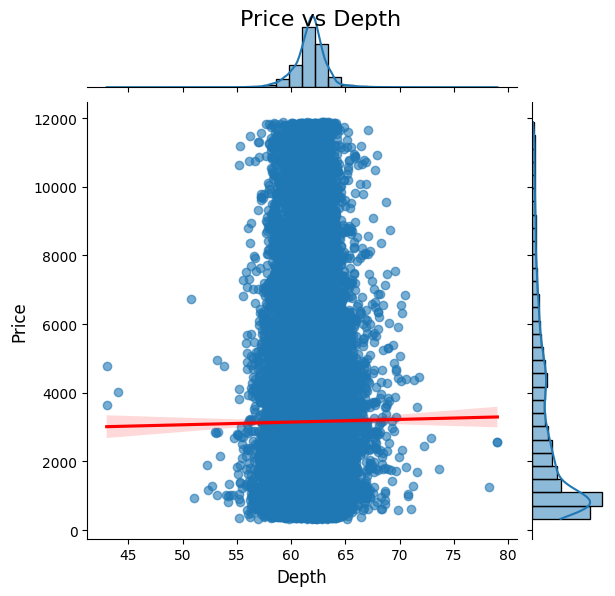

Generando jointplot para depth y x...
Figura guardada como jointplot_depth_vs_x.png


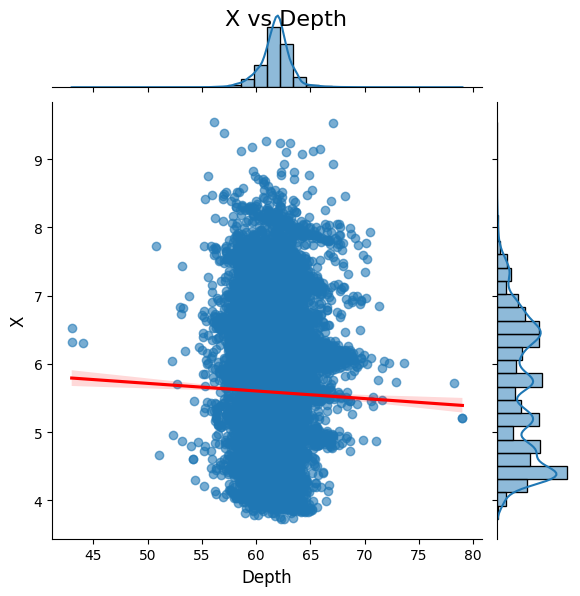

Generando jointplot para depth y y...
Figura guardada como jointplot_depth_vs_y.png


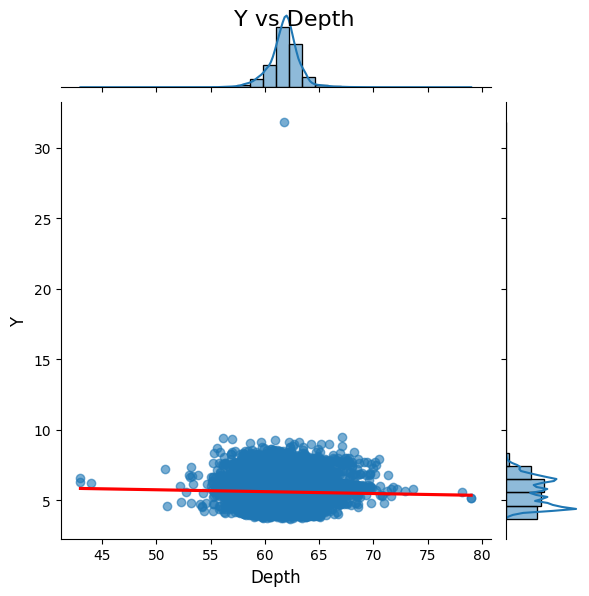

Generando jointplot para depth y z...
Figura guardada como jointplot_depth_vs_z.png


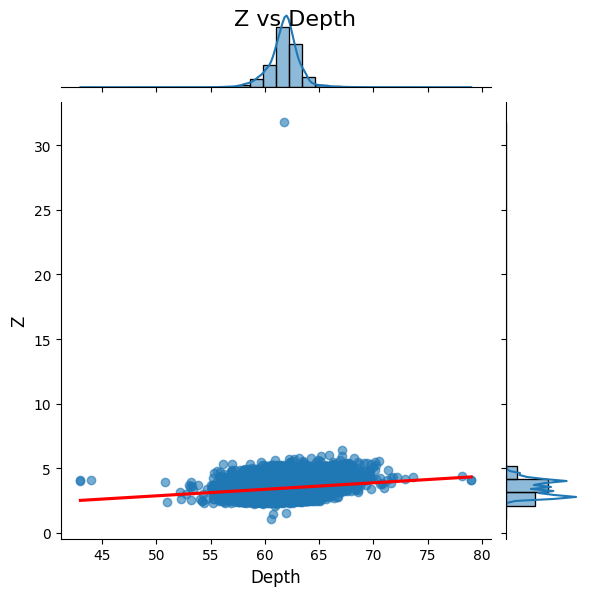

Generando jointplot para depth y price_IVA...
Figura guardada como jointplot_depth_vs_price_IVA.png


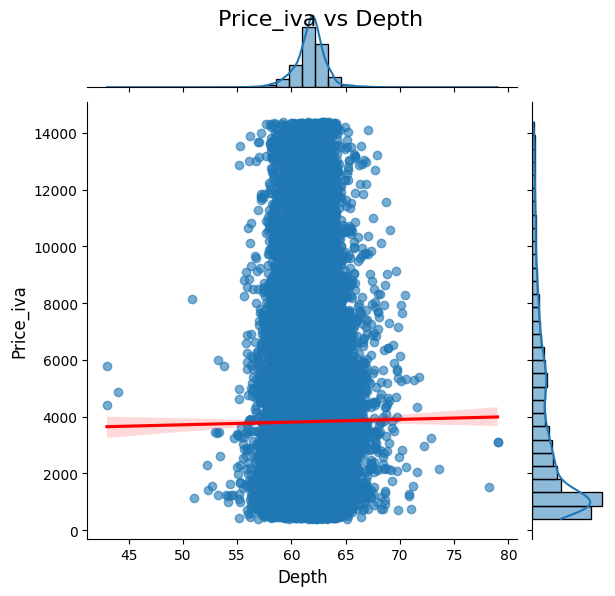

Generando jointplot para depth y discount_applied...
Figura guardada como jointplot_depth_vs_discount_applied.png


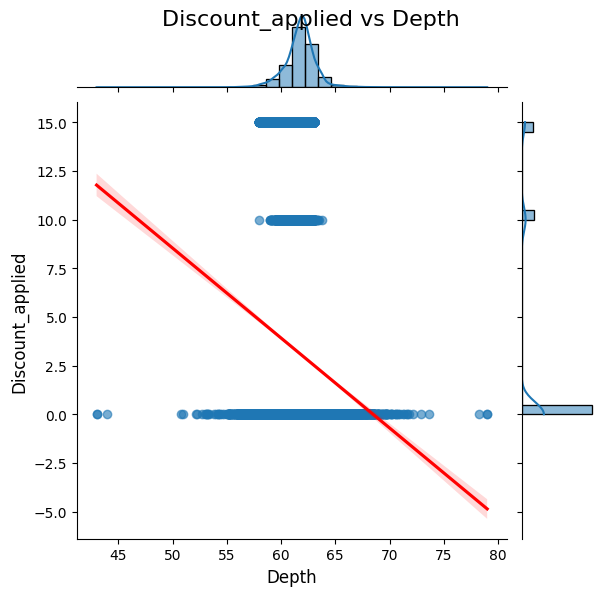

Generando jointplot para depth y price_discount...
Figura guardada como jointplot_depth_vs_price_discount.png


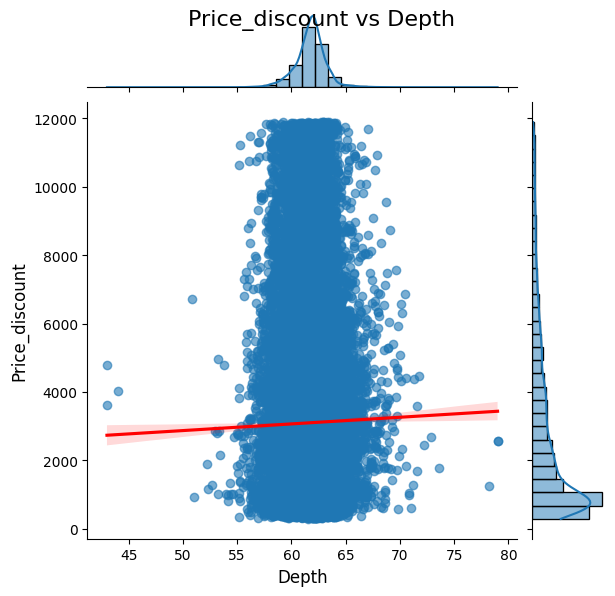

Generando jointplot para depth y volumen...
Figura guardada como jointplot_depth_vs_volumen.png


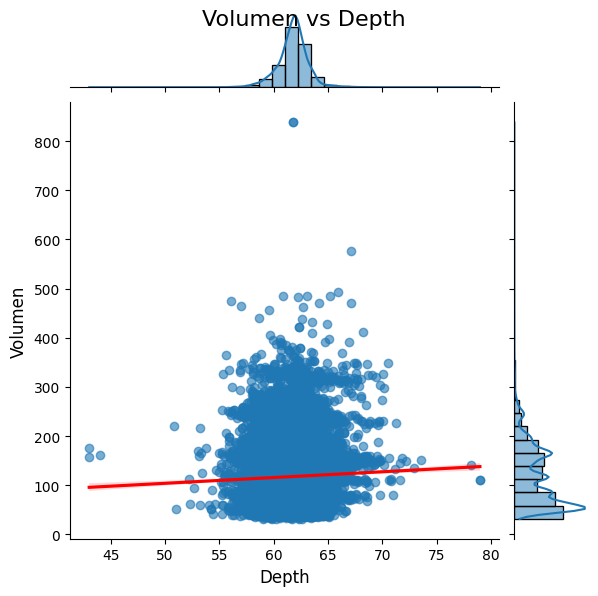

Generando jointplot para depth y price_per_carat...
Figura guardada como jointplot_depth_vs_price_per_carat.png


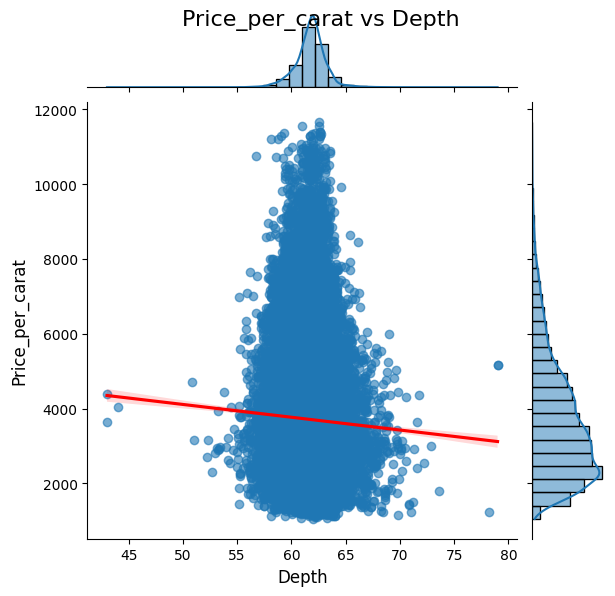

Generando jointplot para depth y price_per_gr...
Figura guardada como jointplot_depth_vs_price_per_gr.png


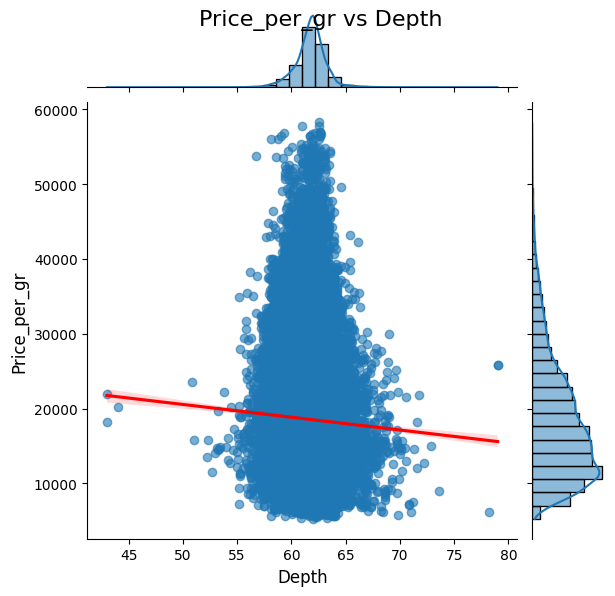

Generando jointplot para depth y price_std...
Figura guardada como jointplot_depth_vs_price_std.png


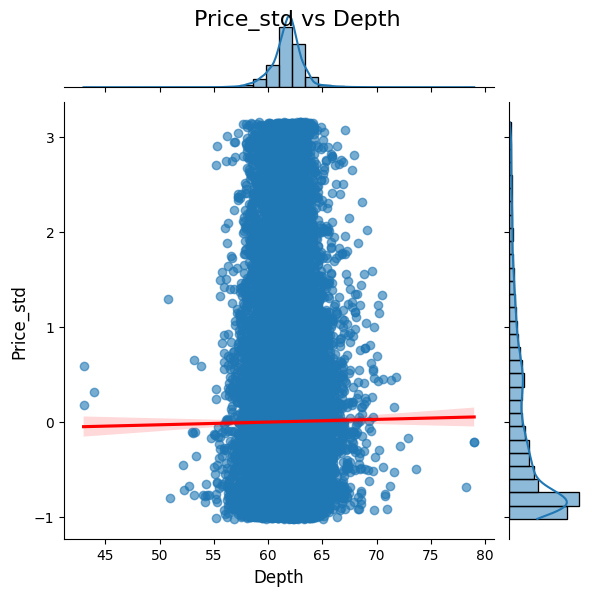

Generando jointplot para table y price...
Figura guardada como jointplot_table_vs_price.png


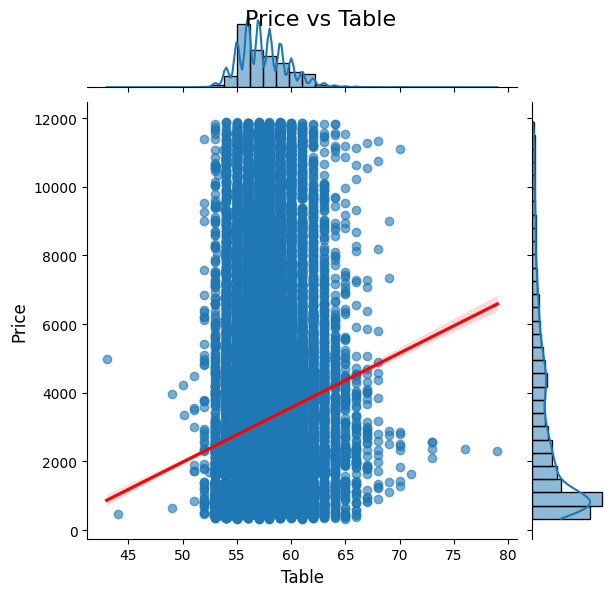

Generando jointplot para table y x...
Figura guardada como jointplot_table_vs_x.png


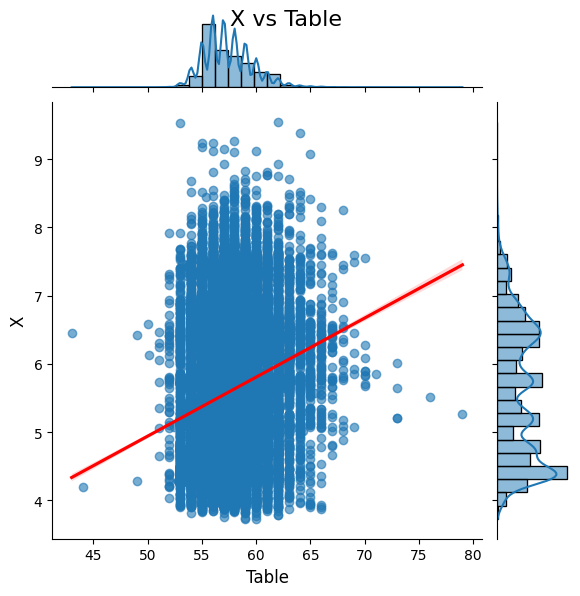

Generando jointplot para table y y...
Figura guardada como jointplot_table_vs_y.png


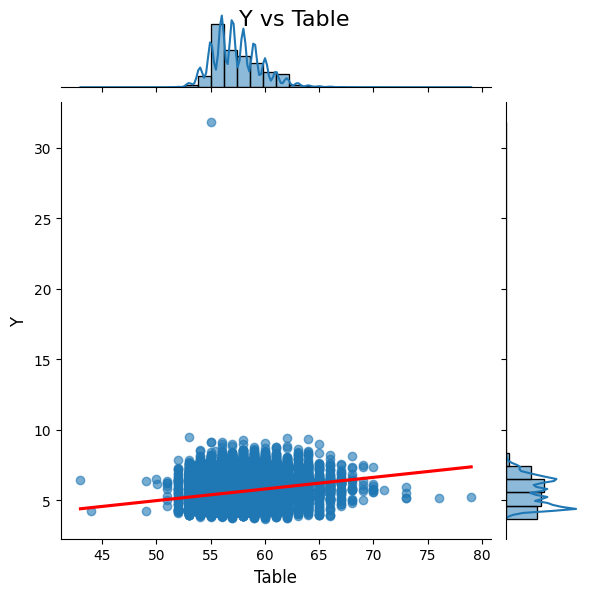

Generando jointplot para table y z...
Figura guardada como jointplot_table_vs_z.png


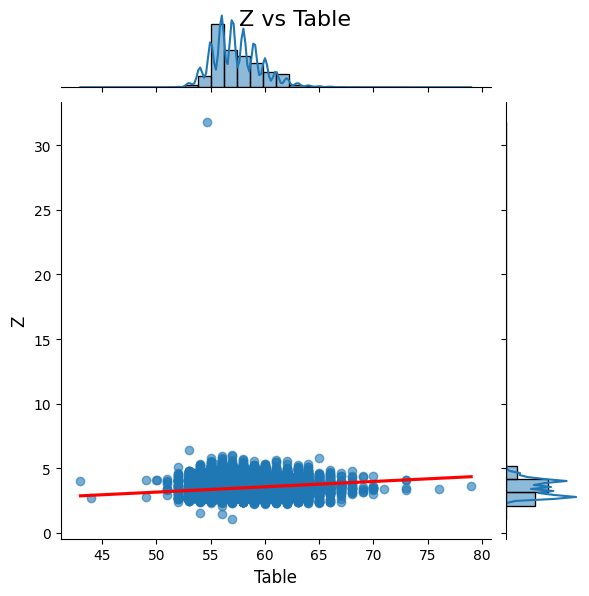

Generando jointplot para table y price_IVA...
Figura guardada como jointplot_table_vs_price_IVA.png


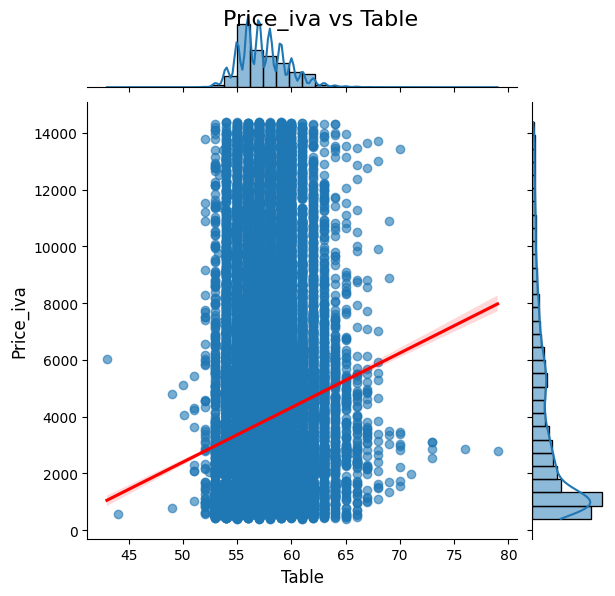

Generando jointplot para table y discount_applied...
Figura guardada como jointplot_table_vs_discount_applied.png


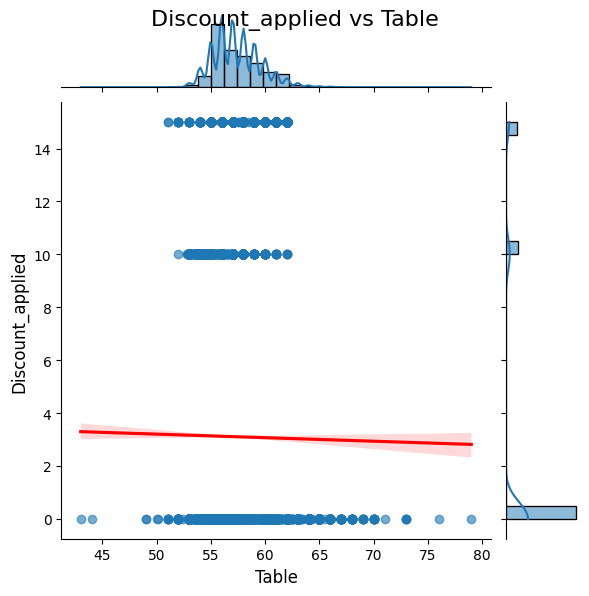

Generando jointplot para table y price_discount...
Figura guardada como jointplot_table_vs_price_discount.png


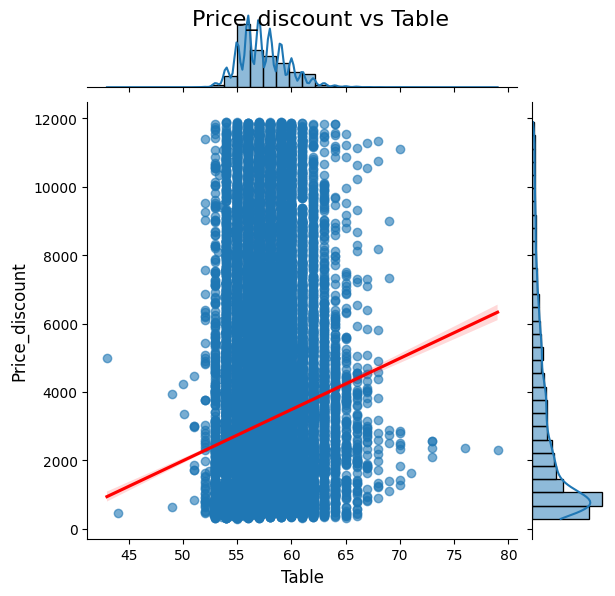

Generando jointplot para table y volumen...
Figura guardada como jointplot_table_vs_volumen.png


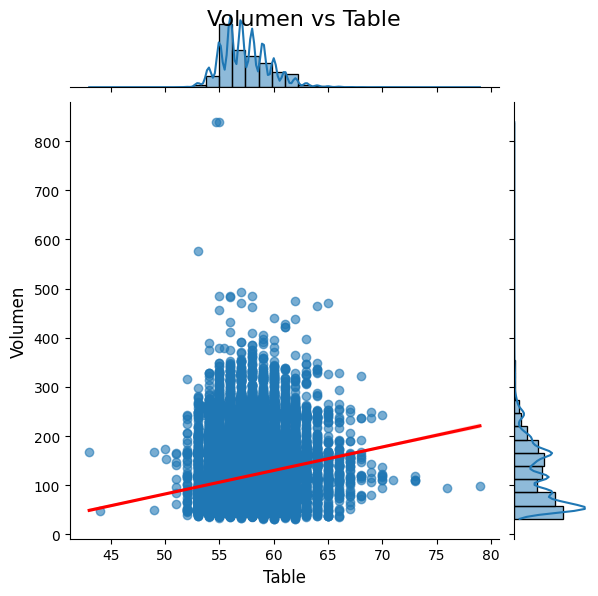

Generando jointplot para table y price_per_carat...
Figura guardada como jointplot_table_vs_price_per_carat.png


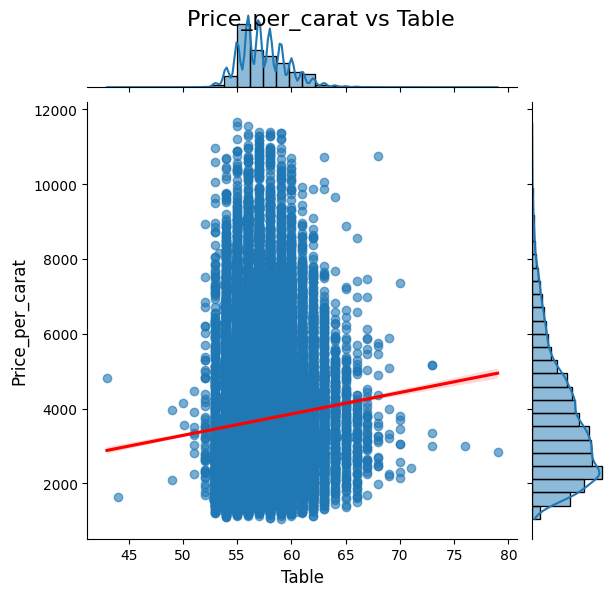

Generando jointplot para table y price_per_gr...
Figura guardada como jointplot_table_vs_price_per_gr.png


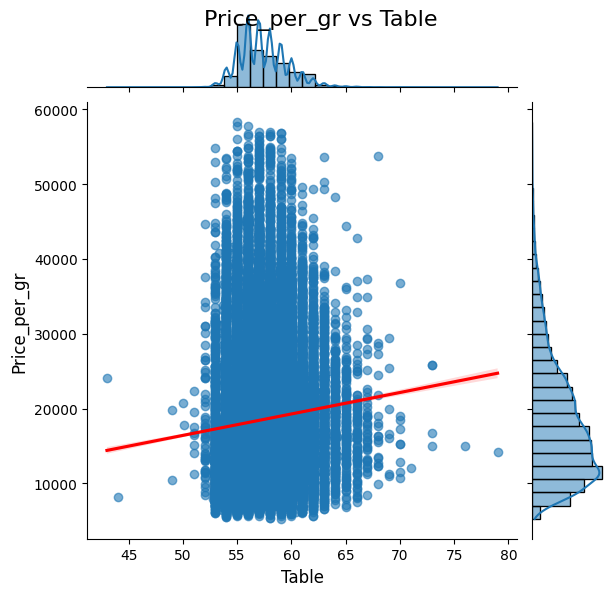

Generando jointplot para table y price_std...
Figura guardada como jointplot_table_vs_price_std.png


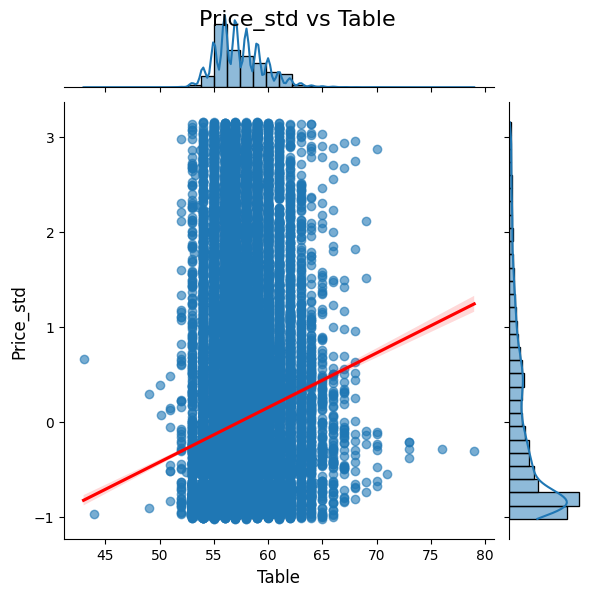

Generando jointplot para price y x...
Figura guardada como jointplot_price_vs_x.png


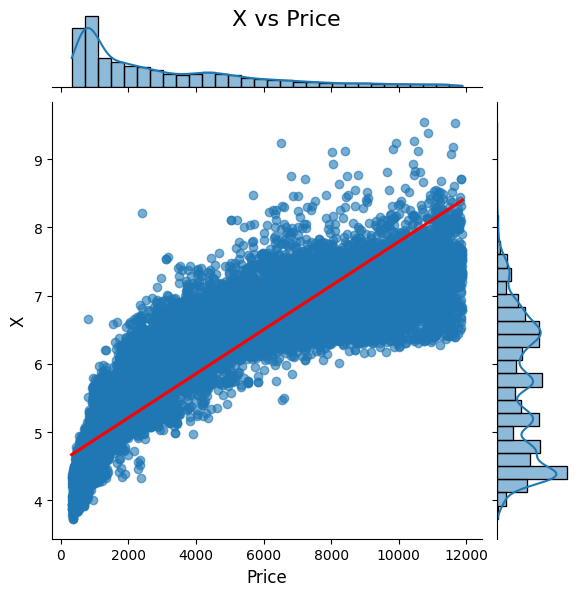

Generando jointplot para price y y...
Figura guardada como jointplot_price_vs_y.png


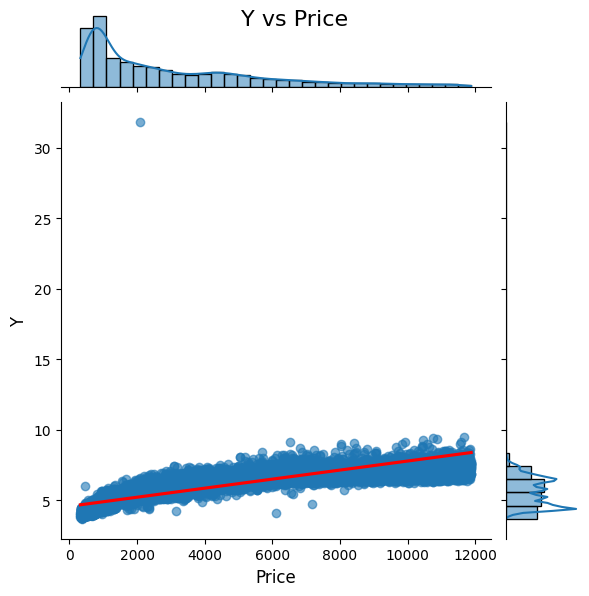

Generando jointplot para price y z...
Figura guardada como jointplot_price_vs_z.png


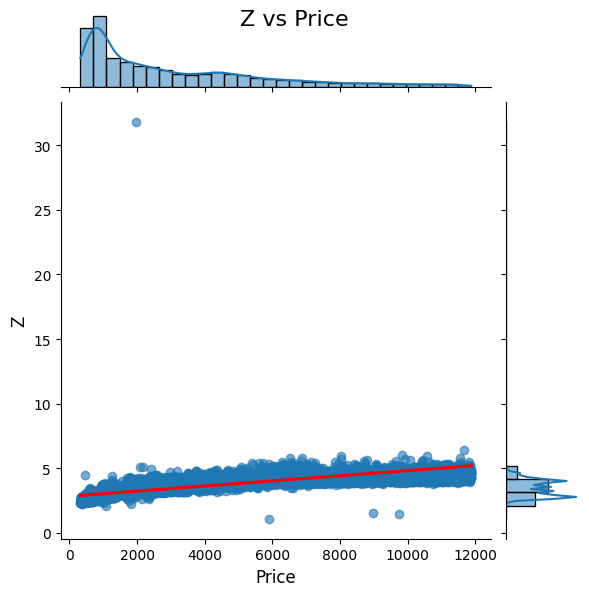

Generando jointplot para price y price_IVA...
Figura guardada como jointplot_price_vs_price_IVA.png


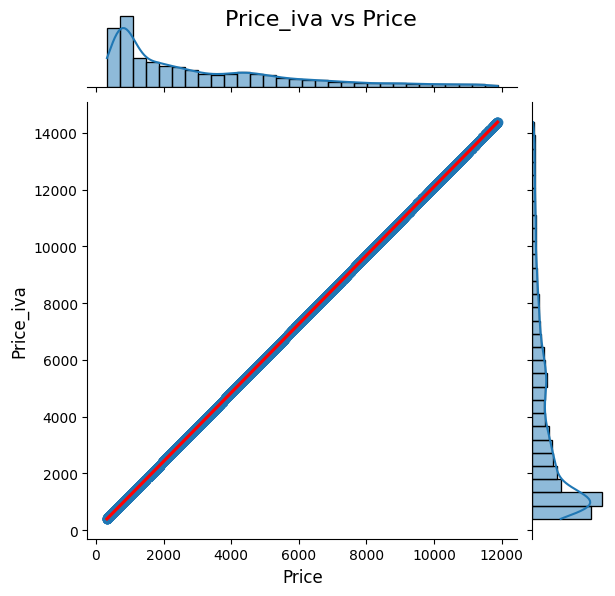

Generando jointplot para price y discount_applied...
Figura guardada como jointplot_price_vs_discount_applied.png


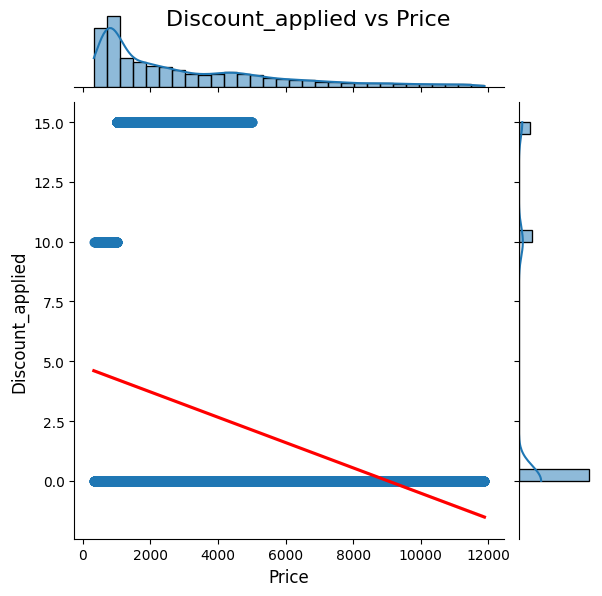

Generando jointplot para price y price_discount...
Figura guardada como jointplot_price_vs_price_discount.png


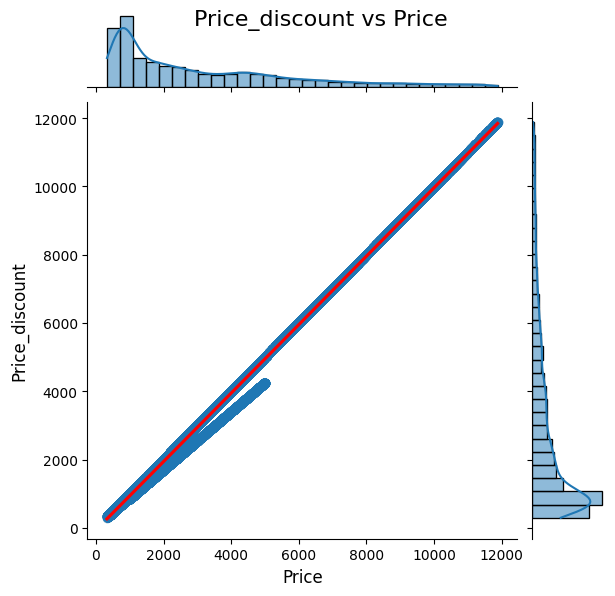

Generando jointplot para price y volumen...
Figura guardada como jointplot_price_vs_volumen.png


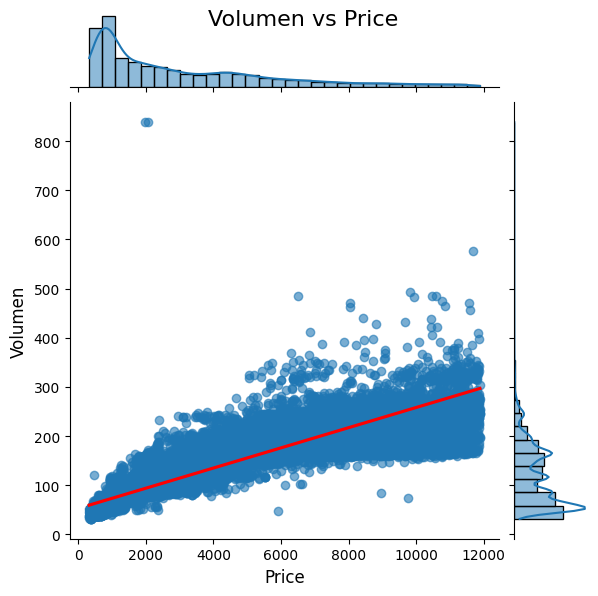

Generando jointplot para price y price_per_carat...
Figura guardada como jointplot_price_vs_price_per_carat.png


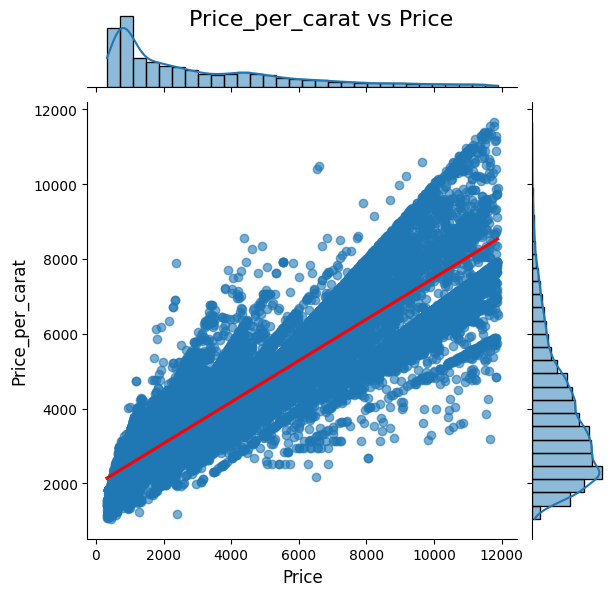

Generando jointplot para price y price_per_gr...
Figura guardada como jointplot_price_vs_price_per_gr.png


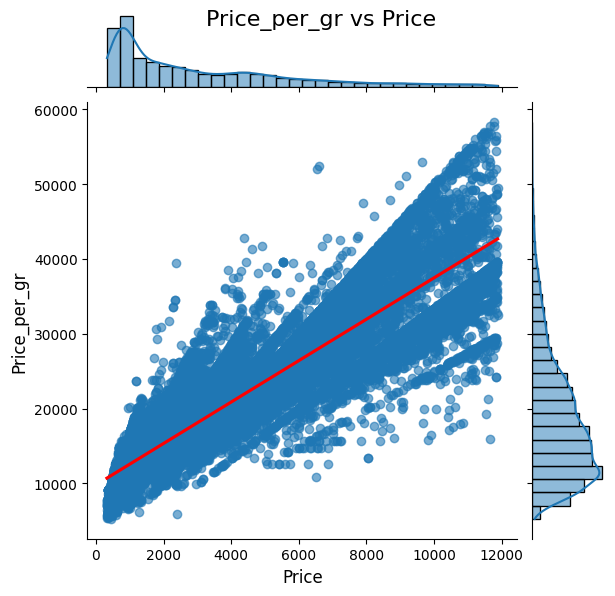

Generando jointplot para price y price_std...
Figura guardada como jointplot_price_vs_price_std.png


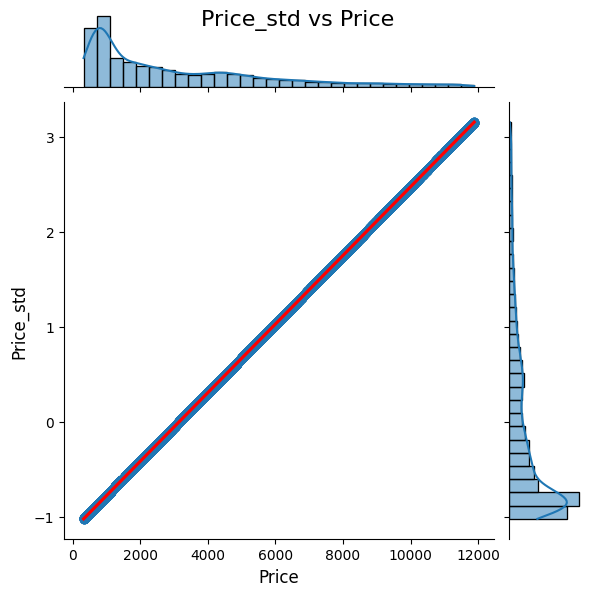

Generando jointplot para x y y...
Figura guardada como jointplot_x_vs_y.png


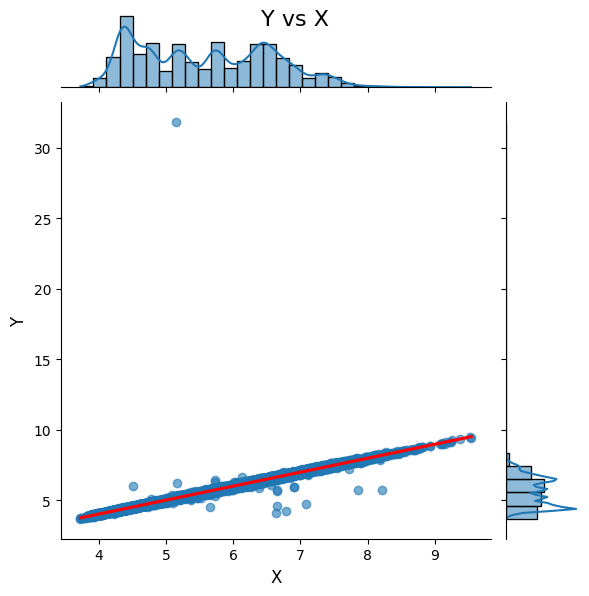

Generando jointplot para x y z...
Figura guardada como jointplot_x_vs_z.png


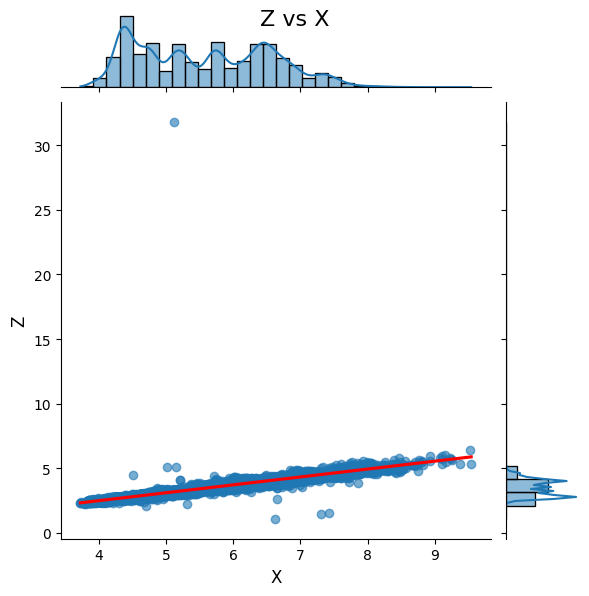

Generando jointplot para x y price_IVA...
Figura guardada como jointplot_x_vs_price_IVA.png


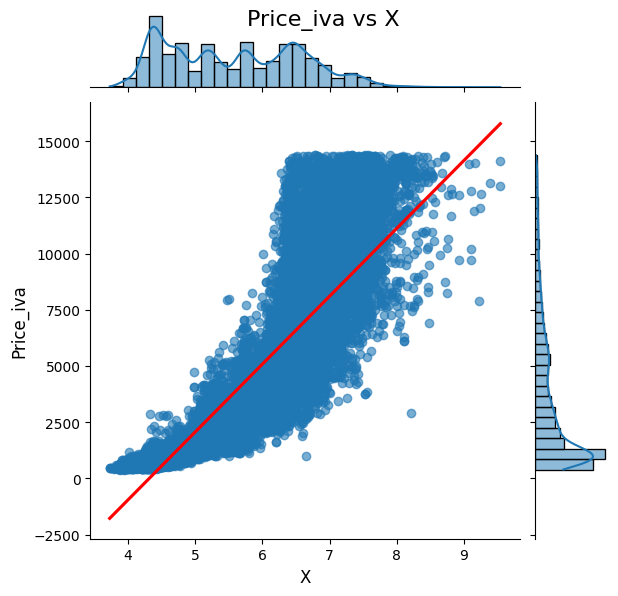

Generando jointplot para x y discount_applied...
Figura guardada como jointplot_x_vs_discount_applied.png


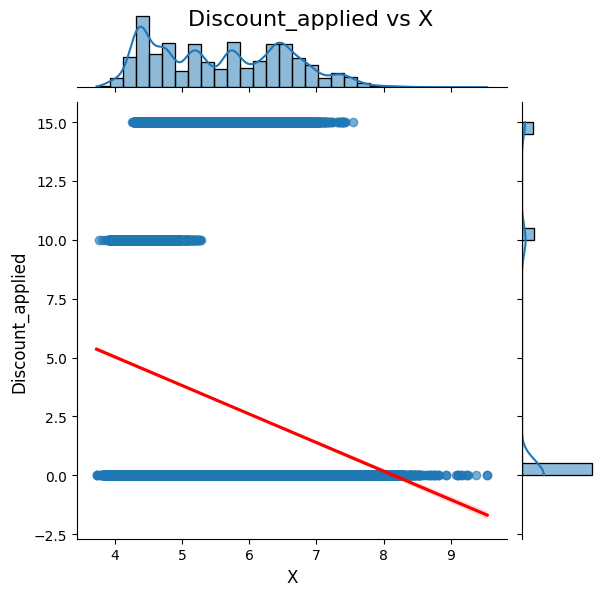

Generando jointplot para x y price_discount...
Figura guardada como jointplot_x_vs_price_discount.png


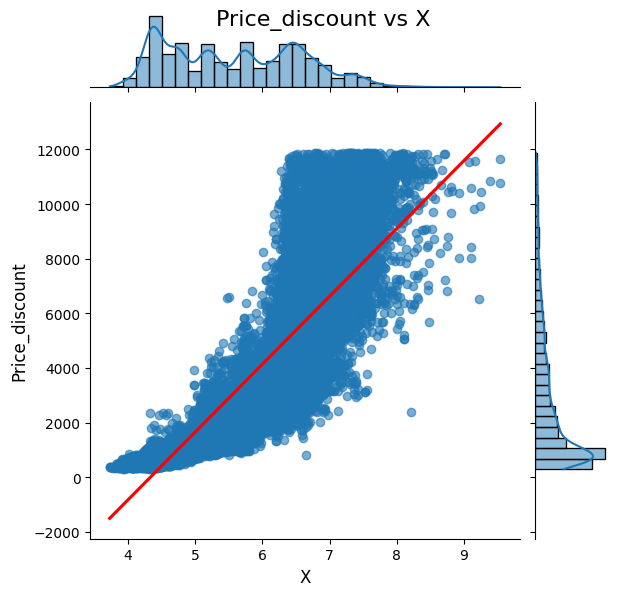

Generando jointplot para x y volumen...
Figura guardada como jointplot_x_vs_volumen.png


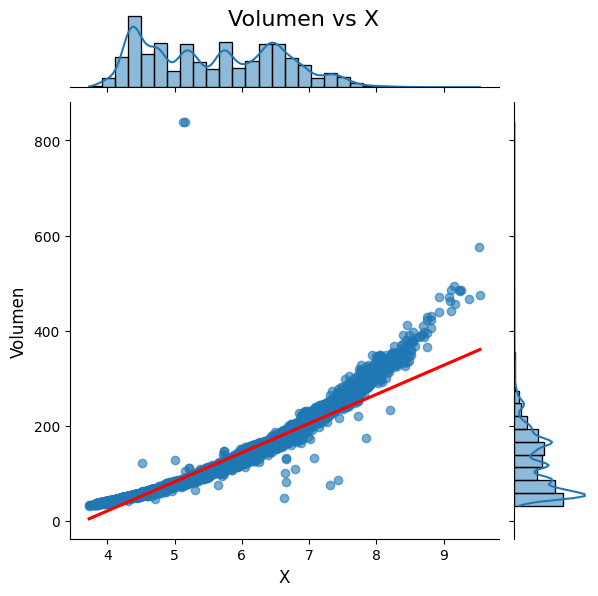

Generando jointplot para x y price_per_carat...
Figura guardada como jointplot_x_vs_price_per_carat.png


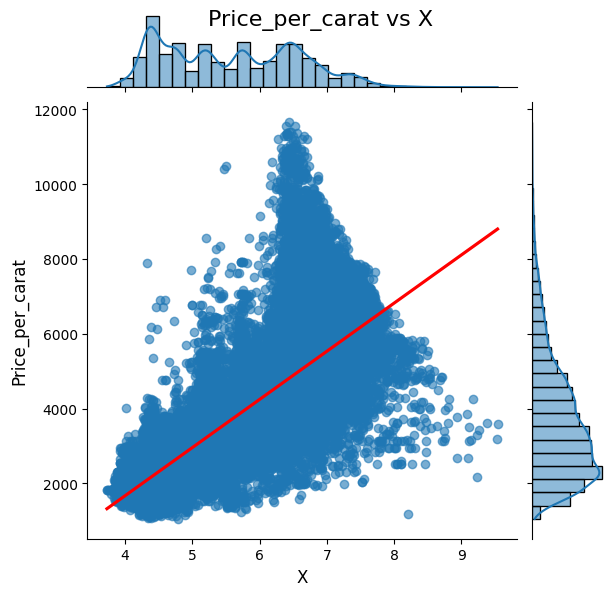

Generando jointplot para x y price_per_gr...
Figura guardada como jointplot_x_vs_price_per_gr.png


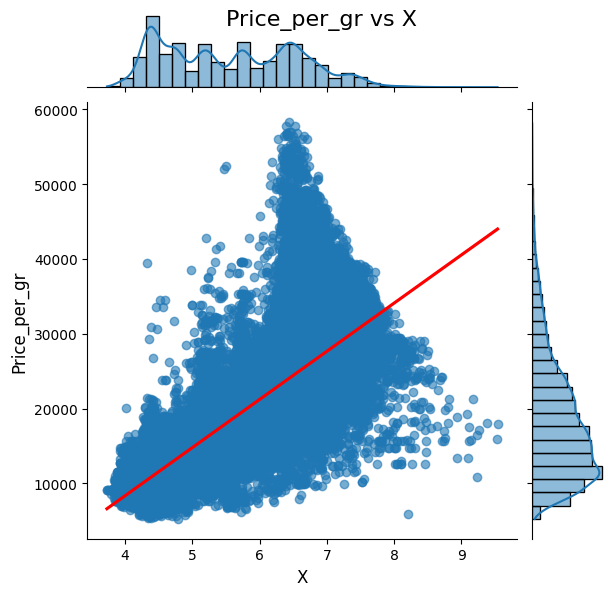

Generando jointplot para x y price_std...
Figura guardada como jointplot_x_vs_price_std.png


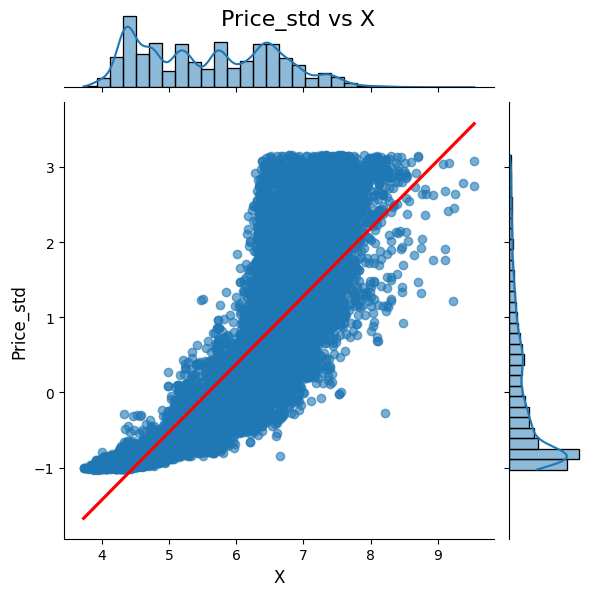

Generando jointplot para y y z...
Figura guardada como jointplot_y_vs_z.png


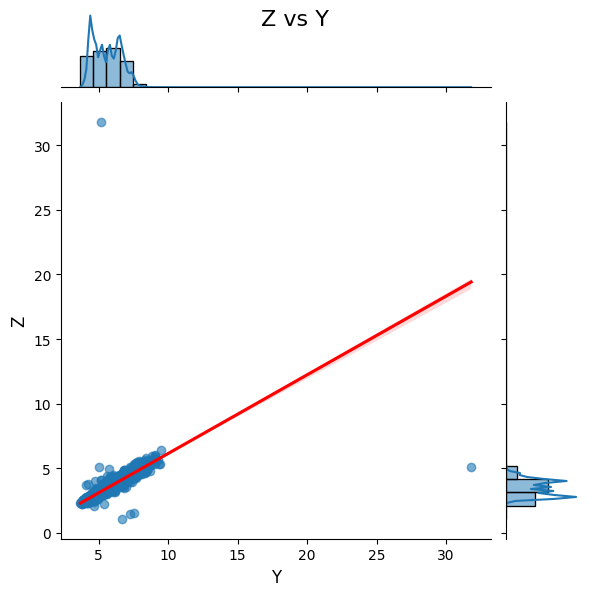

Generando jointplot para y y price_IVA...
Figura guardada como jointplot_y_vs_price_IVA.png


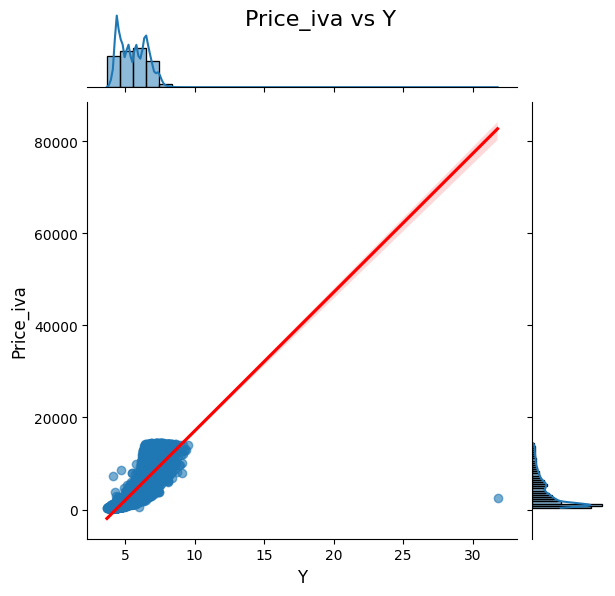

Generando jointplot para y y discount_applied...
Figura guardada como jointplot_y_vs_discount_applied.png


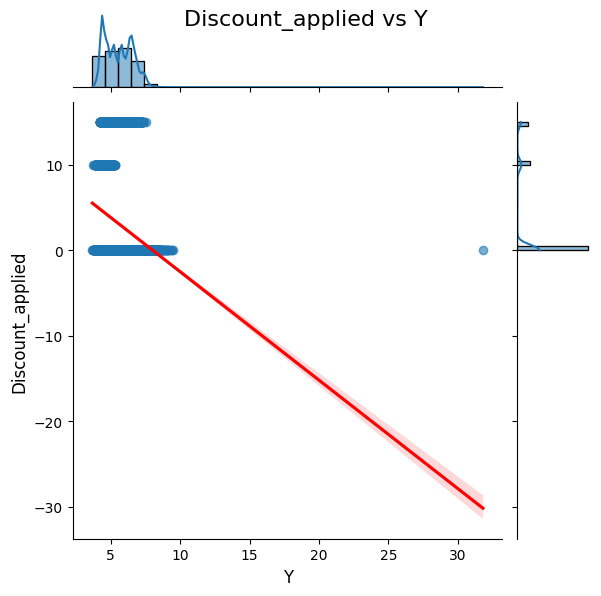

Generando jointplot para y y price_discount...
Figura guardada como jointplot_y_vs_price_discount.png


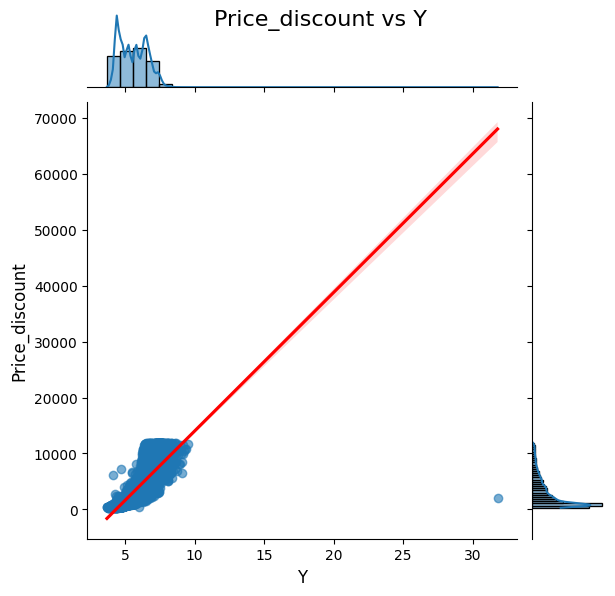

Generando jointplot para y y volumen...
Figura guardada como jointplot_y_vs_volumen.png


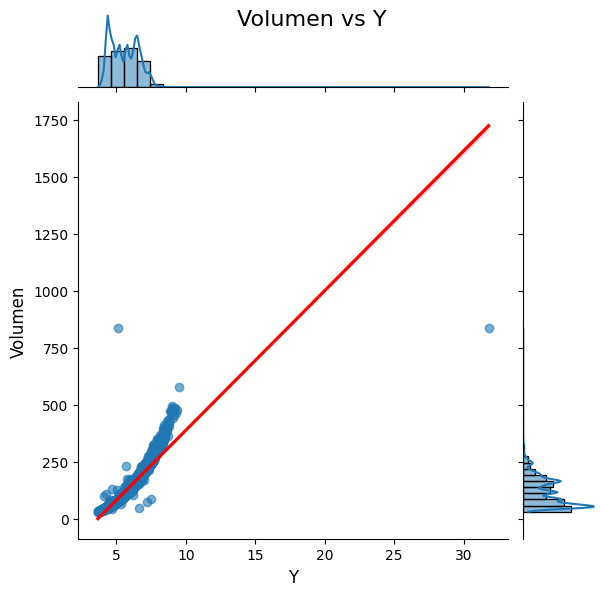

Generando jointplot para y y price_per_carat...
Figura guardada como jointplot_y_vs_price_per_carat.png


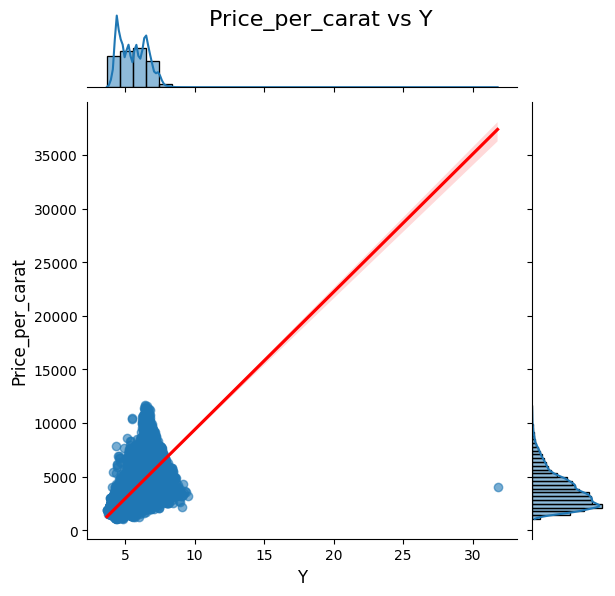

Generando jointplot para y y price_per_gr...
Figura guardada como jointplot_y_vs_price_per_gr.png


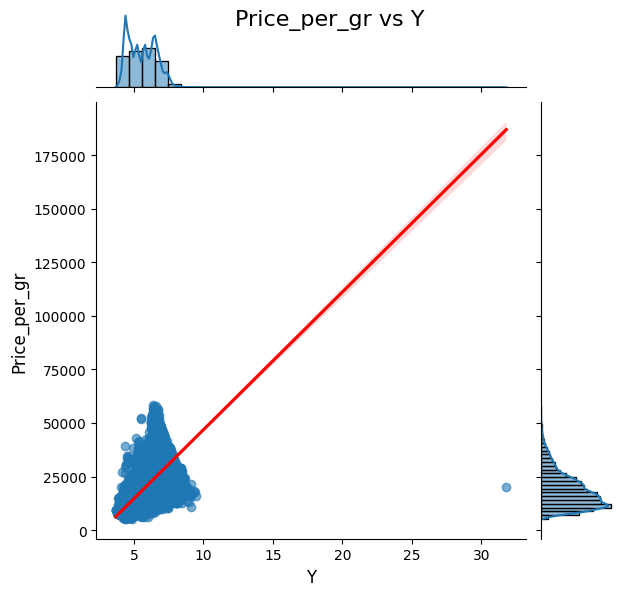

Generando jointplot para y y price_std...
Figura guardada como jointplot_y_vs_price_std.png


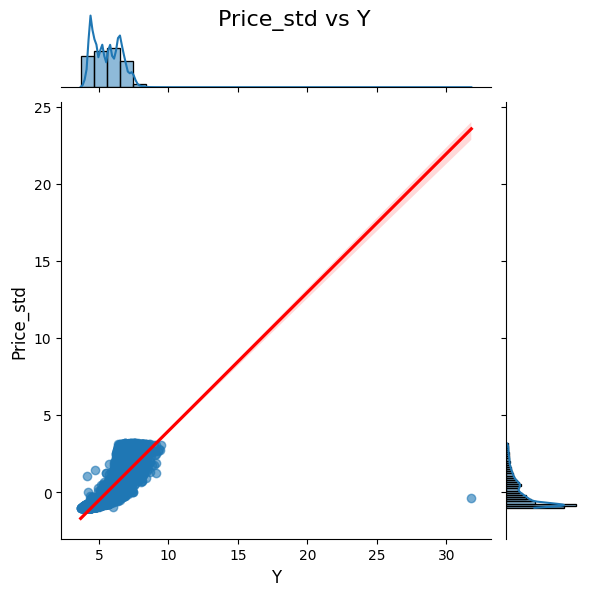

Generando jointplot para z y price_IVA...
Figura guardada como jointplot_z_vs_price_IVA.png


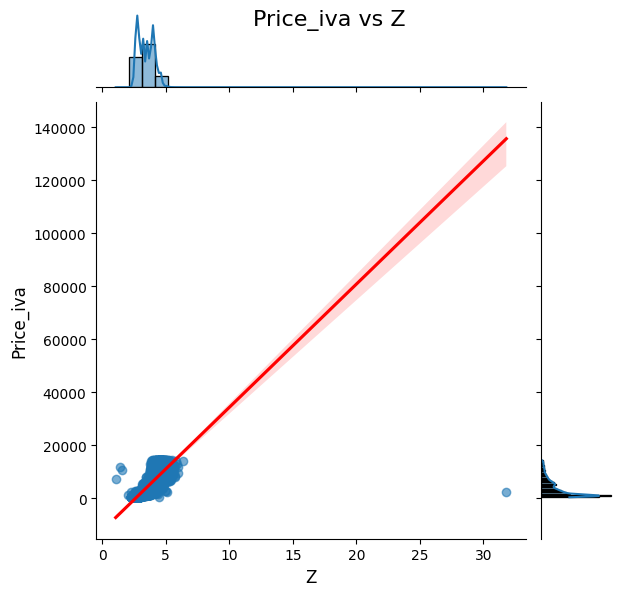

Generando jointplot para z y discount_applied...
Figura guardada como jointplot_z_vs_discount_applied.png


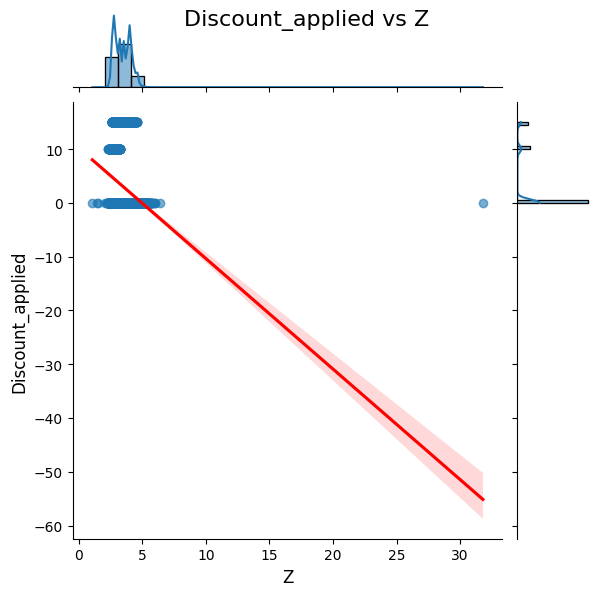

Generando jointplot para z y price_discount...
Figura guardada como jointplot_z_vs_price_discount.png


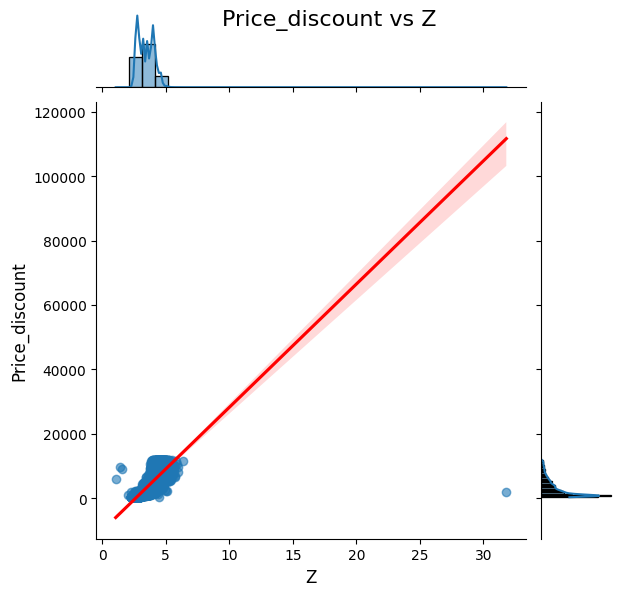

Generando jointplot para z y volumen...
Figura guardada como jointplot_z_vs_volumen.png


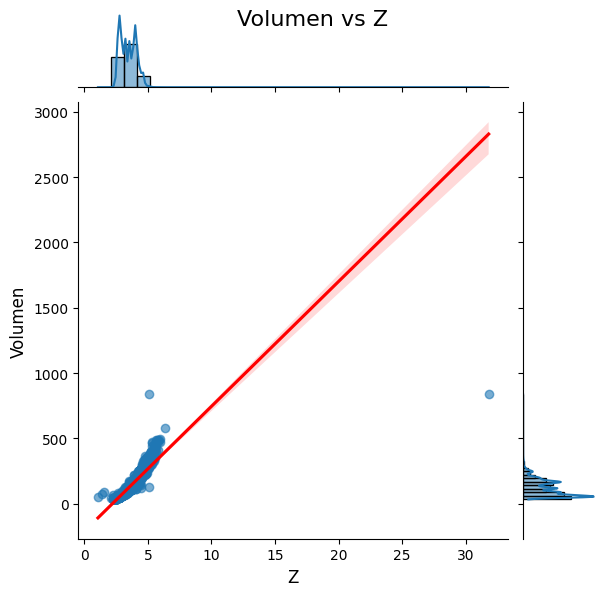

Generando jointplot para z y price_per_carat...
Figura guardada como jointplot_z_vs_price_per_carat.png


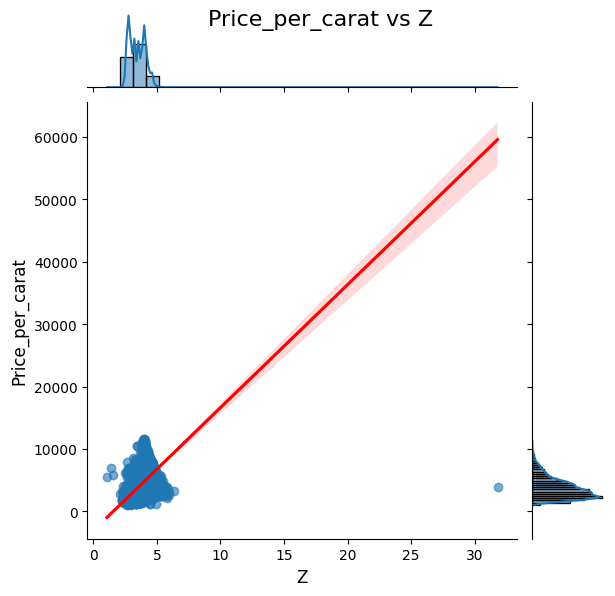

Generando jointplot para z y price_per_gr...
Figura guardada como jointplot_z_vs_price_per_gr.png


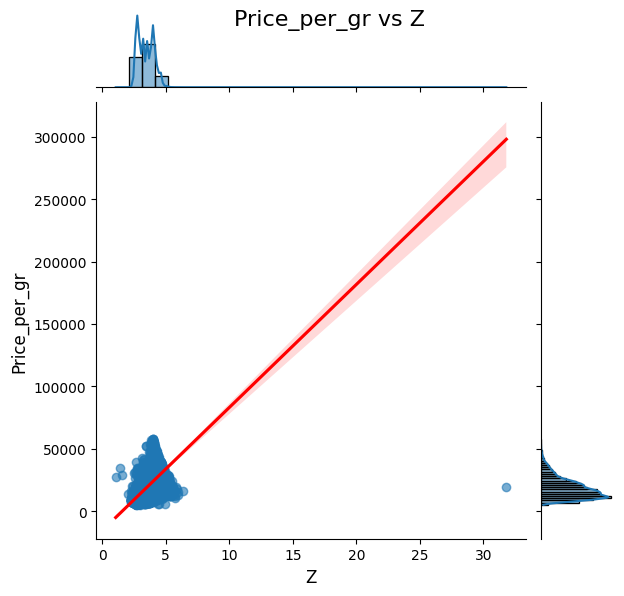

Generando jointplot para z y price_std...
Figura guardada como jointplot_z_vs_price_std.png


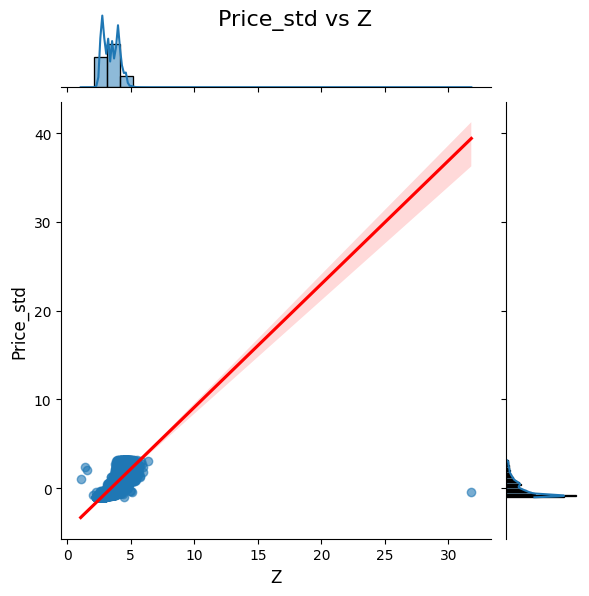

Generando jointplot para price_IVA y discount_applied...
Figura guardada como jointplot_price_IVA_vs_discount_applied.png


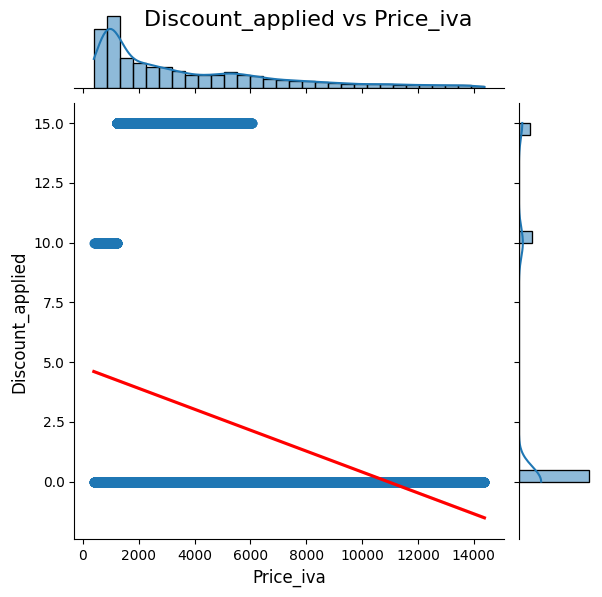

Generando jointplot para price_IVA y price_discount...
Figura guardada como jointplot_price_IVA_vs_price_discount.png


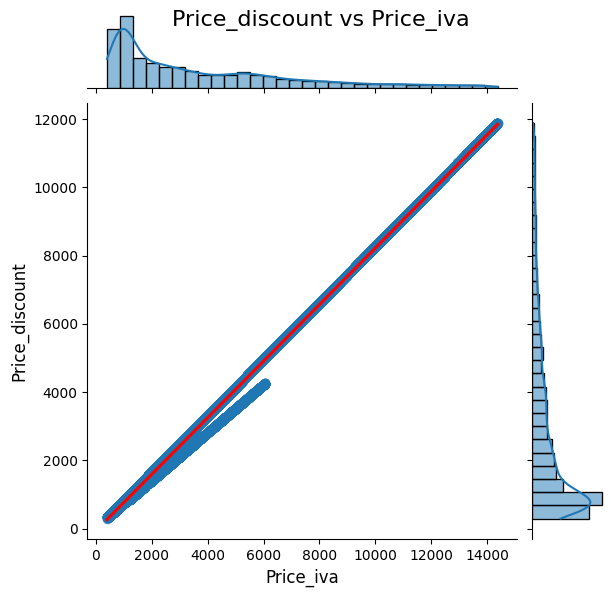

Generando jointplot para price_IVA y volumen...
Figura guardada como jointplot_price_IVA_vs_volumen.png


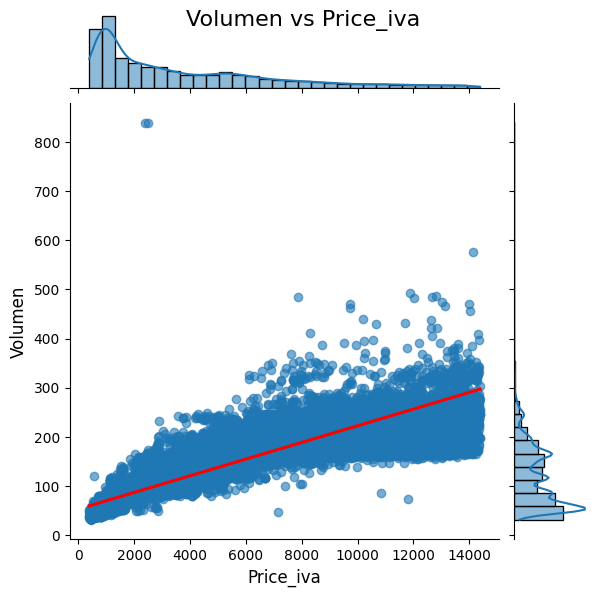

Generando jointplot para price_IVA y price_per_carat...
Figura guardada como jointplot_price_IVA_vs_price_per_carat.png


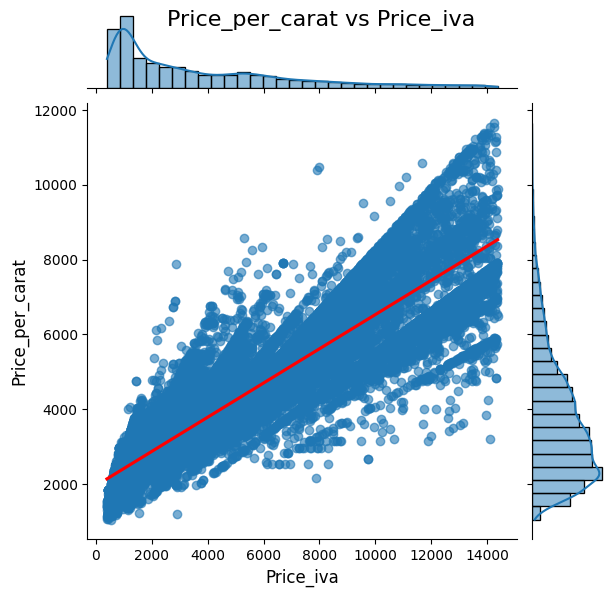

Generando jointplot para price_IVA y price_per_gr...
Figura guardada como jointplot_price_IVA_vs_price_per_gr.png


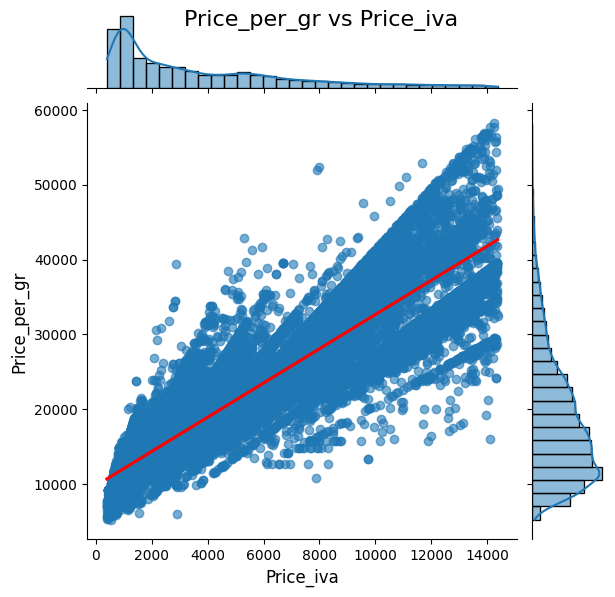

Generando jointplot para price_IVA y price_std...
Figura guardada como jointplot_price_IVA_vs_price_std.png


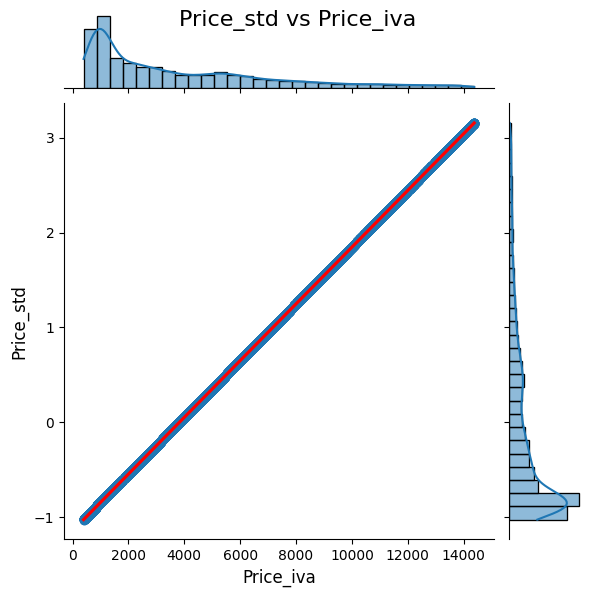

Generando jointplot para discount_applied y price_discount...
Figura guardada como jointplot_discount_applied_vs_price_discount.png


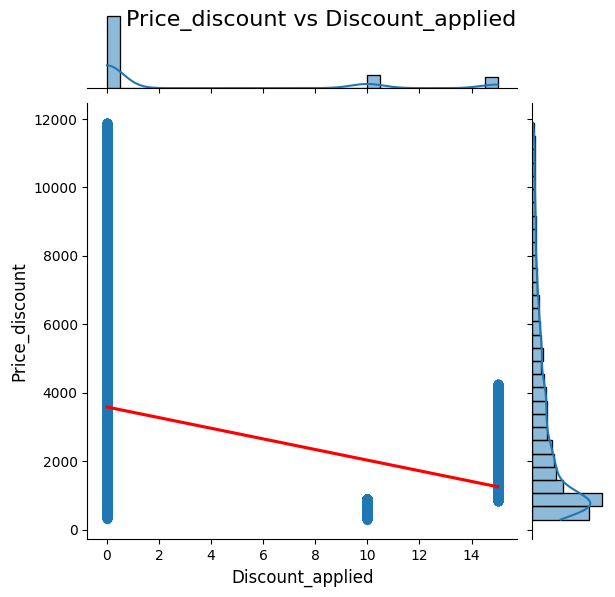

Generando jointplot para discount_applied y volumen...
Figura guardada como jointplot_discount_applied_vs_volumen.png


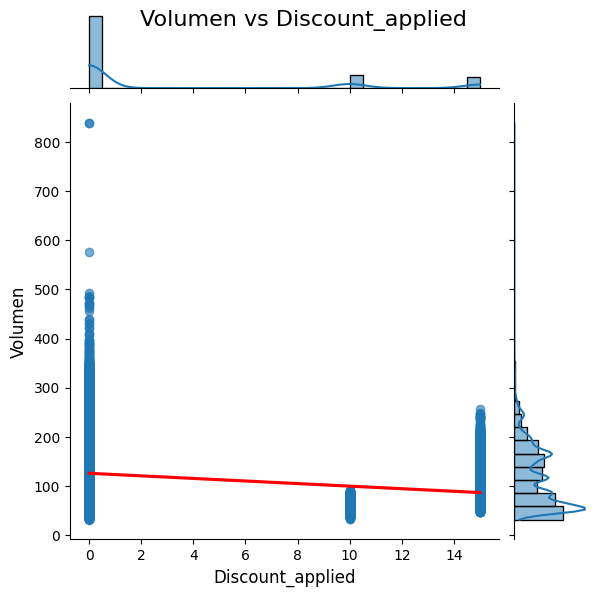

Generando jointplot para discount_applied y price_per_carat...
Figura guardada como jointplot_discount_applied_vs_price_per_carat.png


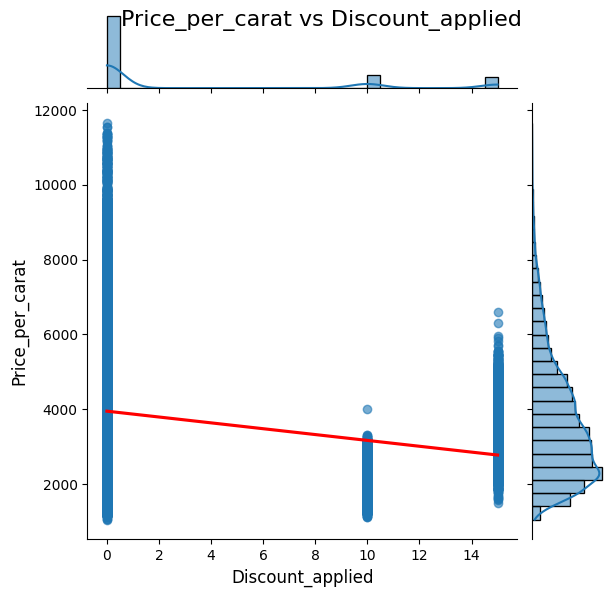

Generando jointplot para discount_applied y price_per_gr...
Figura guardada como jointplot_discount_applied_vs_price_per_gr.png


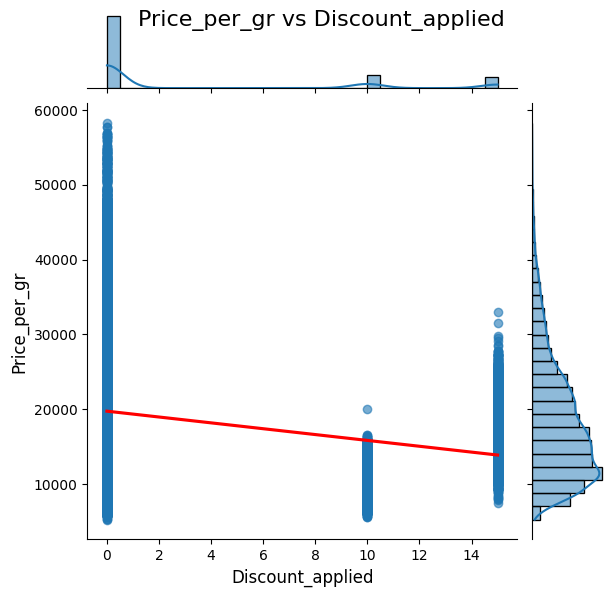

Generando jointplot para discount_applied y price_std...
Figura guardada como jointplot_discount_applied_vs_price_std.png


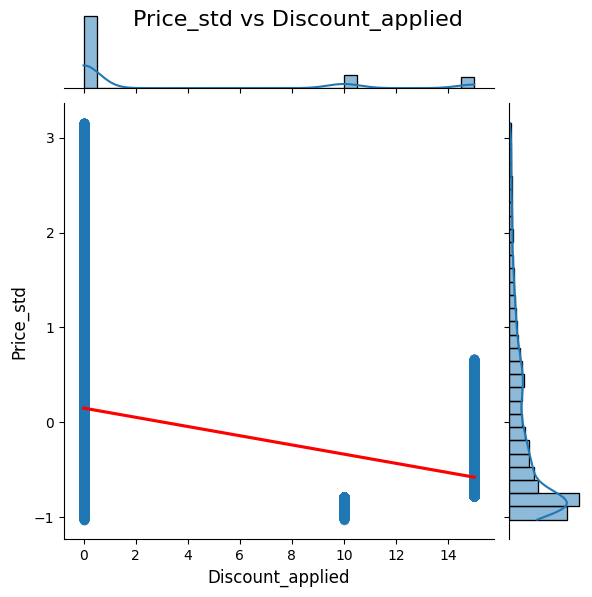

Generando jointplot para price_discount y volumen...
Figura guardada como jointplot_price_discount_vs_volumen.png


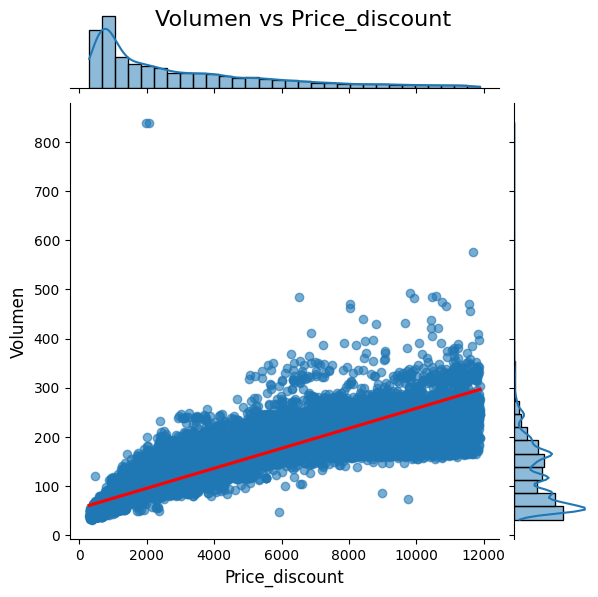

Generando jointplot para price_discount y price_per_carat...
Figura guardada como jointplot_price_discount_vs_price_per_carat.png


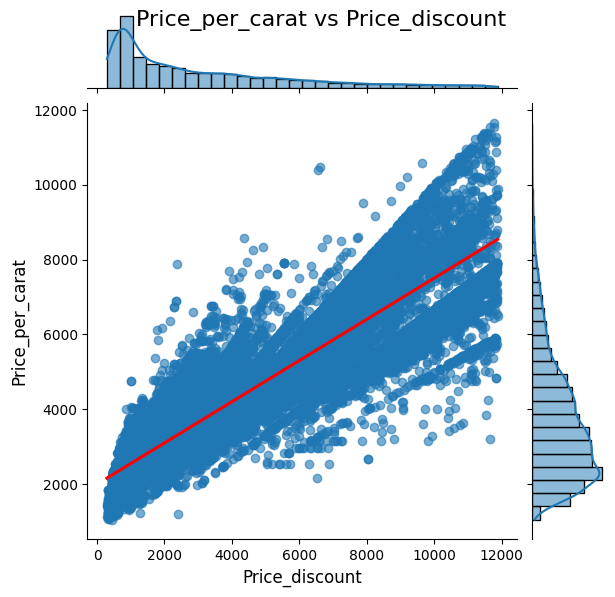

Generando jointplot para price_discount y price_per_gr...
Figura guardada como jointplot_price_discount_vs_price_per_gr.png


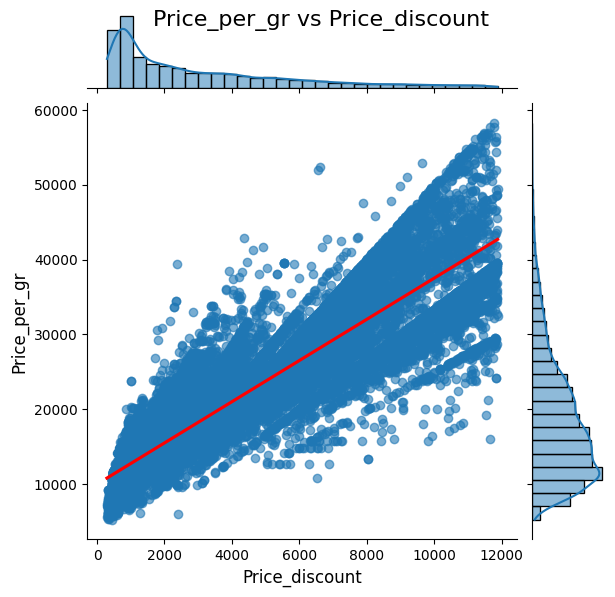

Generando jointplot para price_discount y price_std...
Figura guardada como jointplot_price_discount_vs_price_std.png


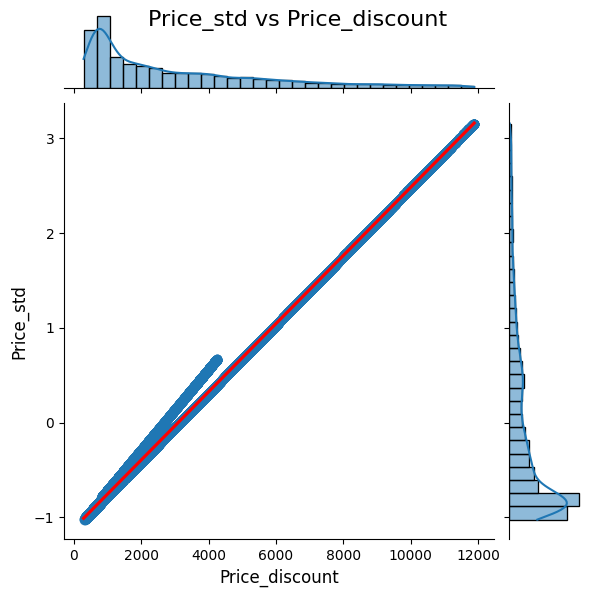

Generando jointplot para volumen y price_per_carat...
Figura guardada como jointplot_volumen_vs_price_per_carat.png


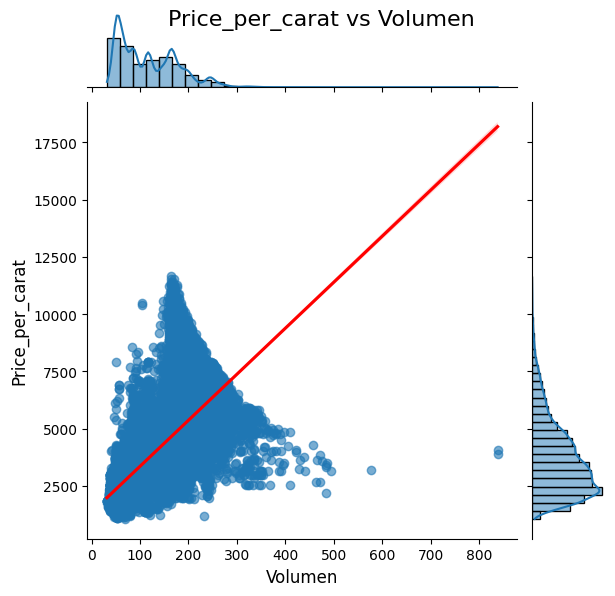

Generando jointplot para volumen y price_per_gr...
Figura guardada como jointplot_volumen_vs_price_per_gr.png


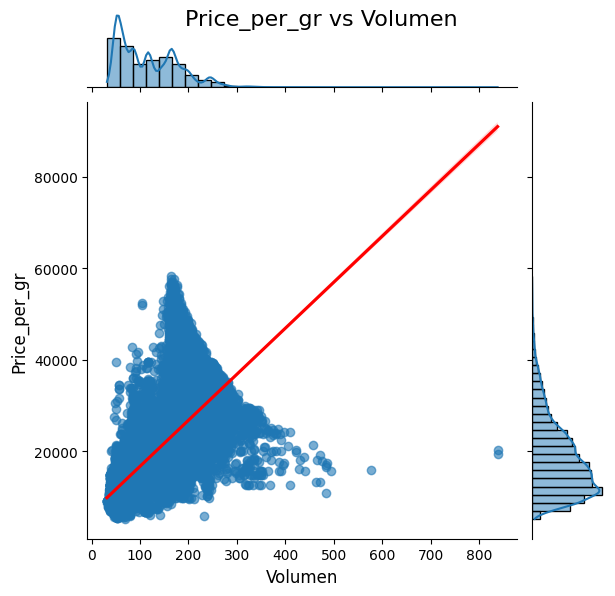

Generando jointplot para volumen y price_std...
Figura guardada como jointplot_volumen_vs_price_std.png


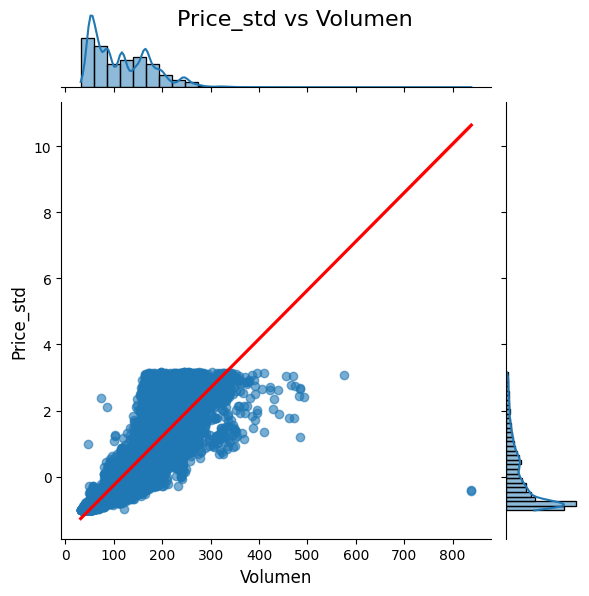

Generando jointplot para price_per_carat y price_per_gr...
Figura guardada como jointplot_price_per_carat_vs_price_per_gr.png


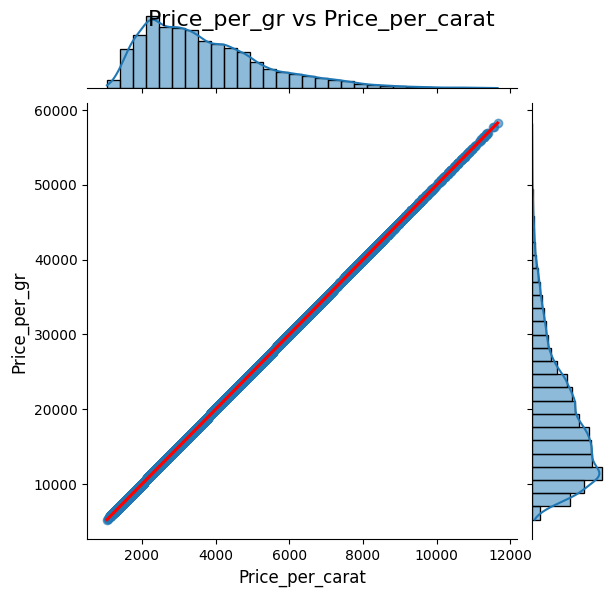

Generando jointplot para price_per_carat y price_std...
Figura guardada como jointplot_price_per_carat_vs_price_std.png


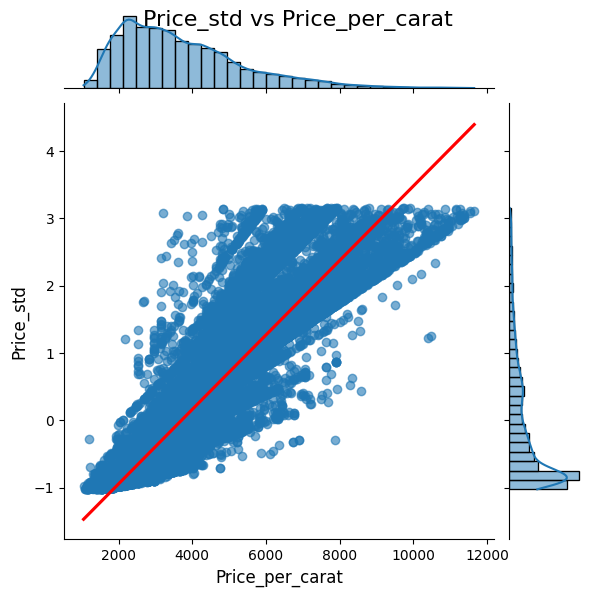

Generando jointplot para price_per_gr y price_std...
Figura guardada como jointplot_price_per_gr_vs_price_std.png


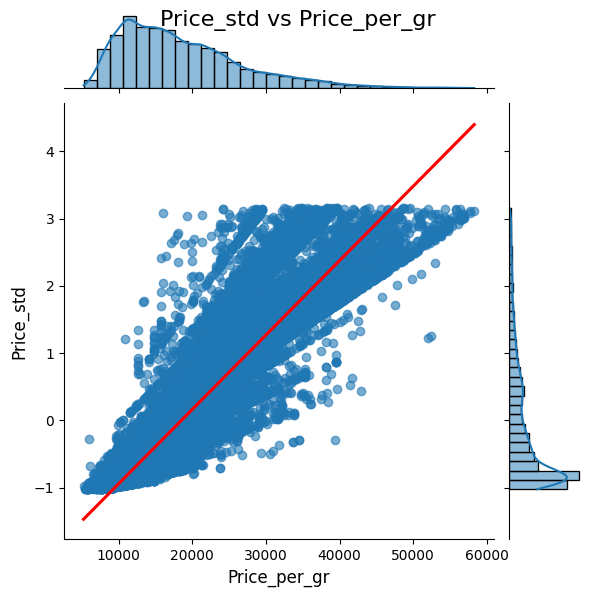

In [177]:
# Seleccionar las columnas numéricas
numerical_columns = df.select_dtypes(include=['float', 'int']).columns
print(f"Columnas numéricas: {numerical_columns}")
print(f"Total de columnas numéricas: {len(numerical_columns)}")

# Generar combinaciones únicas de pares de columnas numéricas
from itertools import combinations
combinations = list(combinations(numerical_columns, 2))
print(f"Total de combinaciones generadas: {len(combinations)}")

# Crear gráficos jointplot para cada combinación
for x_col, y_col in combinations:
    print(f"Generando jointplot para {x_col} y {y_col}...")
    
    # Crear jointplot
    joint = sns.jointplot(
        data=df, 
        x=x_col, 
        y=y_col, 
        kind="reg",  # Tipo de gráfico: regresión
        marginal_kws=dict(bins=30, fill=True),  # Configuración de los histogramas marginales
        scatter_kws=dict(alpha=0.6),  # Configuración del scatterplot
        line_kws=dict(color='red')  # Configuración de la línea de regresión
    )
    
    # Configurar título y etiquetas
    joint.fig.suptitle(f"{y_col.capitalize()} vs {x_col.capitalize()}", fontsize=16)
    joint.set_axis_labels(x_col.capitalize(), y_col.capitalize(), fontsize=12)
    
    # Guardar el gráfico como archivo
    file_name = f"jointplot_{x_col}_vs_{y_col}.png"
    joint.savefig(file_name)
    print(f"Figura guardada como {file_name}")
    
    # Mostrar el gráfico
    plt.show()


In [ ]:
#sns.jointplot(df, x='Attack', y='Defense', hue='Generation')

In [ ]:
'''sns.jointplot(df, x='Attack', y='Defense', kind='hex')

joint = sns.jointplot(data=df, x='Attack', y='Defense', kind='hex', color="blue")
# Acceder al objeto figura del jointplot
joint.ax_joint.legend(["Ataque vs Defensa"], loc="upper left")
plt.show()

'''


In [ ]:
'''sns.jointplot(data=df, x='HP', y='Attack', color='red', cmap='Blues', kind='kde', cbar=True)
sns.jointplot(data=df, x='HP', y='Attack', color='red', cmap='Blues', kind='hist', cbar=True)
sns.boxplot(x=df['Legendary'], y=df['Total'], hue=df['Generation'])
'''

#### 4.1.2.2. Calcular correlación con Pandas y mostrarla con seaborn


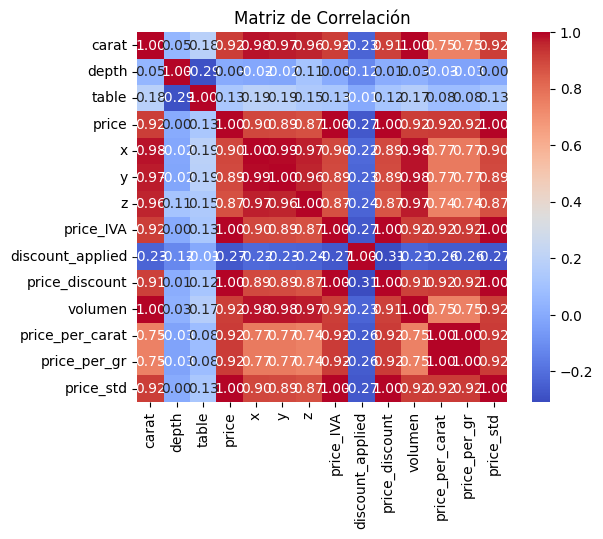

In [108]:
# Matriz de correlación con Pandas y Seaborn
corr_matrix = df.corr(numeric_only=True)  # Calcular la matriz de correlación
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', square=True)
plt.title("Matriz de Correlación")
plt.show()

#### 4.1.2.3. Hacer la correlación en un gráfico de barras para la columna 'price'


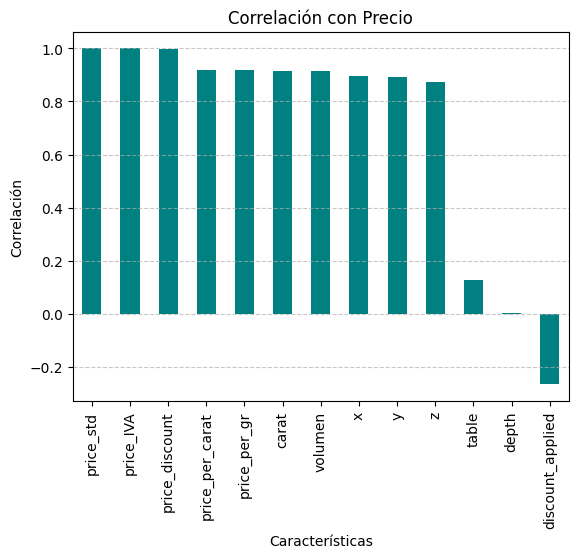

In [109]:
# Gráfico de barras para la correlación con 'price'
corr_with_price = corr_matrix['price'].drop('price')  # Excluir la autocorrelación
corr_with_price.sort_values(ascending=False).plot(kind='bar', color='teal')
plt.title("Correlación con Precio")
plt.xlabel("Características")
plt.ylabel("Correlación")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

# To DO

#### 4.1.2.4. Crear una pivot table usando como index y columns algunas variables categóricas y como values usar el price y visualizarla con heatmap de seaborn


color                D            E            F            G            H  \
cut                                                                          
Fair       3735.909668  3299.875000  3308.228271  3480.811523  4230.523438   
Good       3009.338623  2966.236328  3069.639648  3507.473877  3427.290283   
Ideal      2266.856689  2273.926758  2740.667725  3047.868896  3120.268311   
Premium    3007.079102  2835.611084  3532.768066  3489.368652  4089.981201   
Very Good  2932.160645  2773.168701  3167.900879  3192.582764  3638.770508   

color                I            J  
cut                                  
Fair       3972.823242  3874.102783  
Good       3792.177002  3908.477295  
Ideal      3347.238770  3719.887695  
Premium    4193.798340  4420.701172  
Very Good  3876.276367  4064.013184  


C:\Users\carol\AppData\Local\Temp\ipykernel_48944\3864831245.py:2: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  df_pivot = df.pivot_table(index='cut', columns='color', values='price', aggfunc='mean')


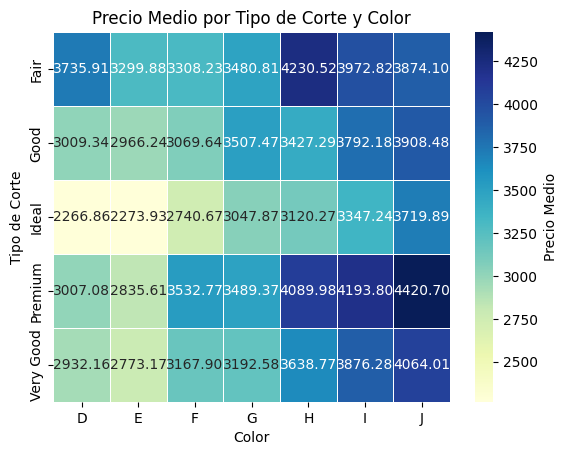

In [173]:
# Pivot table con Heatmap
df_pivot = df.pivot_table(index='cut', columns='color', values='price', aggfunc='mean')
print(df_pivot)
sns.heatmap(df_pivot, annot=True, fmt=".2f", cmap="YlGnBu", cbar_kws={'label': 'Precio Medio'}, linecolor='white', linewidths=0.5)
plt.title("Precio Medio por Tipo de Corte y Color")
plt.xlabel("Color")
plt.ylabel("Tipo de Corte")
plt.show()

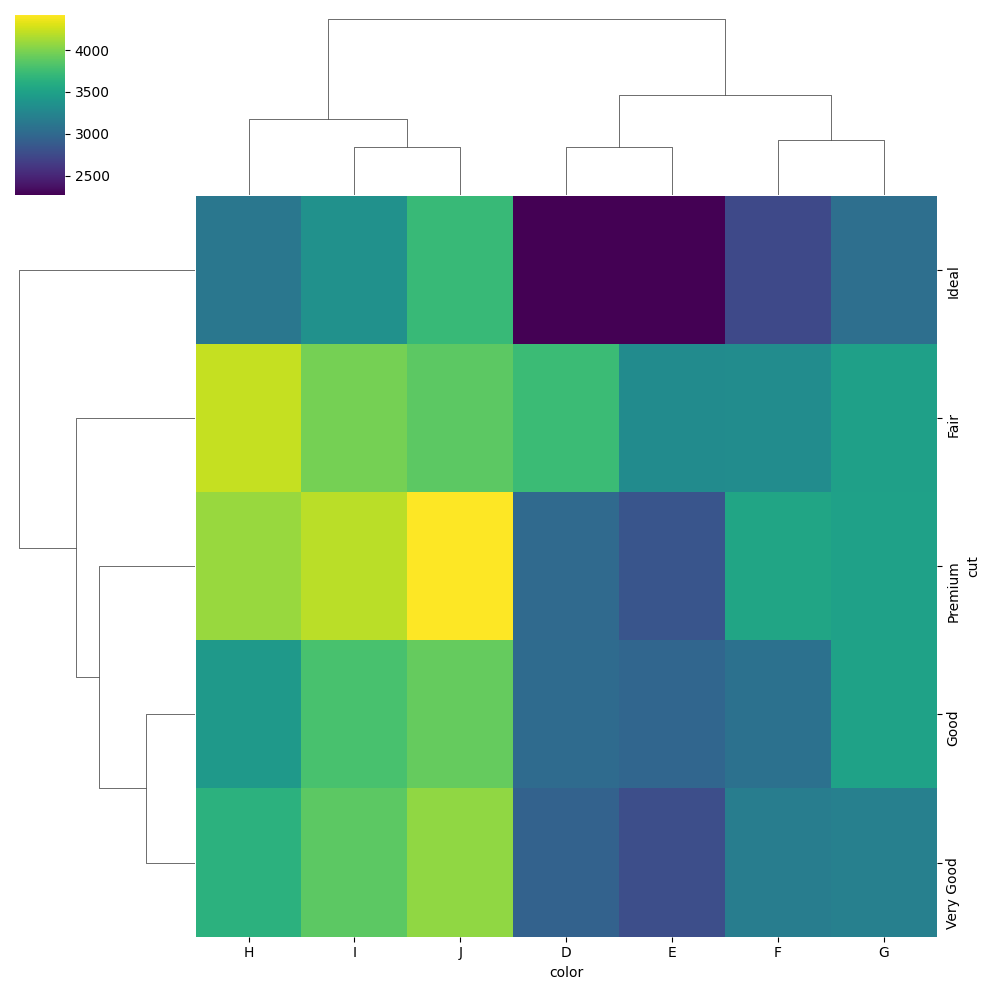

In [ ]:
# hacemos un clustermap wque agrupe los parecidos
sns.clustermap(df_pivot, cmap='viridis')

In [ ]:
# hacemos doble filtro
df_corr = df[['Total', 'HP', 'Attack', 'Defense', 'Sp. Atk', 'Sp. Def', 'Speed', 'Generation', 'Legendary']].corr()
sns.heatmap(df_corr, annot=True, cmap='viridis', cbar=True) #annot=True hace que ponga los números


In [ ]:
# Vemos que la columna generation no aporta correlación con nada, se podría eliminar
df_corr = df[['Total', 'HP', 'Attack', 'Defense', 'Sp. Atk', 'Sp. Def', 'Speed', 'Legendary']].corr()
sns.heatmap(df_corr, annot=True, cmap='viridis', cbar=True)



In [ ]:
# Opción 1
# encoding de la columna Type 1 y usarlas para calcular la correlación
df_numericals = df[['Total', 'HP', 'Attack', 'Defense', 'Sp. Atk', 'Sp. Def', 'Speed', 'Legendary']].corr()

# encoding
type_dummies = pd.get_dummies(df['Type 1'], prefix='type_1')

#juntar todo en un solo dataframe:
df_concat = pd.concat([df_numericals, type_dummies], axis=1)

#calcular correlación
df_corr = df_concat.corr()
sns.heatmap(df_corr, annot=True, fmt='.1f', cmap='viridis')



In [ ]:
plt.figure(figsize=(20,20))
# Opciçón 2:

#df.drop y borrar todas menos las que interesen
df_base = df.drop(['#', 'Name', 'Type 2'], axis=1)

# encoding
df_encoded = pd.get_dummies(df_base)

#correlación
df_corr = df_encoded.corr()
sns.heatmap(df_corr, annot=True, fmt='.1f', cmap='viridis')

In [ ]:
data.loc[:, ['HP', 'Attack', 'Defense', 'Speed']].corr()
# esta es extra para comprobar si el resultado de la correlacion es correcto

In [ ]:
sns.heatmap(data[['HP', 'Attack', 'Defense', 'Speed']].corr(), annot=True, cmap='viridis')

### 4.1.3. Combinarlas con:


#### 4.1.3.1. hue, style, size, row, col usando un relplot


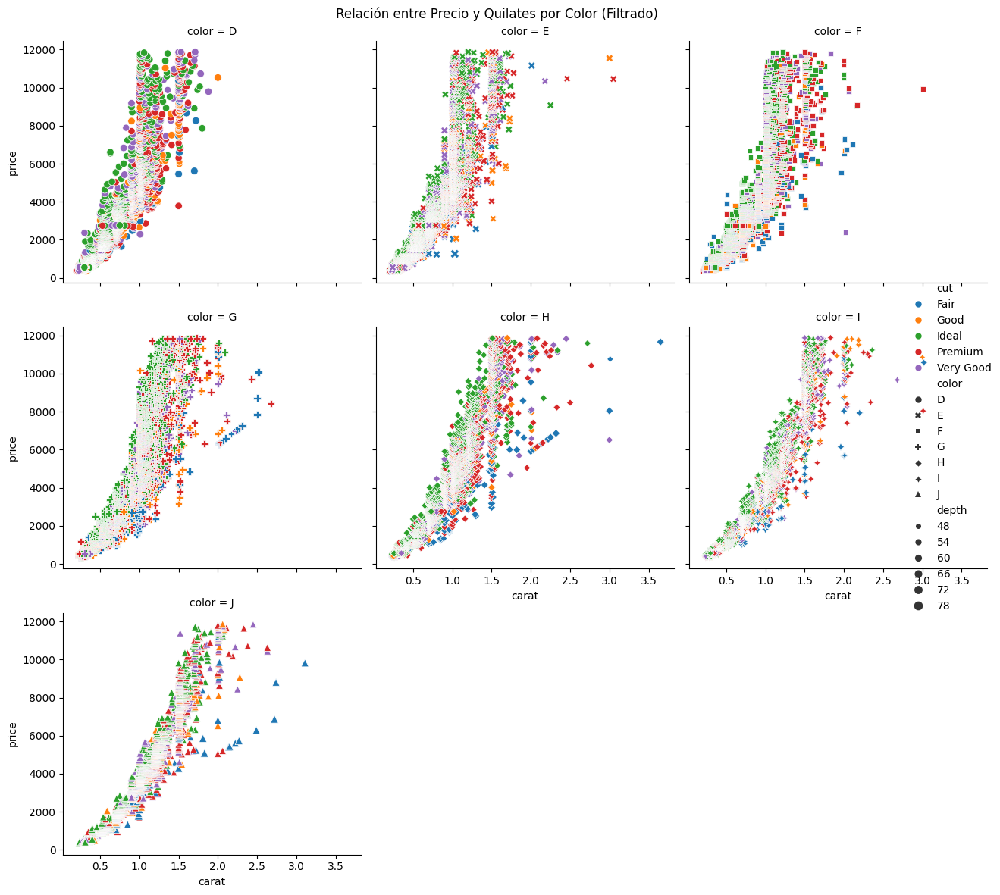

In [111]:
# Relplot con hue, style, size, row y col
g = sns.relplot(
    data=df.query('price < 20000'),  # Filtro: precios menores de 20000
    x='carat', y='price', hue='cut', style='color', size='depth',
    col='color', col_wrap=3, kind='scatter', height=4, aspect=1
)
g.fig.suptitle("Relación entre Precio y Quilates por Color (Filtrado)")
plt.tight_layout()
plt.show()

In [ ]:
help(sns.FacetGrid)

In [ ]:
g = sns.FacetGrid(df, col= 'Legendary')
g.map(sns.kdeplot, 'Attack')

In [ ]:
g = sns.FacetGrid(df, col= 'Legendary', row='Generation')
g.map(sns.kdeplot, 'Attack')

In [ ]:
df_tips = sns.load_dataset('tips')

help(sns.relplot)

In [ ]:
sns.relplot(df_tips, x='total_bill', y='tip', hue='smoker', col='time', row='sex')

In [ ]:
sns.relplot(df_tips, x='total_bill', y='tip', hue='smoker', col='time', size='size')

#### 4.1.3.2. filtro


In [ ]:
filtro = df['Type 1'] == 'Fire'
sns.histplot(x=df[filtro]['HP'], bins=20, kde=True)

In [ ]:
#filtro = df['Type 1'] == 'Water' & df['Fire']
filtro = df['Type 1'].isin(['Water', 'Fire'])

sns.jointplot(df[filtro], x='Attack', y='Defense', kind='hex')